### Dependences

In [1]:
import sys
sys.path.append("../")

import numpy as np
import tensorflow as tf

from PIL import Image
from tqdm import tqdm

import matplotlib.pyplot as plt
from IPython.display import clear_output

from lib.models.FPN_RFB_TDM import FPN_RFB_TDM
import lib.utils as utils


### Loading experiment data

In [2]:
#set experiment ID
EXP_ID = "FPN_RFB_TDM_temp"
utils.create_experiment_folders(EXP_ID)
utils.load_experiment_data()


### Model instantiation

In [3]:
model = FPN_RFB_TDM()
model.build((None,224,224,1))
print(model.summary())


Model: "fpn_rfb_tdm"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
max_pooling2d (MaxPooling2D) multiple                  0         
_________________________________________________________________
up_sampling2d (UpSampling2D) multiple                  0         
_________________________________________________________________
sequential (Sequential)      multiple                  448       
_________________________________________________________________
sequential_1 (Sequential)    multiple                  18752     
_________________________________________________________________
sequential_2 (Sequential)    multiple                  74368     
_________________________________________________________________
sequential_3 (Sequential)    multiple                  296192    
_________________________________________________________________
sequential_4 (Sequential)    multiple                  

### Loading Dataset

In [4]:
dct_scale = 256

#Loading the training dataset
train_x_seismic, train_y_seismic, _, _ = utils.load_dataset(
    "../../dataset/croped/gen", DCTScale=dct_scale, replace_vec=["gen","train"], limit=None)

#add border with size 24. 200x200 -> 224x224
train_x_seismic = utils.add_margin_zeros(train_x_seismic, size=24)
train_y_seismic = utils.add_margin_zeros(train_y_seismic, size=24)

qtd_traning = train_x_seismic.shape[0]
print("Loaded",qtd_traning, "samples")


1794it [01:49, 16.40it/s]


Loaded 1794 samples


In [5]:
#Loading the training dataset
valid_x_seismic_1, valid_y_seismic_1,  = utils.load_dataset_from_file("../extra/valid1.txt")
valid_x_seismic_2, valid_y_seismic_2,  = utils.load_dataset_from_file("../extra/valid2.txt")
valid_x_seismic_3, valid_y_seismic_3,  = utils.load_dataset_from_file("../extra/valid3.txt")

#add border with size 24. 200x200 -> 224x224
valid_x_seismic_1 = utils.add_margin_zeros(valid_x_seismic_1, size=24)
valid_y_seismic_1 = utils.add_margin_zeros(valid_y_seismic_1, size=24)
valid_x_seismic_2 = utils.add_margin_zeros(valid_x_seismic_2, size=24)
valid_y_seismic_2 = utils.add_margin_zeros(valid_y_seismic_2, size=24)
valid_x_seismic_3 = utils.add_margin_zeros(valid_x_seismic_3, size=24)
valid_y_seismic_3 = utils.add_margin_zeros(valid_y_seismic_3, size=24)

qtd_traning = valid_x_seismic_1.shape[0]
print("Valid. Set 1 loaded",qtd_traning, "samples")

qtd_traning = valid_x_seismic_2.shape[0]
print("Valid. Set 2 loaded",qtd_traning, "samples")

qtd_traning = valid_x_seismic_3.shape[0]
print("Valid. Set 3 loaded",qtd_traning, "samples")


100%|██████████████████████████████████████████████████████████████████████████████| 2718/2718 [00:50<00:00, 53.47it/s]


Valid. Set 1 loaded 1056 samples
Valid. Set 2 loaded 1182 samples
Valid. Set 3 loaded 2718 samples


### Dataset Normalization and Batches split

train_batches: 225 valid_batches: 132
Preview examples from train set
batch 0


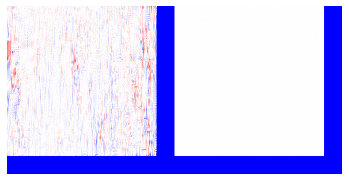

batch 1


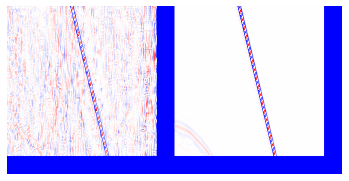

batch 2


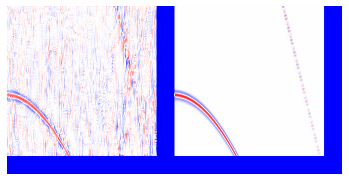

batch 3


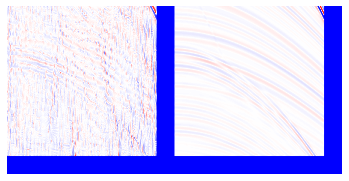

batch 4


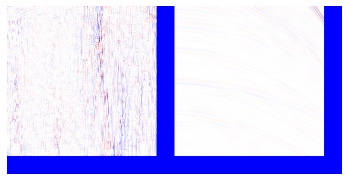

Preview examples from valid set 1
batch 0


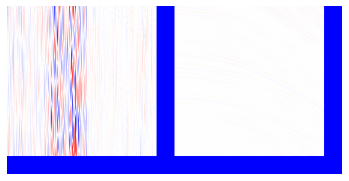

batch 1


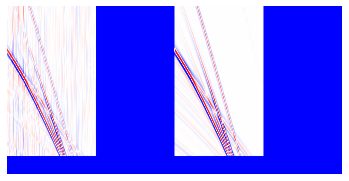

batch 2


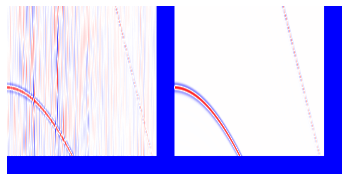

batch 3


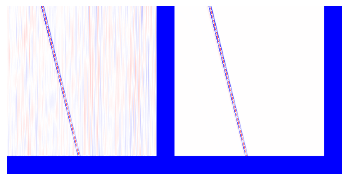

batch 4


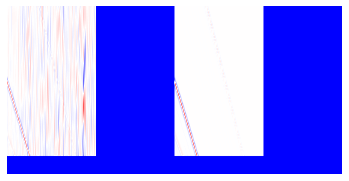

Preview examples from valid set 2
batch 0


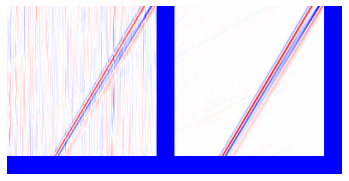

batch 1


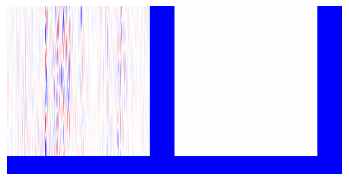

batch 2


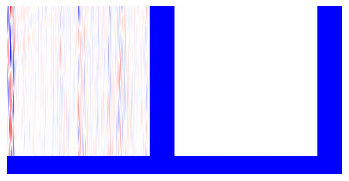

batch 3


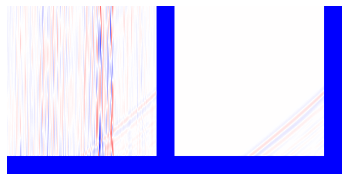

batch 4


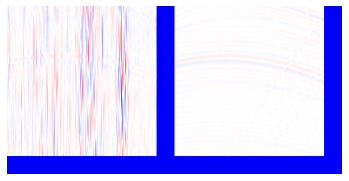

Preview examples from valid set 3
batch 0


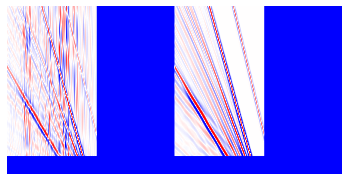

batch 1


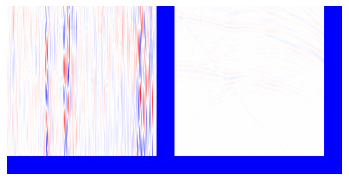

batch 2


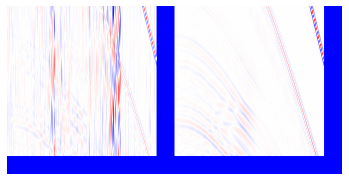

batch 3


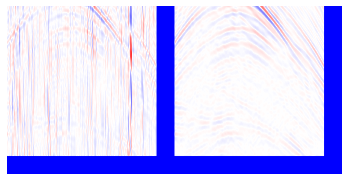

batch 4


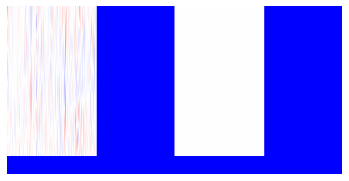

In [6]:
train_batches = utils.random_mini_batches(train_x_seismic, train_y_seismic, None, None, 8, seed=0)
valid_batches_1 = utils.random_mini_batches(valid_x_seismic_1, valid_y_seismic_1, None, None, 8, seed=0)
valid_batches_2 = utils.random_mini_batches(valid_x_seismic_2, valid_y_seismic_2, None, None, 8, seed=0)
valid_batches_3 = utils.random_mini_batches(valid_x_seismic_3, valid_y_seismic_3, None, None, 8, seed=0)

print("train_batches:", len(train_batches), "valid_batches:", len(valid_batches_1))


print("Preview examples from train set")
for index,batch in enumerate(train_batches):
    if index > 4:
        break
    (seismic_x, seismic_y, _, _) = batch
    print("batch", index)
    plt.imshow( np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0])) , cmap="bwr", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    
print("Preview examples from valid set 1")
for index, batch in enumerate(valid_batches_1):
    if index > 4:
        break
    (seismic_x, seismic_y, _, _) = batch
    print("batch", index)
    (seismic_x, seismic_y, dct_x, dct_y) = batch
    plt.imshow( np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0])) , cmap="bwr", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    
print("Preview examples from valid set 2")
for index, batch in enumerate(valid_batches_2):
    if index > 4:
        break
    (seismic_x, seismic_y, _, _) = batch
    print("batch", index)
    (seismic_x, seismic_y, dct_x, dct_y) = batch
    plt.imshow( np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0])) , cmap="bwr", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    
print("Preview examples from valid set 3")
for index, batch in enumerate(valid_batches_3):
    if index > 4:
        break
    (seismic_x, seismic_y, _, _) = batch
    print("batch", index)
    (seismic_x, seismic_y, dct_x, dct_y) = batch
    plt.imshow( np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0])) , cmap="bwr", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    

### Metrics

In [7]:
#default tf.keras metrics
train_loss = tf.keras.metrics.Mean(name='train_loss')



### Set Loss and load model weights

In [8]:
loss_object = tf.keras.losses.MeanSquaredError()
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

#get last saved epoch index and best result in validation step
CURRENT_EPOCH, BEST_VALIDATION_1 = utils.get_model_last_data()
BEST_VALIDATION_2 = 0
BEST_VALIDATION_3 = 0

if CURRENT_EPOCH > 0:
    print("Loading last model state in epoch", CURRENT_EPOCH)
    model.load_weights(utils.get_exp_folder_last_epoch())
    print("Best validation result was PSNR=", BEST_VALIDATION_1)

Loading last model state in epoch 81
Best validation result was PSNR= 34.26225869782804


### Training

In [9]:
@tf.function
def train_step(patch_x, patch_y):
    with tf.GradientTape() as tape:
        predictions = model(patch_x)
        loss = loss_object(patch_y, predictions)
        
    gradients = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))
    train_loss(loss)

def valid_step(valid_batches):
    valid_mse = tf.keras.metrics.MeanSquaredError(name='train_mse')
    valid_custom_metrics = utils.CustomMetric()
    for index, batch in enumerate(valid_batches):
        (seismic_x, seismic_y, _, _) = batch
        predictions = model(seismic_x)
        valid_mse(seismic_y, predictions)

        predictions_seismic = predictions.numpy()

        seismic_x = utils.remove_margin_zeros(seismic_x.copy(), size=24)
        seismic_y = utils.remove_margin_zeros(seismic_y.copy(), size=24)
        predictions_seismic = utils.remove_margin_zeros(predictions_seismic, size=24)

        #feed the metric evaluator
        valid_custom_metrics.feed(seismic_y, predictions_seismic)

        #just show the first example of each batch until 5
        if index < 3:
            print("Spatial domain: X - Y - PREDICT")
            plt.imshow(np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0], predictions_seismic[0,:,:,0])) , cmap="bwr", vmin=0, vmax=1)
            plt.axis('off')
            plt.pause(0.1)
    
    #get metric results
    psnr, nrmse = valid_custom_metrics.result()
    valid_mse_result = valid_mse.result().numpy()
    valid_custom_metrics.reset_states()
    valid_mse.reset_states()
    return psnr, nrmse, valid_mse_result
    
MAX_EPOCHS = 81
EVAL_STEP = 1

for epoch in range(CURRENT_EPOCH, MAX_EPOCHS):
    
    #TRAINING
    print("TRAINING EPOCH", epoch)
   
    for batch in train_batches:
        (seismic_x, seismic_y, _, _) = batch
        train_step(seismic_x, seismic_y)
        
    
    #VALIDATION
    if epoch%EVAL_STEP == 0:
        #tf.keras.backend.set_learning_phase(0)
        clear_output()
        
        print("VALIDATION EPOCH", epoch)
        #saving last epoch model
        model.save_weights(utils.get_exp_folder_last_epoch(), save_format='tf')
       
        #valid with set 1    
        psnr_1, nrmse_1, mse_1 = valid_step(valid_batches_1)
        psnr_2, nrmse_2, mse_2 = valid_step(valid_batches_2)
        psnr_3, nrmse_3, mse_3 = valid_step(valid_batches_3)
        
        utils.update_chart_data(epoch=epoch, train_mse=train_loss.result().numpy(), 
                                valid_mse=[mse_1,mse_2,mse_3], psnr=[psnr_1,psnr_2,psnr_3], nrmse=[nrmse_1,nrmse_2,nrmse_3])
        utils.draw_chart()
        
        #saving best validation model
        if psnr_1 > BEST_VALIDATION_1:
            BEST_VALIDATION_1 = psnr_1
            model.save_weights(utils.get_exp_folder_best_valid()+"_set1", save_format='tf')
            
        #saving best validation model
        if psnr_2 > BEST_VALIDATION_2:
            BEST_VALIDATION_2 = psnr_2
            model.save_weights(utils.get_exp_folder_best_valid()+"_set2", save_format='tf')

        #saving best validation model
        if psnr_3 > BEST_VALIDATION_3:
            BEST_VALIDATION_3 = psnr_3
            model.save_weights(utils.get_exp_folder_best_valid()+"_set3", save_format='tf')
        
    train_loss.reset_states()



If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

Spatial domain: X - Y - PREDICT


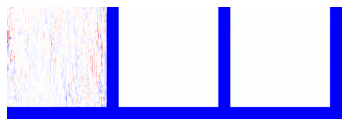

Spatial domain: X - Y - PREDICT


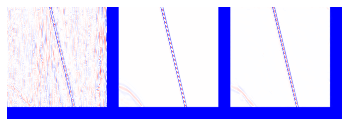

Spatial domain: X - Y - PREDICT


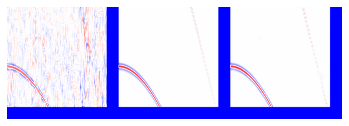

Spatial domain: X - Y - PREDICT


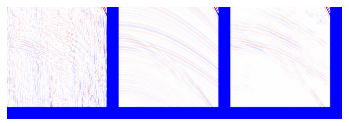

Spatial domain: X - Y - PREDICT


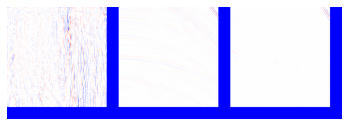

Spatial domain: X - Y - PREDICT


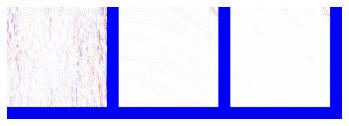

Spatial domain: X - Y - PREDICT


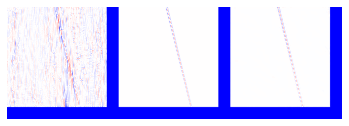

Spatial domain: X - Y - PREDICT


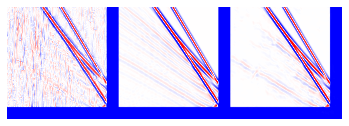

Spatial domain: X - Y - PREDICT


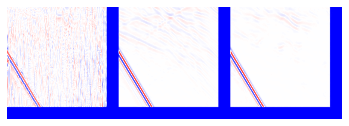

Spatial domain: X - Y - PREDICT


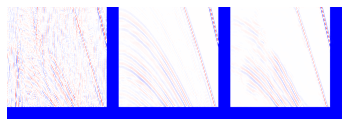

Spatial domain: X - Y - PREDICT


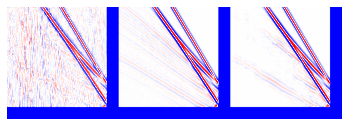

Spatial domain: X - Y - PREDICT


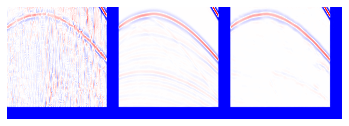

Spatial domain: X - Y - PREDICT


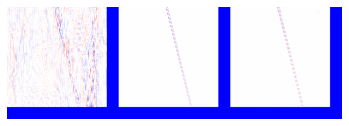

Spatial domain: X - Y - PREDICT


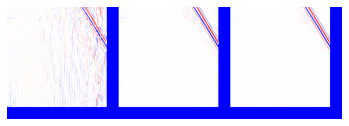

Spatial domain: X - Y - PREDICT


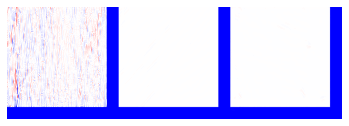

Spatial domain: X - Y - PREDICT


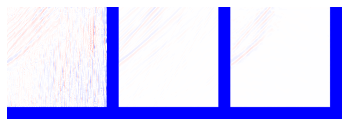

Spatial domain: X - Y - PREDICT


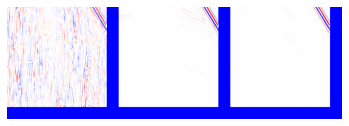

Spatial domain: X - Y - PREDICT


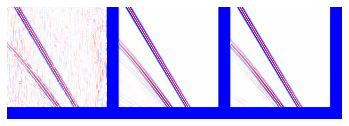

Spatial domain: X - Y - PREDICT


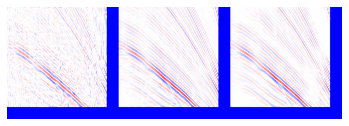

Spatial domain: X - Y - PREDICT


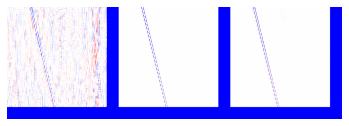

Spatial domain: X - Y - PREDICT


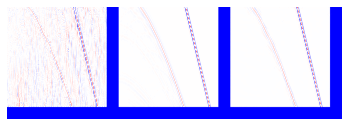

Spatial domain: X - Y - PREDICT


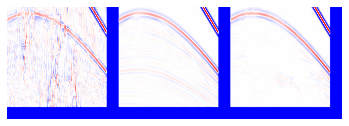

Spatial domain: X - Y - PREDICT


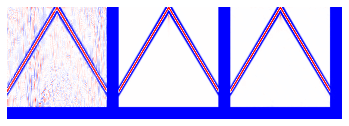

Spatial domain: X - Y - PREDICT


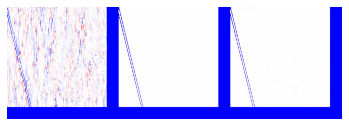

Spatial domain: X - Y - PREDICT


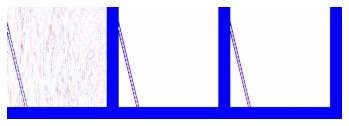

Spatial domain: X - Y - PREDICT


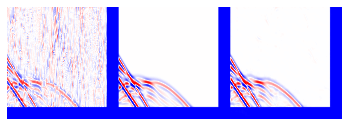

Spatial domain: X - Y - PREDICT


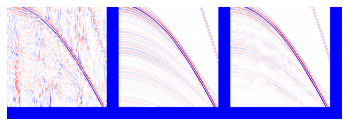

Spatial domain: X - Y - PREDICT


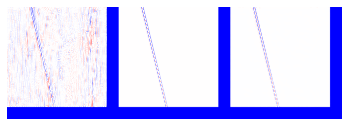

Spatial domain: X - Y - PREDICT


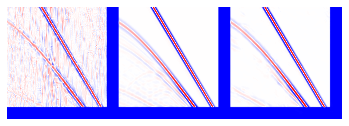

Spatial domain: X - Y - PREDICT


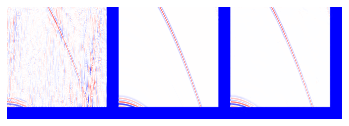

Spatial domain: X - Y - PREDICT


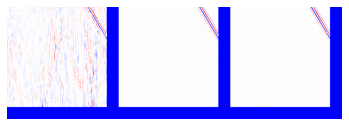

Spatial domain: X - Y - PREDICT


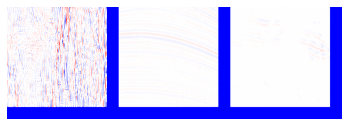

Spatial domain: X - Y - PREDICT


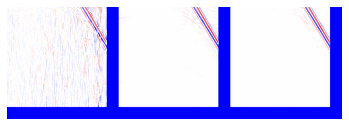

Spatial domain: X - Y - PREDICT


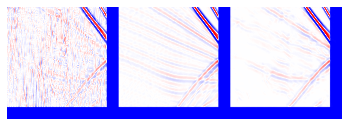

Spatial domain: X - Y - PREDICT


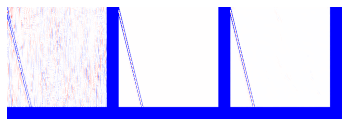

Spatial domain: X - Y - PREDICT


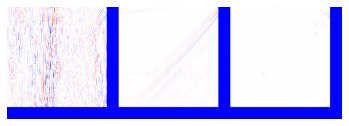

Spatial domain: X - Y - PREDICT


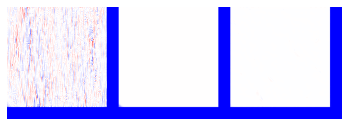

Spatial domain: X - Y - PREDICT


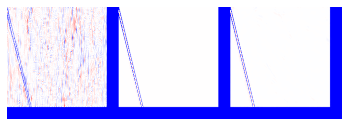

Spatial domain: X - Y - PREDICT


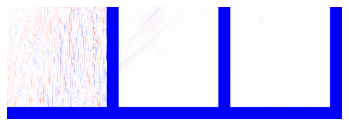

Spatial domain: X - Y - PREDICT


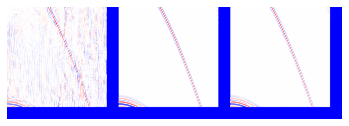

Spatial domain: X - Y - PREDICT


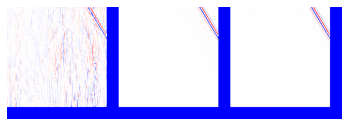

Spatial domain: X - Y - PREDICT


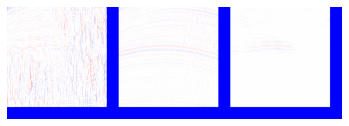

Spatial domain: X - Y - PREDICT


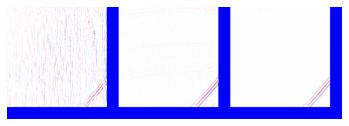

Spatial domain: X - Y - PREDICT


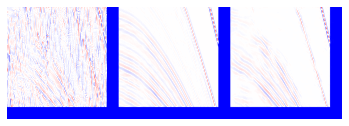

Spatial domain: X - Y - PREDICT


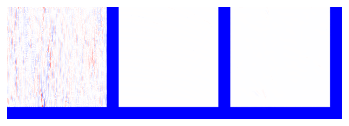

Spatial domain: X - Y - PREDICT


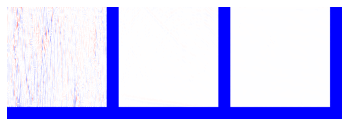

Spatial domain: X - Y - PREDICT


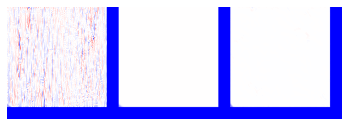

Spatial domain: X - Y - PREDICT


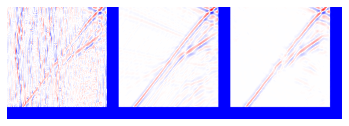

Spatial domain: X - Y - PREDICT


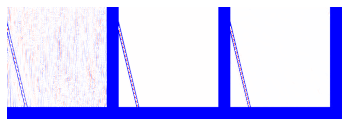

Spatial domain: X - Y - PREDICT


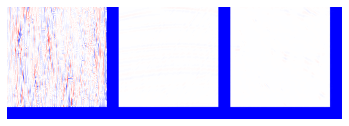

Spatial domain: X - Y - PREDICT


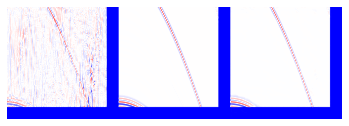

Spatial domain: X - Y - PREDICT


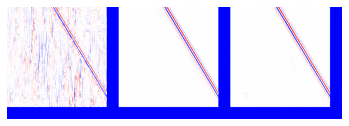

Spatial domain: X - Y - PREDICT


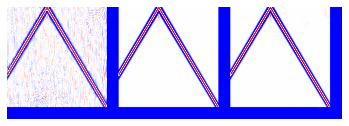

Spatial domain: X - Y - PREDICT


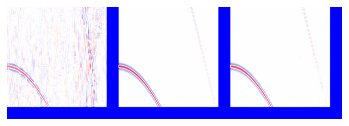

Spatial domain: X - Y - PREDICT


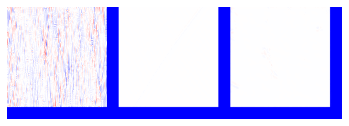

Spatial domain: X - Y - PREDICT


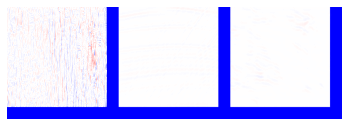

Spatial domain: X - Y - PREDICT


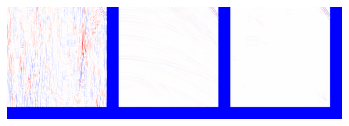

Spatial domain: X - Y - PREDICT


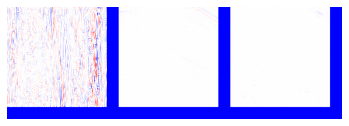

Spatial domain: X - Y - PREDICT


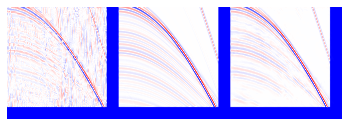

Spatial domain: X - Y - PREDICT


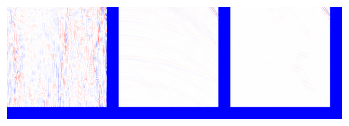

Spatial domain: X - Y - PREDICT


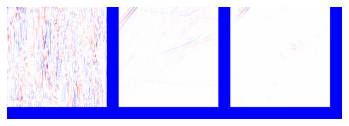

Spatial domain: X - Y - PREDICT


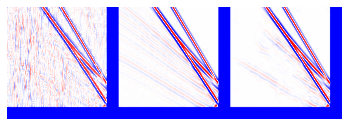

Spatial domain: X - Y - PREDICT


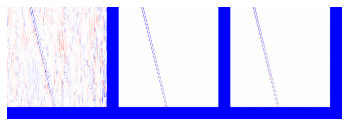

Spatial domain: X - Y - PREDICT


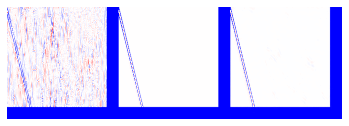

Spatial domain: X - Y - PREDICT


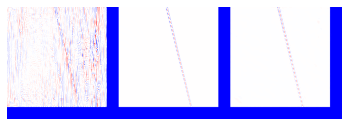

Spatial domain: X - Y - PREDICT


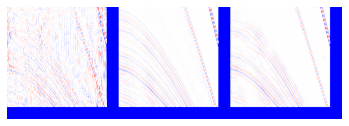

Spatial domain: X - Y - PREDICT


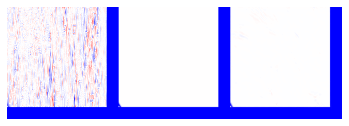

Spatial domain: X - Y - PREDICT


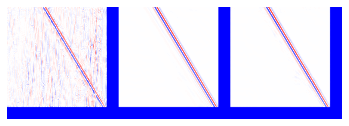

Spatial domain: X - Y - PREDICT


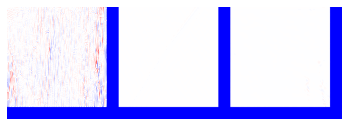

Spatial domain: X - Y - PREDICT


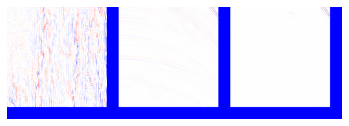

Spatial domain: X - Y - PREDICT


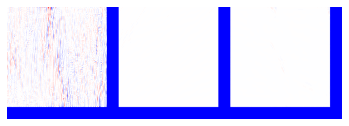

Spatial domain: X - Y - PREDICT


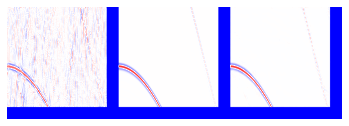

Spatial domain: X - Y - PREDICT


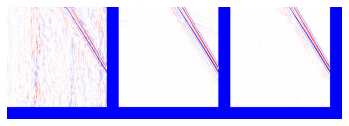

Spatial domain: X - Y - PREDICT


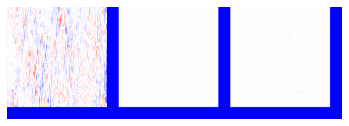

Spatial domain: X - Y - PREDICT


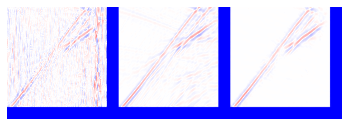

Spatial domain: X - Y - PREDICT


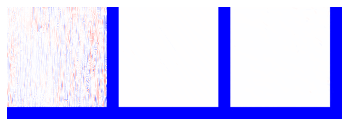

Spatial domain: X - Y - PREDICT


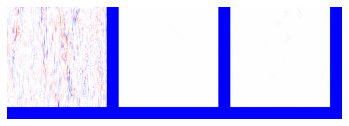

Spatial domain: X - Y - PREDICT


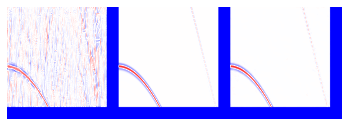

Spatial domain: X - Y - PREDICT


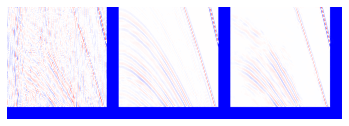

Spatial domain: X - Y - PREDICT


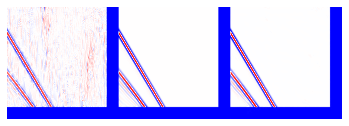

Spatial domain: X - Y - PREDICT


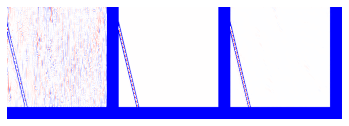

Spatial domain: X - Y - PREDICT


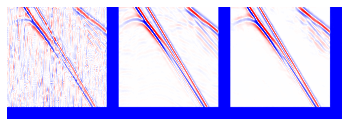

Spatial domain: X - Y - PREDICT


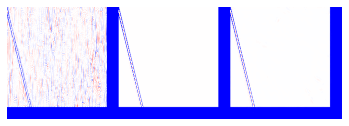

Spatial domain: X - Y - PREDICT


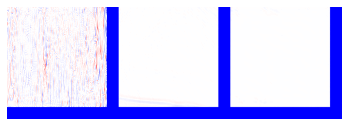

Spatial domain: X - Y - PREDICT


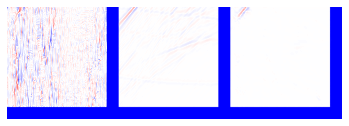

Spatial domain: X - Y - PREDICT


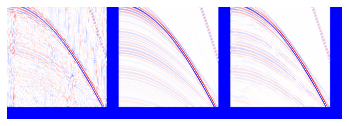

Spatial domain: X - Y - PREDICT


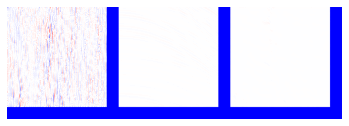

Spatial domain: X - Y - PREDICT


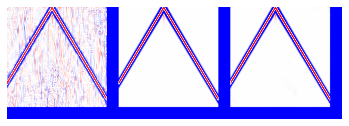

Spatial domain: X - Y - PREDICT


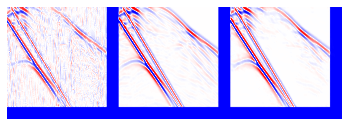

Spatial domain: X - Y - PREDICT


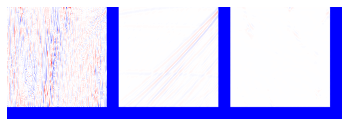

Spatial domain: X - Y - PREDICT


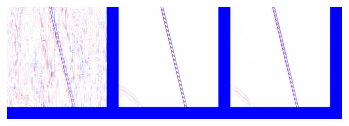

Spatial domain: X - Y - PREDICT


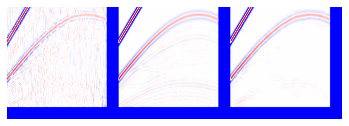

Spatial domain: X - Y - PREDICT


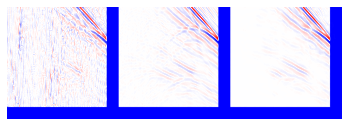

Spatial domain: X - Y - PREDICT


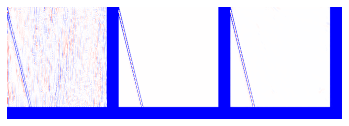

Spatial domain: X - Y - PREDICT


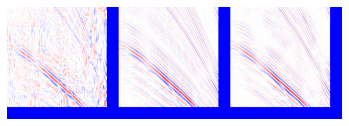

Spatial domain: X - Y - PREDICT


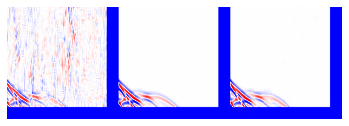

Spatial domain: X - Y - PREDICT


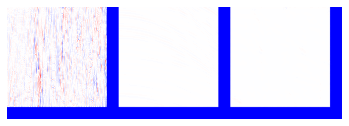

Spatial domain: X - Y - PREDICT


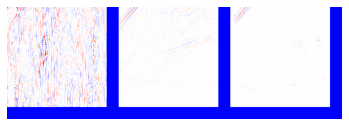

Spatial domain: X - Y - PREDICT


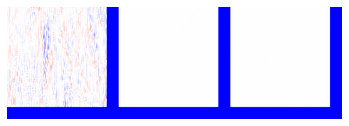

Spatial domain: X - Y - PREDICT


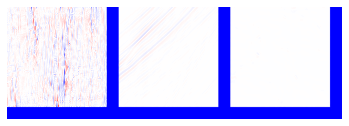

Spatial domain: X - Y - PREDICT


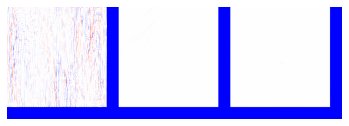

Spatial domain: X - Y - PREDICT


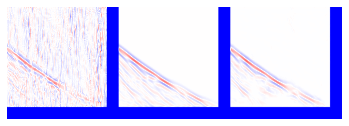

Spatial domain: X - Y - PREDICT


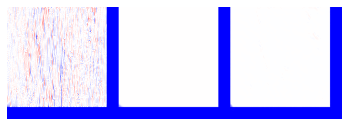

Spatial domain: X - Y - PREDICT


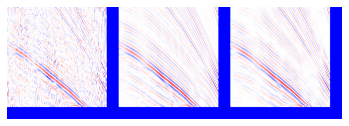

Spatial domain: X - Y - PREDICT


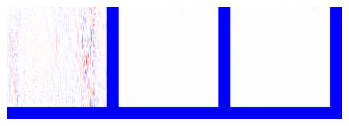

Spatial domain: X - Y - PREDICT


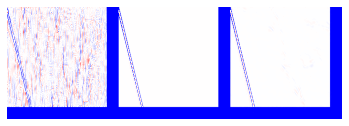

Spatial domain: X - Y - PREDICT


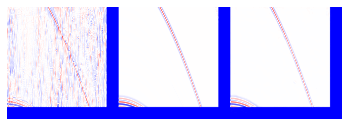

Spatial domain: X - Y - PREDICT


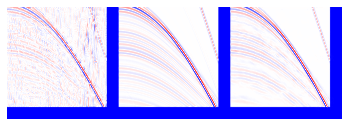

Spatial domain: X - Y - PREDICT


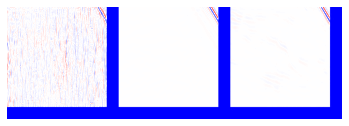

Spatial domain: X - Y - PREDICT


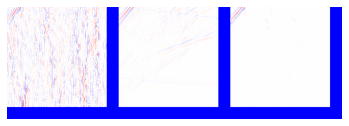

Spatial domain: X - Y - PREDICT


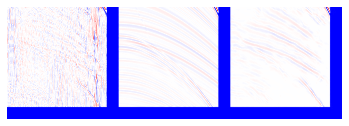

Spatial domain: X - Y - PREDICT


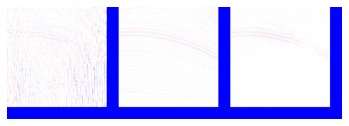

Spatial domain: X - Y - PREDICT


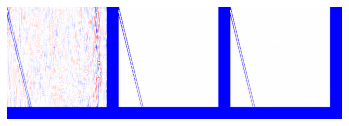

Spatial domain: X - Y - PREDICT


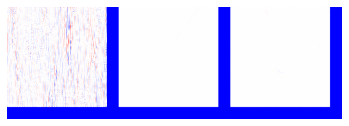

Spatial domain: X - Y - PREDICT


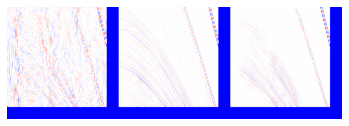

Spatial domain: X - Y - PREDICT


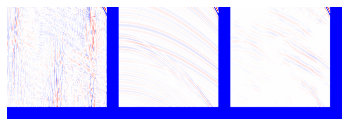

Spatial domain: X - Y - PREDICT


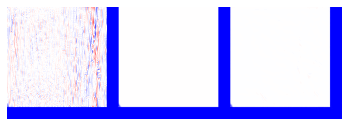

Spatial domain: X - Y - PREDICT


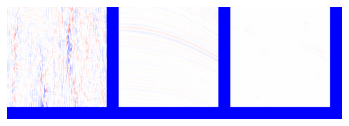

Spatial domain: X - Y - PREDICT


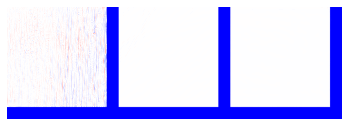

Spatial domain: X - Y - PREDICT


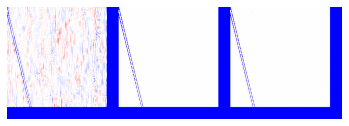

Spatial domain: X - Y - PREDICT


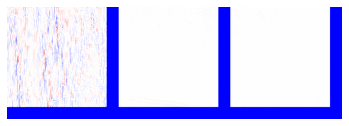

Spatial domain: X - Y - PREDICT


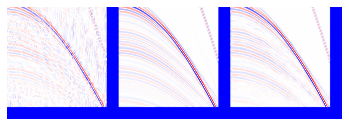

Spatial domain: X - Y - PREDICT


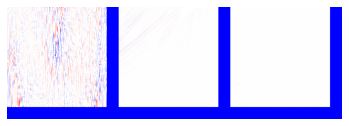

Spatial domain: X - Y - PREDICT


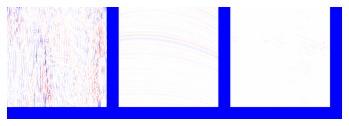

Spatial domain: X - Y - PREDICT


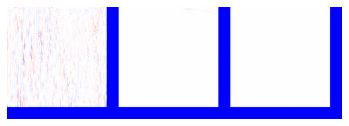

Spatial domain: X - Y - PREDICT


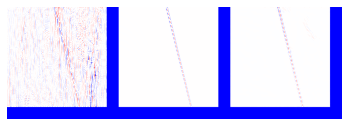

Spatial domain: X - Y - PREDICT


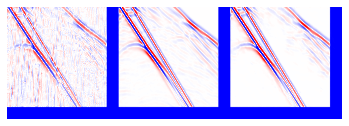

Spatial domain: X - Y - PREDICT


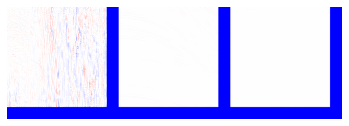

Spatial domain: X - Y - PREDICT


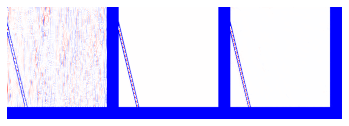

Spatial domain: X - Y - PREDICT


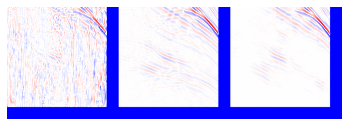

Spatial domain: X - Y - PREDICT


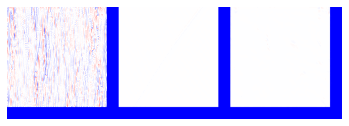

Spatial domain: X - Y - PREDICT


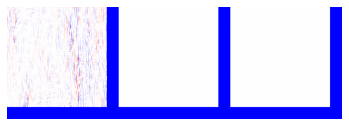

Spatial domain: X - Y - PREDICT


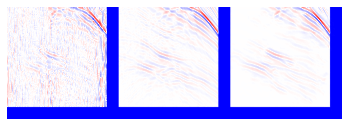

Spatial domain: X - Y - PREDICT


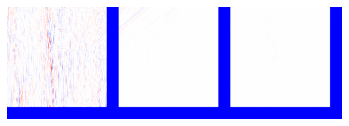

Spatial domain: X - Y - PREDICT


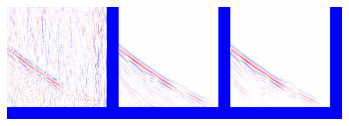

Spatial domain: X - Y - PREDICT


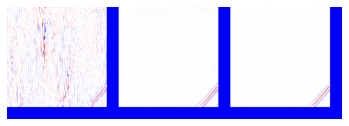

Spatial domain: X - Y - PREDICT


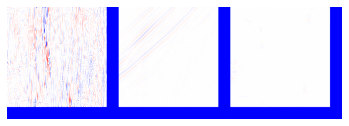

Spatial domain: X - Y - PREDICT


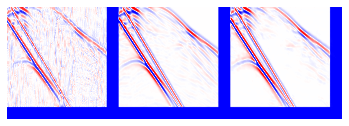

Spatial domain: X - Y - PREDICT


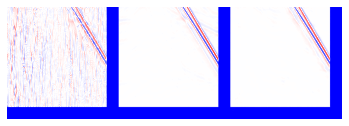

Spatial domain: X - Y - PREDICT


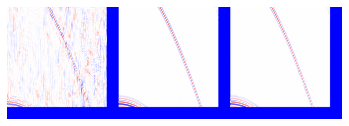

Spatial domain: X - Y - PREDICT


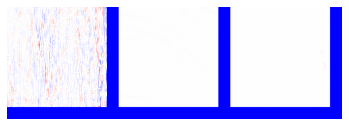

Spatial domain: X - Y - PREDICT


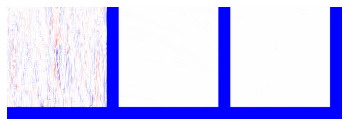

Spatial domain: X - Y - PREDICT


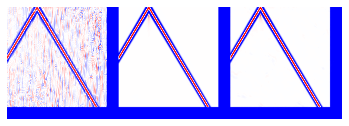

Spatial domain: X - Y - PREDICT


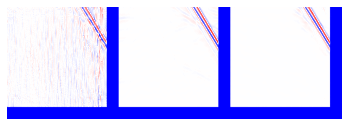

Spatial domain: X - Y - PREDICT


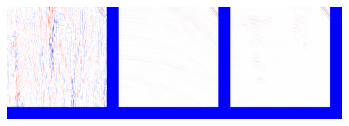

Spatial domain: X - Y - PREDICT


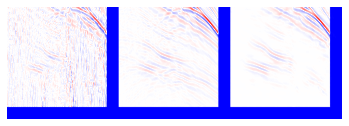

Spatial domain: X - Y - PREDICT


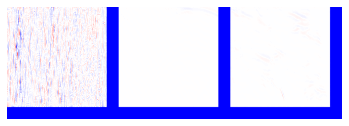

Spatial domain: X - Y - PREDICT


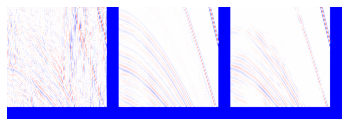

Spatial domain: X - Y - PREDICT


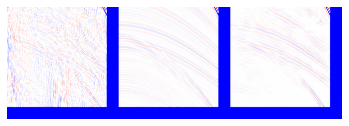

Spatial domain: X - Y - PREDICT


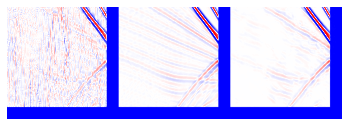

Spatial domain: X - Y - PREDICT


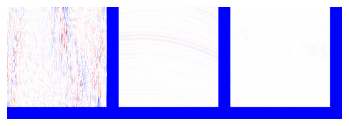

Spatial domain: X - Y - PREDICT


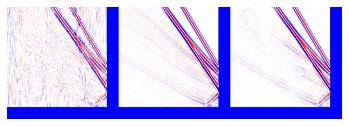

Spatial domain: X - Y - PREDICT


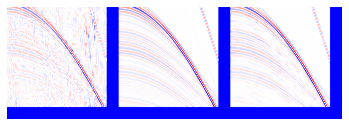

Spatial domain: X - Y - PREDICT


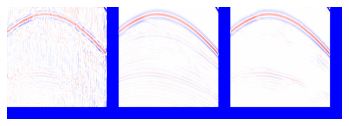

Spatial domain: X - Y - PREDICT


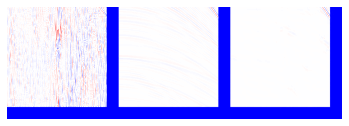

Spatial domain: X - Y - PREDICT


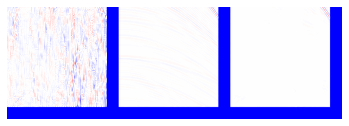

Spatial domain: X - Y - PREDICT


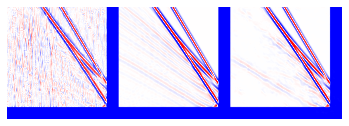

Spatial domain: X - Y - PREDICT


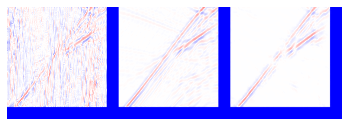

Spatial domain: X - Y - PREDICT


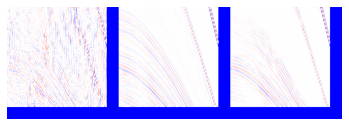

Spatial domain: X - Y - PREDICT


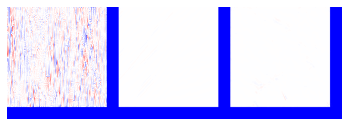

Spatial domain: X - Y - PREDICT


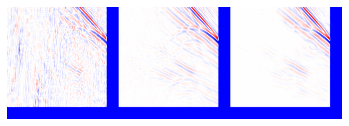

Spatial domain: X - Y - PREDICT


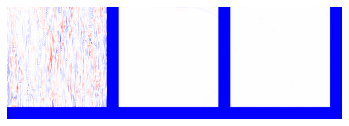

Spatial domain: X - Y - PREDICT


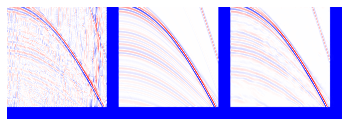

Spatial domain: X - Y - PREDICT


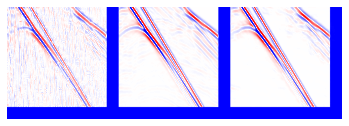

Spatial domain: X - Y - PREDICT


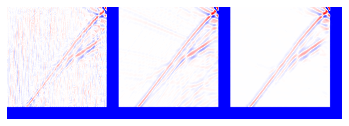

Spatial domain: X - Y - PREDICT


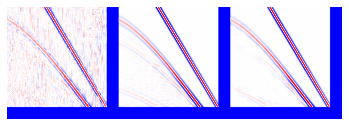

Spatial domain: X - Y - PREDICT


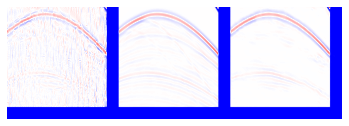

Spatial domain: X - Y - PREDICT


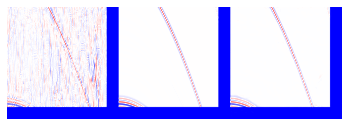

Spatial domain: X - Y - PREDICT


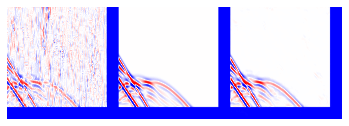

Spatial domain: X - Y - PREDICT


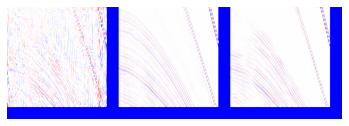

Spatial domain: X - Y - PREDICT


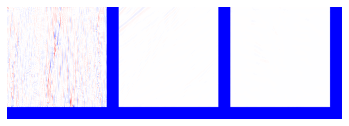

Spatial domain: X - Y - PREDICT


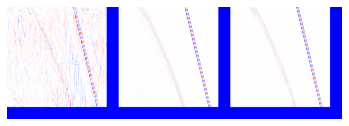

Spatial domain: X - Y - PREDICT


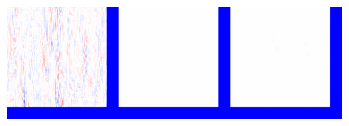

Spatial domain: X - Y - PREDICT


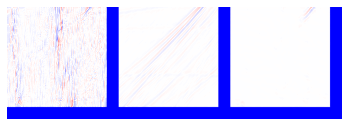

Spatial domain: X - Y - PREDICT


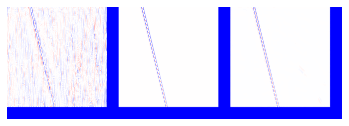

Spatial domain: X - Y - PREDICT


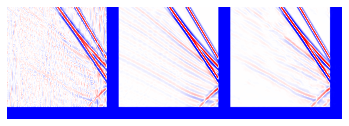

Spatial domain: X - Y - PREDICT


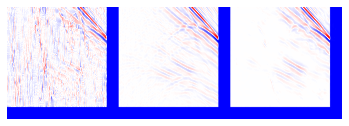

Spatial domain: X - Y - PREDICT


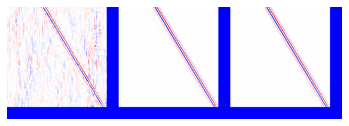

Spatial domain: X - Y - PREDICT


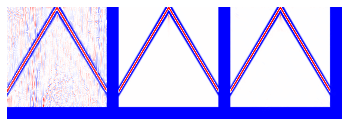

Spatial domain: X - Y - PREDICT


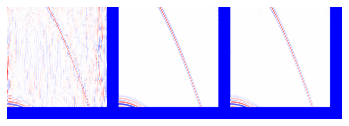

Spatial domain: X - Y - PREDICT


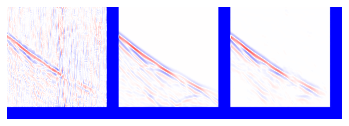

Spatial domain: X - Y - PREDICT


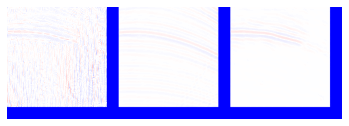

Spatial domain: X - Y - PREDICT


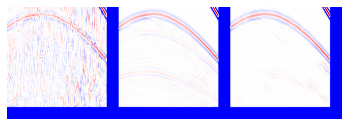

Spatial domain: X - Y - PREDICT


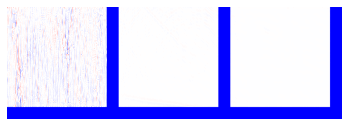

Spatial domain: X - Y - PREDICT


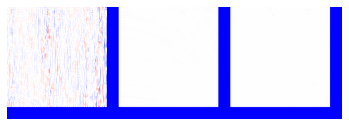

Spatial domain: X - Y - PREDICT


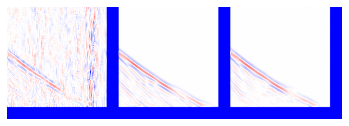

Spatial domain: X - Y - PREDICT


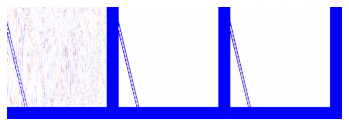

Spatial domain: X - Y - PREDICT


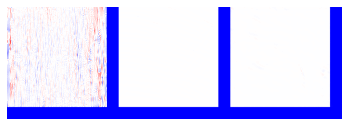

Spatial domain: X - Y - PREDICT


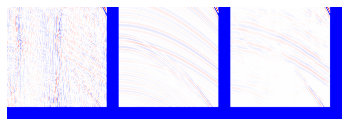

Spatial domain: X - Y - PREDICT


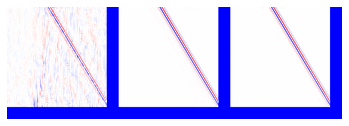

Spatial domain: X - Y - PREDICT


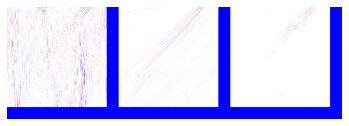

Spatial domain: X - Y - PREDICT


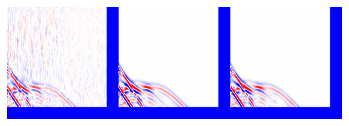

Spatial domain: X - Y - PREDICT


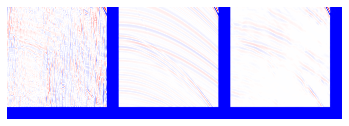

Spatial domain: X - Y - PREDICT


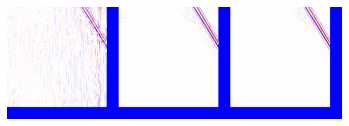

Spatial domain: X - Y - PREDICT


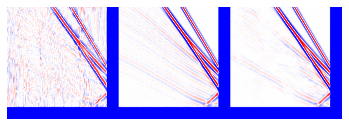

Spatial domain: X - Y - PREDICT


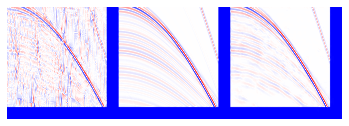

Spatial domain: X - Y - PREDICT


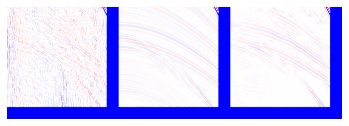

Spatial domain: X - Y - PREDICT


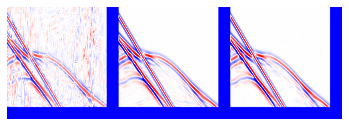

Spatial domain: X - Y - PREDICT


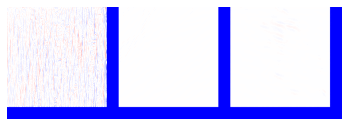

Spatial domain: X - Y - PREDICT


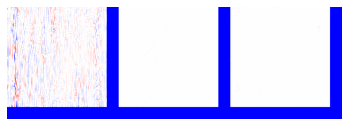

Spatial domain: X - Y - PREDICT


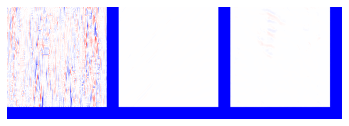

Spatial domain: X - Y - PREDICT


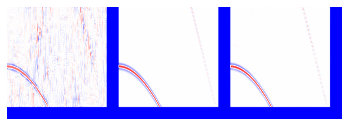

Spatial domain: X - Y - PREDICT


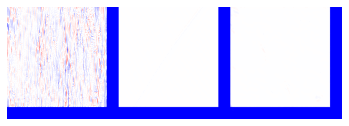

Spatial domain: X - Y - PREDICT


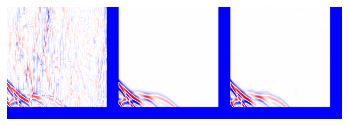

Spatial domain: X - Y - PREDICT


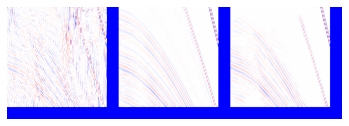

Spatial domain: X - Y - PREDICT


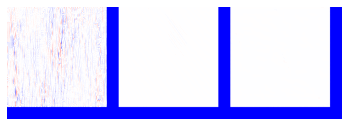

Spatial domain: X - Y - PREDICT


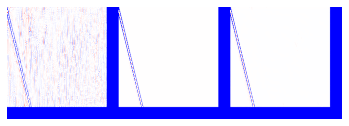

Spatial domain: X - Y - PREDICT


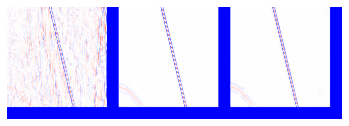

Spatial domain: X - Y - PREDICT


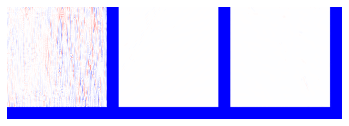

Spatial domain: X - Y - PREDICT


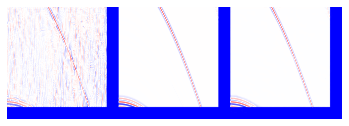

Spatial domain: X - Y - PREDICT


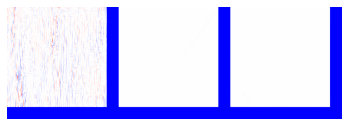

Spatial domain: X - Y - PREDICT


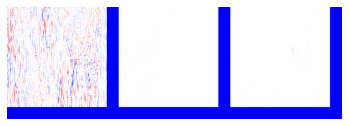

Spatial domain: X - Y - PREDICT


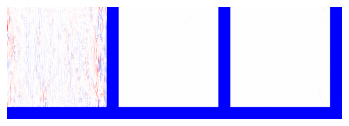

Spatial domain: X - Y - PREDICT


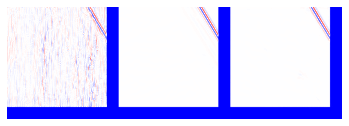

Spatial domain: X - Y - PREDICT


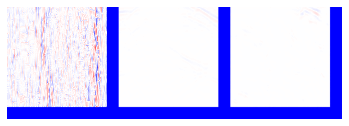

Spatial domain: X - Y - PREDICT


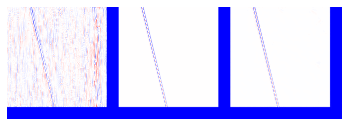

Spatial domain: X - Y - PREDICT


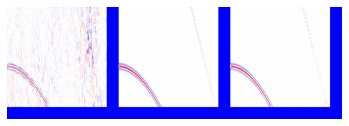

Spatial domain: X - Y - PREDICT


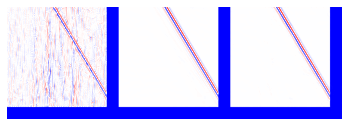

Spatial domain: X - Y - PREDICT


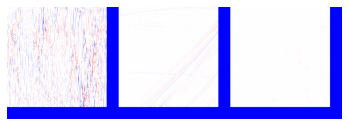

Spatial domain: X - Y - PREDICT


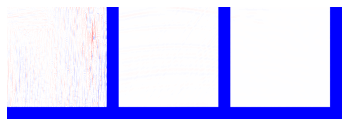

Spatial domain: X - Y - PREDICT


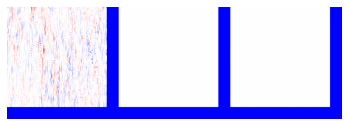

Spatial domain: X - Y - PREDICT


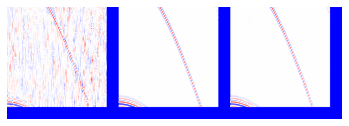

Spatial domain: X - Y - PREDICT


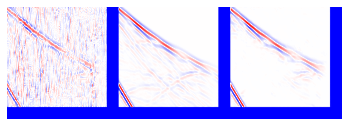

Spatial domain: X - Y - PREDICT


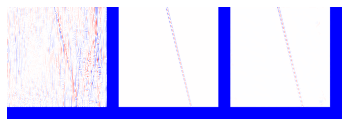

Spatial domain: X - Y - PREDICT


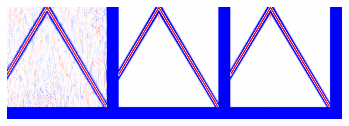

In [10]:
#view train folder
model.load_weights(utils.get_exp_folder_best_valid()+"_set3")

for index, batch in enumerate(train_batches):
    (seismic_x, seismic_y, dct_x, dct_y) = batch
    predictions = model(seismic_x)         
    predictions_seismic = predictions.numpy()
             
    print("Spatial domain: X - Y - PREDICT")
    plt.imshow(np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0], predictions_seismic[0,:,:,0])) , cmap="bwr", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    

In [11]:
print(utils.get_experiment_results())

{'Best_Valid': 34.26225869782804, 'Best_Epoch': 73, 'PSNR_1': 34.26225869782804, 'PSNR_2': 34.197168917323914, 'PSNR_3': 44.013560316238156, 'NRMSE_1': 0.1556613512477695, 'NRMSE_2': 0.20142336811411912, 'NRMSE_3': 0.0314115070220586}


## Test

100%|██████████████████████████████████████████████████████████████████████████████| 6372/6372 [01:49<00:00, 58.01it/s]
..\lib\utils.py:33: UserWarning: DEPRECATED: skimage.measure.compare_psnr has been moved to skimage.metrics.peak_signal_noise_ratio. It will be removed from skimage.measure in version 0.18.
  compare_psnr( batch_y_r, predictions_r, data_range=1)), axis=None)
..\lib\utils.py:35: UserWarning: DEPRECATED: skimage.measure.compare_nrmse has been moved to skimage.metrics.normalized_root_mse. It will be removed from skimage.measure in version 0.18.
  compare_nrmse( batch_y_r, predictions_r)), axis=None)


Spatial domain: X - Y - PREDICT


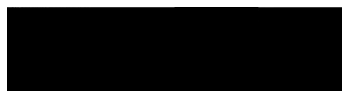

Spatial domain: X - Y - PREDICT


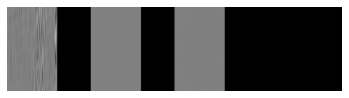

Spatial domain: X - Y - PREDICT


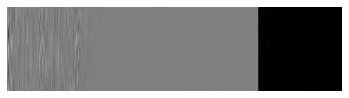

Spatial domain: X - Y - PREDICT


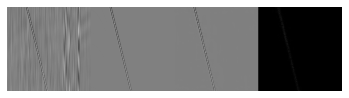

Spatial domain: X - Y - PREDICT


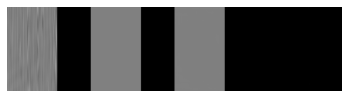

Spatial domain: X - Y - PREDICT


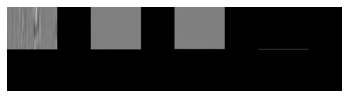

Spatial domain: X - Y - PREDICT


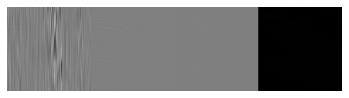

Spatial domain: X - Y - PREDICT


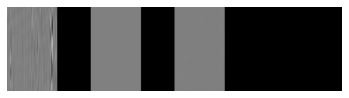

Spatial domain: X - Y - PREDICT


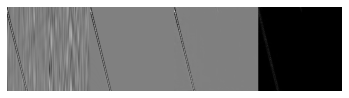

Spatial domain: X - Y - PREDICT


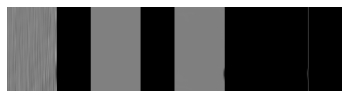

Spatial domain: X - Y - PREDICT


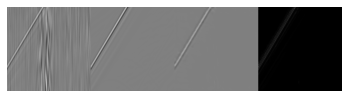

Spatial domain: X - Y - PREDICT


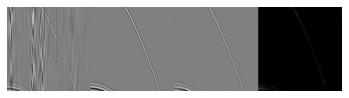

Spatial domain: X - Y - PREDICT


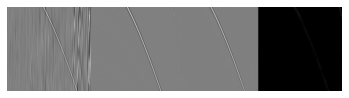

Spatial domain: X - Y - PREDICT


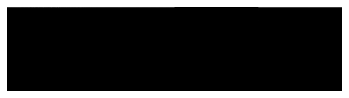

Spatial domain: X - Y - PREDICT


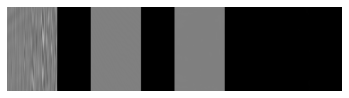

Spatial domain: X - Y - PREDICT


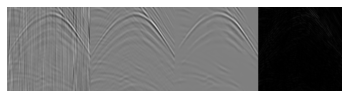

Spatial domain: X - Y - PREDICT


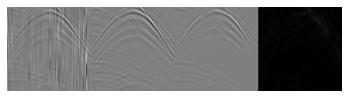

Spatial domain: X - Y - PREDICT


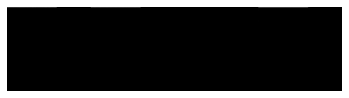

Spatial domain: X - Y - PREDICT


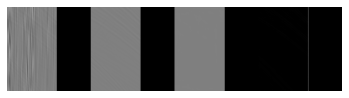

Spatial domain: X - Y - PREDICT


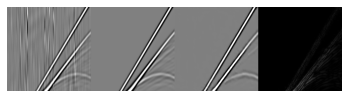

Spatial domain: X - Y - PREDICT


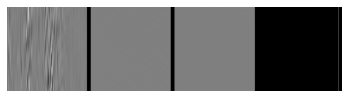

Spatial domain: X - Y - PREDICT


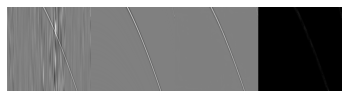

Spatial domain: X - Y - PREDICT


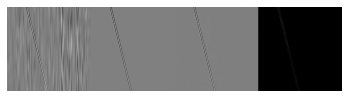

Spatial domain: X - Y - PREDICT


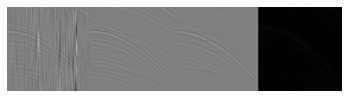

Spatial domain: X - Y - PREDICT


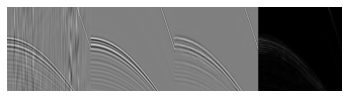

Spatial domain: X - Y - PREDICT


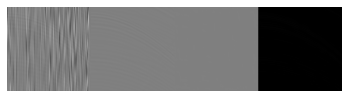

Spatial domain: X - Y - PREDICT


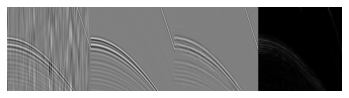

Spatial domain: X - Y - PREDICT


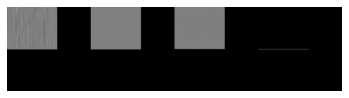

Spatial domain: X - Y - PREDICT


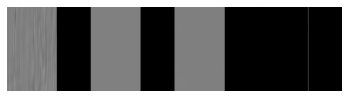

Spatial domain: X - Y - PREDICT


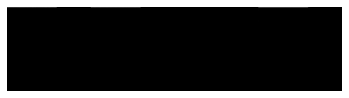

Spatial domain: X - Y - PREDICT


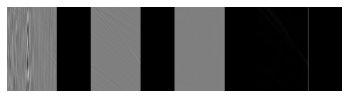

Spatial domain: X - Y - PREDICT


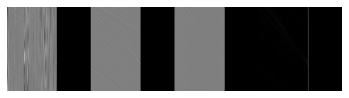

Spatial domain: X - Y - PREDICT


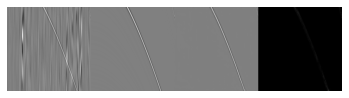

Spatial domain: X - Y - PREDICT


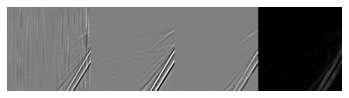

Spatial domain: X - Y - PREDICT


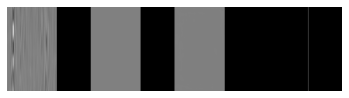

Spatial domain: X - Y - PREDICT


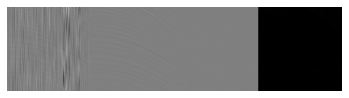

Spatial domain: X - Y - PREDICT


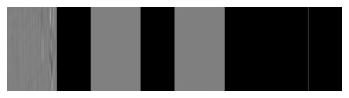

Spatial domain: X - Y - PREDICT


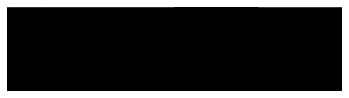

Spatial domain: X - Y - PREDICT


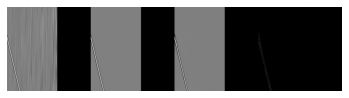

Spatial domain: X - Y - PREDICT


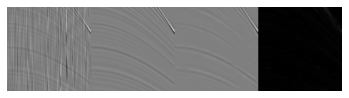

Spatial domain: X - Y - PREDICT


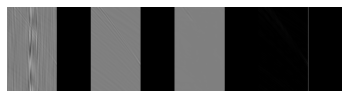

Spatial domain: X - Y - PREDICT


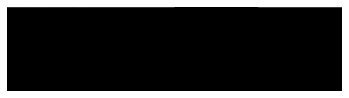

Spatial domain: X - Y - PREDICT


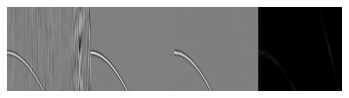

Spatial domain: X - Y - PREDICT


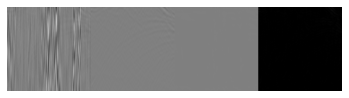

Spatial domain: X - Y - PREDICT


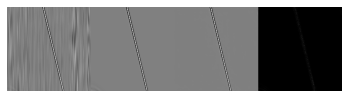

Spatial domain: X - Y - PREDICT


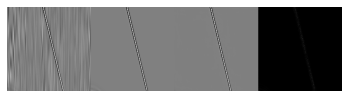

Spatial domain: X - Y - PREDICT


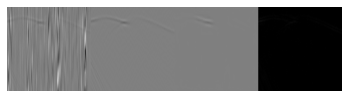

Spatial domain: X - Y - PREDICT


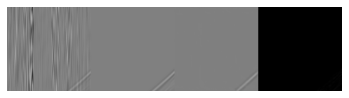

Spatial domain: X - Y - PREDICT


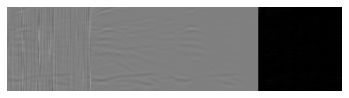

Spatial domain: X - Y - PREDICT


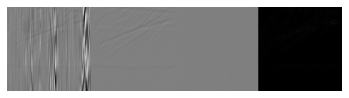

Spatial domain: X - Y - PREDICT


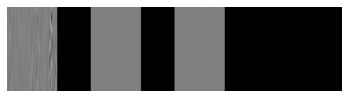

Spatial domain: X - Y - PREDICT


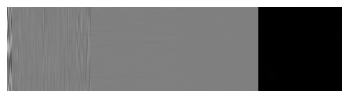

Spatial domain: X - Y - PREDICT


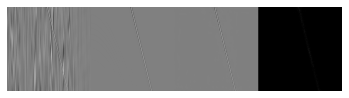

Spatial domain: X - Y - PREDICT


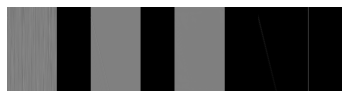

Spatial domain: X - Y - PREDICT


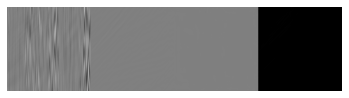

Spatial domain: X - Y - PREDICT


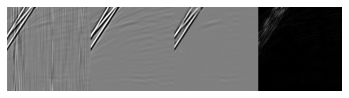

Spatial domain: X - Y - PREDICT


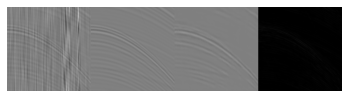

Spatial domain: X - Y - PREDICT


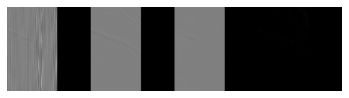

Spatial domain: X - Y - PREDICT


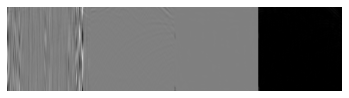

Spatial domain: X - Y - PREDICT


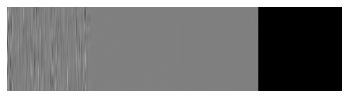

Spatial domain: X - Y - PREDICT


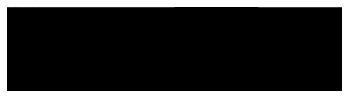

Spatial domain: X - Y - PREDICT


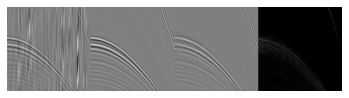

Spatial domain: X - Y - PREDICT


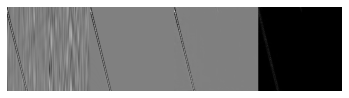

Spatial domain: X - Y - PREDICT


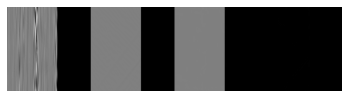

Spatial domain: X - Y - PREDICT


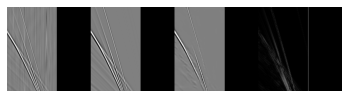

Spatial domain: X - Y - PREDICT


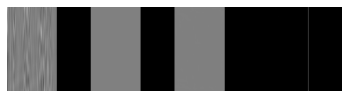

Spatial domain: X - Y - PREDICT


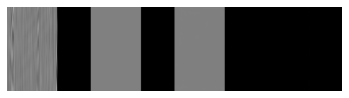

Spatial domain: X - Y - PREDICT


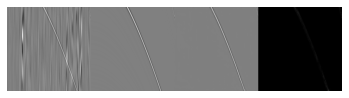

Spatial domain: X - Y - PREDICT


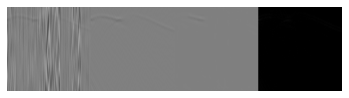

Spatial domain: X - Y - PREDICT


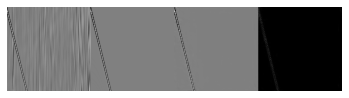

Spatial domain: X - Y - PREDICT


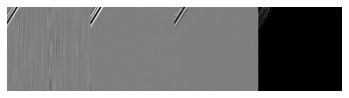

Spatial domain: X - Y - PREDICT


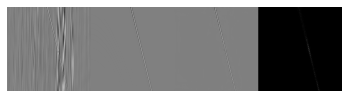

Spatial domain: X - Y - PREDICT


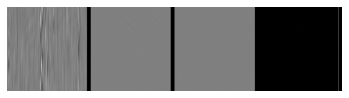

Spatial domain: X - Y - PREDICT


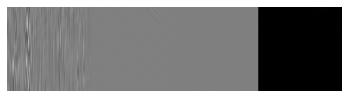

Spatial domain: X - Y - PREDICT


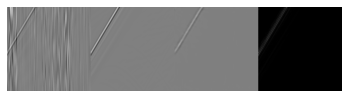

Spatial domain: X - Y - PREDICT


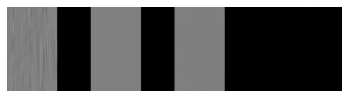

Spatial domain: X - Y - PREDICT


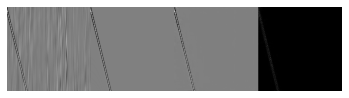

Spatial domain: X - Y - PREDICT


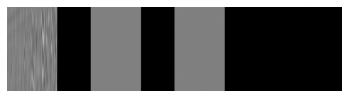

Spatial domain: X - Y - PREDICT


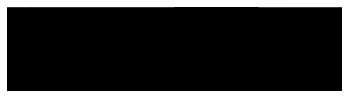

Spatial domain: X - Y - PREDICT


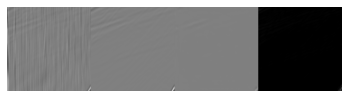

Spatial domain: X - Y - PREDICT


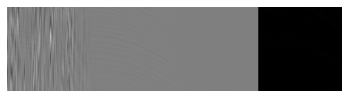

Spatial domain: X - Y - PREDICT


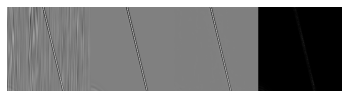

Spatial domain: X - Y - PREDICT


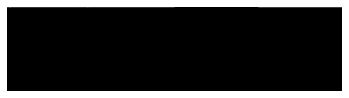

Spatial domain: X - Y - PREDICT


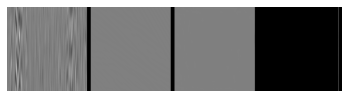

Spatial domain: X - Y - PREDICT


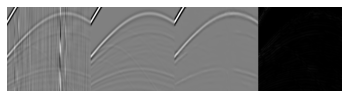

Spatial domain: X - Y - PREDICT


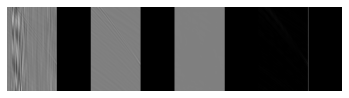

Spatial domain: X - Y - PREDICT


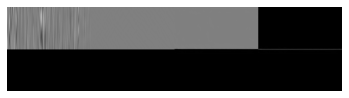

Spatial domain: X - Y - PREDICT


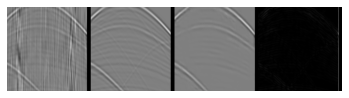

Spatial domain: X - Y - PREDICT


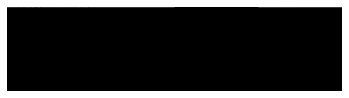

Spatial domain: X - Y - PREDICT


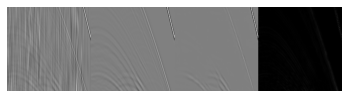

Spatial domain: X - Y - PREDICT


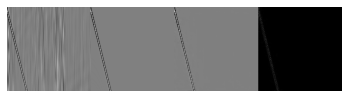

Spatial domain: X - Y - PREDICT


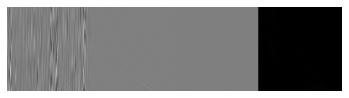

Spatial domain: X - Y - PREDICT


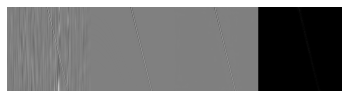

Spatial domain: X - Y - PREDICT


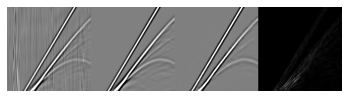

Spatial domain: X - Y - PREDICT


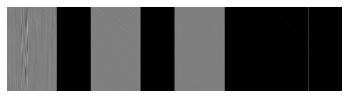

Spatial domain: X - Y - PREDICT


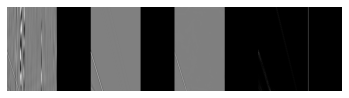

Spatial domain: X - Y - PREDICT


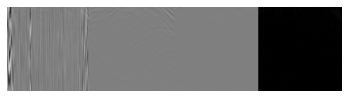

Spatial domain: X - Y - PREDICT


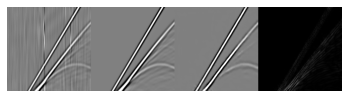

Spatial domain: X - Y - PREDICT


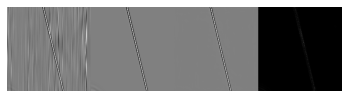

Spatial domain: X - Y - PREDICT


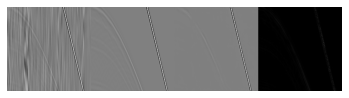

Spatial domain: X - Y - PREDICT


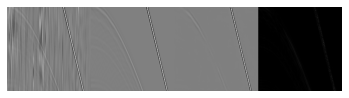

Spatial domain: X - Y - PREDICT


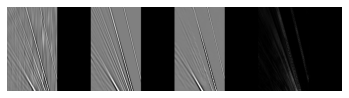

Spatial domain: X - Y - PREDICT


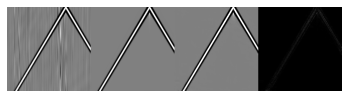

Spatial domain: X - Y - PREDICT


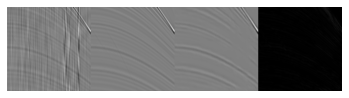

Spatial domain: X - Y - PREDICT


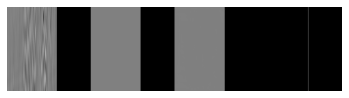

Spatial domain: X - Y - PREDICT


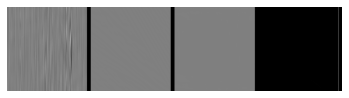

Spatial domain: X - Y - PREDICT


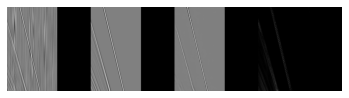

Spatial domain: X - Y - PREDICT


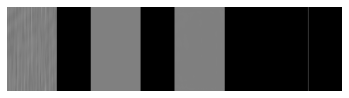

Spatial domain: X - Y - PREDICT


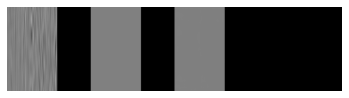

Spatial domain: X - Y - PREDICT


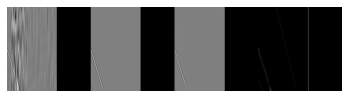

Spatial domain: X - Y - PREDICT


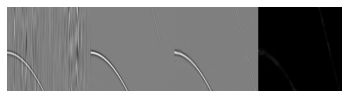

Spatial domain: X - Y - PREDICT


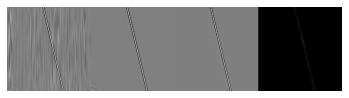

Spatial domain: X - Y - PREDICT


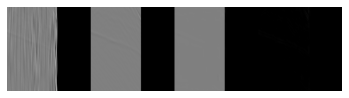

Spatial domain: X - Y - PREDICT


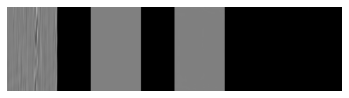

Spatial domain: X - Y - PREDICT


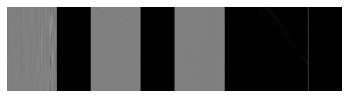

Spatial domain: X - Y - PREDICT


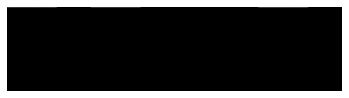

Spatial domain: X - Y - PREDICT


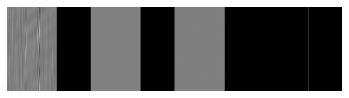

Spatial domain: X - Y - PREDICT


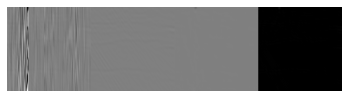

Spatial domain: X - Y - PREDICT


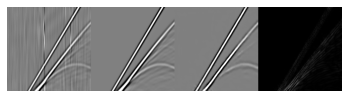

Spatial domain: X - Y - PREDICT


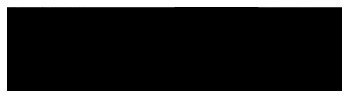

Spatial domain: X - Y - PREDICT


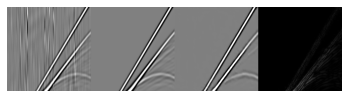

Spatial domain: X - Y - PREDICT


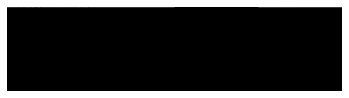

Spatial domain: X - Y - PREDICT


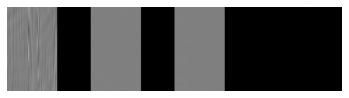

Spatial domain: X - Y - PREDICT


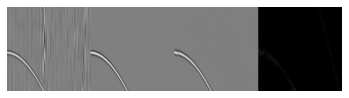

Spatial domain: X - Y - PREDICT


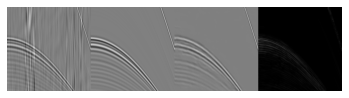

Spatial domain: X - Y - PREDICT


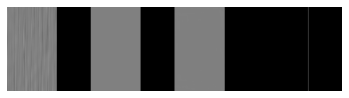

Spatial domain: X - Y - PREDICT


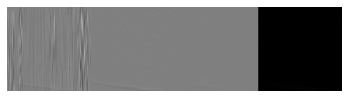

Spatial domain: X - Y - PREDICT


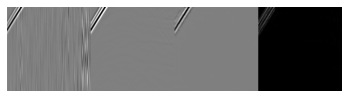

Spatial domain: X - Y - PREDICT


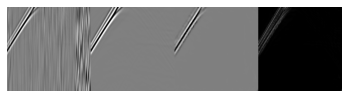

Spatial domain: X - Y - PREDICT


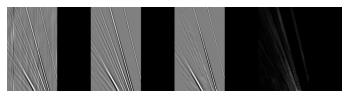

Spatial domain: X - Y - PREDICT


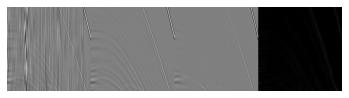

Spatial domain: X - Y - PREDICT


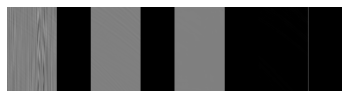

Spatial domain: X - Y - PREDICT


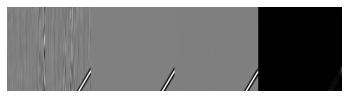

Spatial domain: X - Y - PREDICT


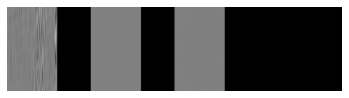

Spatial domain: X - Y - PREDICT


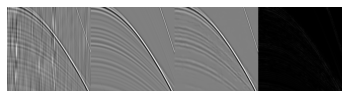

Spatial domain: X - Y - PREDICT


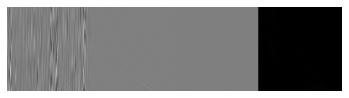

Spatial domain: X - Y - PREDICT


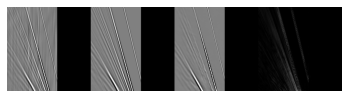

Spatial domain: X - Y - PREDICT


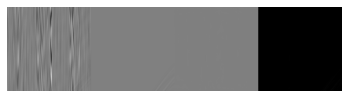

Spatial domain: X - Y - PREDICT


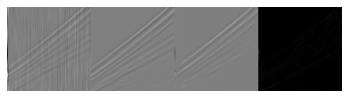

Spatial domain: X - Y - PREDICT


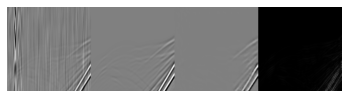

Spatial domain: X - Y - PREDICT


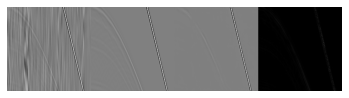

Spatial domain: X - Y - PREDICT


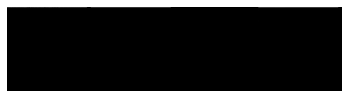

Spatial domain: X - Y - PREDICT


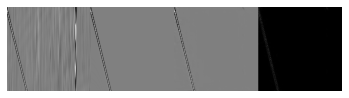

Spatial domain: X - Y - PREDICT


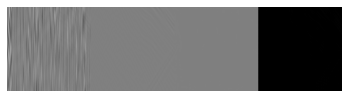

Spatial domain: X - Y - PREDICT


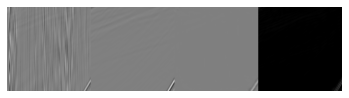

Spatial domain: X - Y - PREDICT


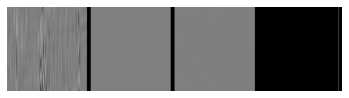

Spatial domain: X - Y - PREDICT


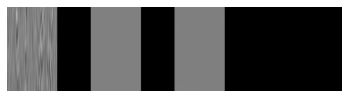

Spatial domain: X - Y - PREDICT


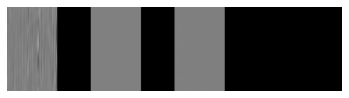

Spatial domain: X - Y - PREDICT


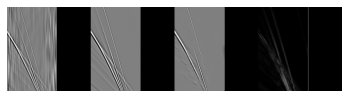

Spatial domain: X - Y - PREDICT


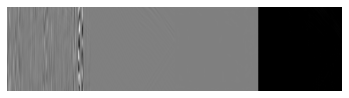

Spatial domain: X - Y - PREDICT


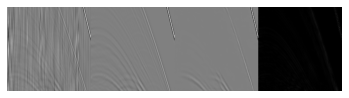

Spatial domain: X - Y - PREDICT


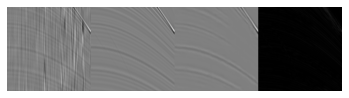

Spatial domain: X - Y - PREDICT


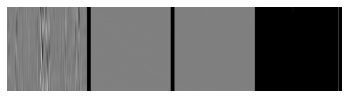

Spatial domain: X - Y - PREDICT


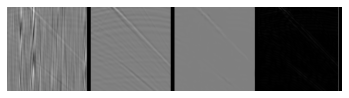

Spatial domain: X - Y - PREDICT


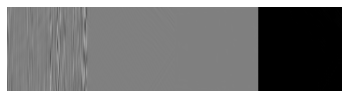

Spatial domain: X - Y - PREDICT


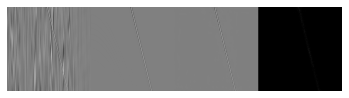

Spatial domain: X - Y - PREDICT


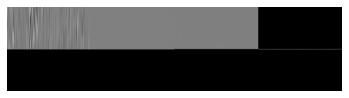

Spatial domain: X - Y - PREDICT


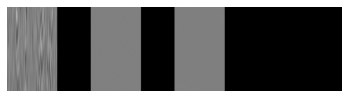

Spatial domain: X - Y - PREDICT


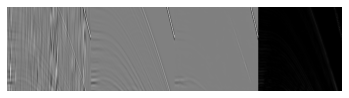

Spatial domain: X - Y - PREDICT


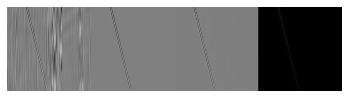

Spatial domain: X - Y - PREDICT


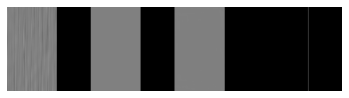

Spatial domain: X - Y - PREDICT


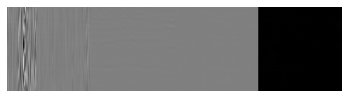

Spatial domain: X - Y - PREDICT


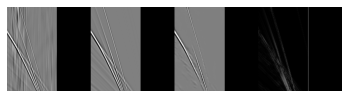

Spatial domain: X - Y - PREDICT


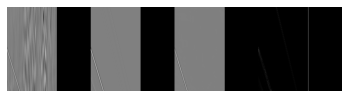

Spatial domain: X - Y - PREDICT


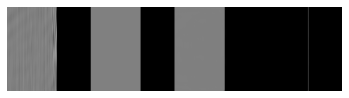

Spatial domain: X - Y - PREDICT


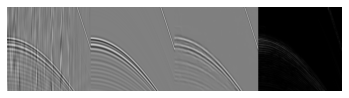

Spatial domain: X - Y - PREDICT


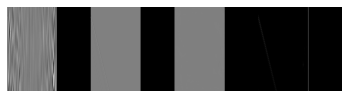

Spatial domain: X - Y - PREDICT


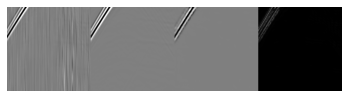

Spatial domain: X - Y - PREDICT


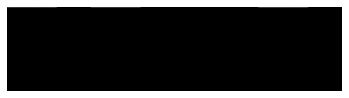

Spatial domain: X - Y - PREDICT


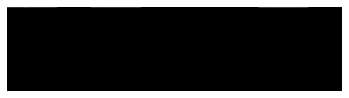

Spatial domain: X - Y - PREDICT


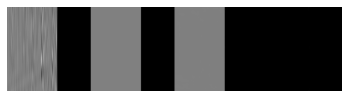

Spatial domain: X - Y - PREDICT


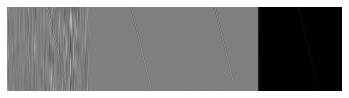

Spatial domain: X - Y - PREDICT


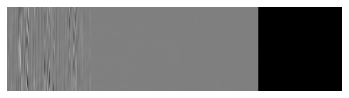

Spatial domain: X - Y - PREDICT


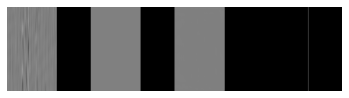

Spatial domain: X - Y - PREDICT


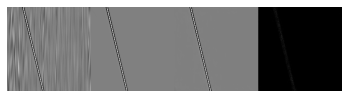

Spatial domain: X - Y - PREDICT


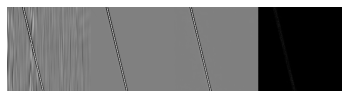

Spatial domain: X - Y - PREDICT


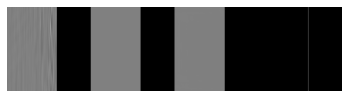

Spatial domain: X - Y - PREDICT


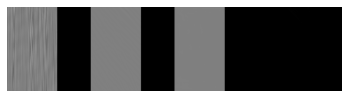

Spatial domain: X - Y - PREDICT


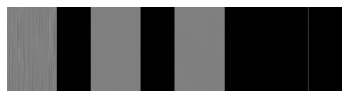

Spatial domain: X - Y - PREDICT


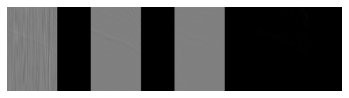

Spatial domain: X - Y - PREDICT


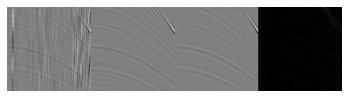

Spatial domain: X - Y - PREDICT


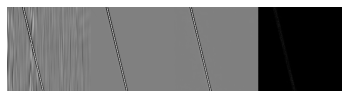

Spatial domain: X - Y - PREDICT


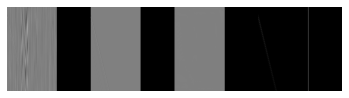

Spatial domain: X - Y - PREDICT


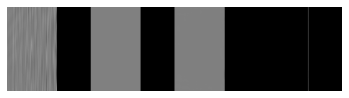

Spatial domain: X - Y - PREDICT


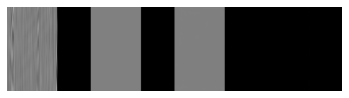

Spatial domain: X - Y - PREDICT


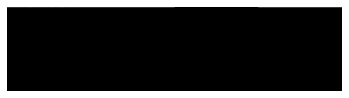

Spatial domain: X - Y - PREDICT


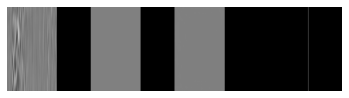

Spatial domain: X - Y - PREDICT


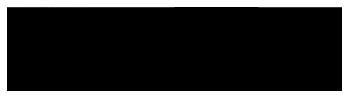

Spatial domain: X - Y - PREDICT


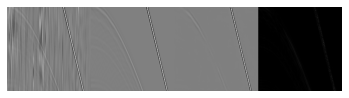

Spatial domain: X - Y - PREDICT


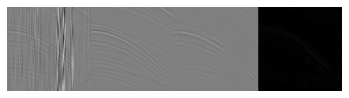

Spatial domain: X - Y - PREDICT


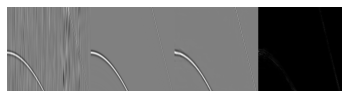

Spatial domain: X - Y - PREDICT


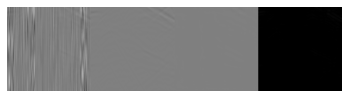

Spatial domain: X - Y - PREDICT


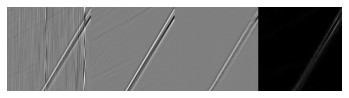

Spatial domain: X - Y - PREDICT


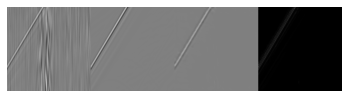

Spatial domain: X - Y - PREDICT


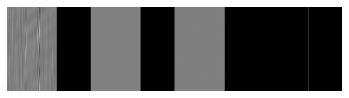

Spatial domain: X - Y - PREDICT


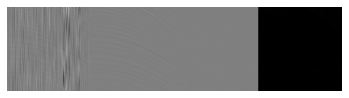

Spatial domain: X - Y - PREDICT


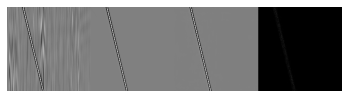

Spatial domain: X - Y - PREDICT


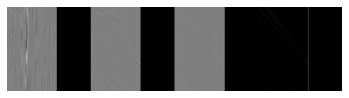

Spatial domain: X - Y - PREDICT


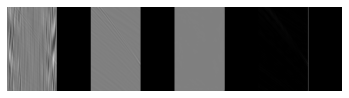

Spatial domain: X - Y - PREDICT


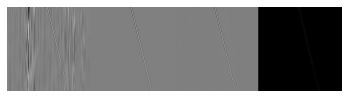

Spatial domain: X - Y - PREDICT


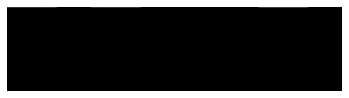

Spatial domain: X - Y - PREDICT


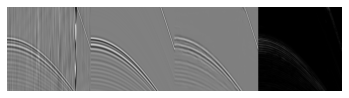

Spatial domain: X - Y - PREDICT


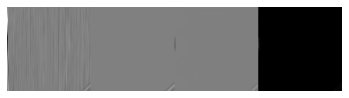

Spatial domain: X - Y - PREDICT


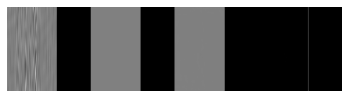

Spatial domain: X - Y - PREDICT


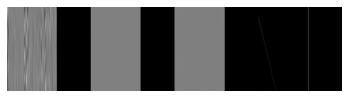

Spatial domain: X - Y - PREDICT


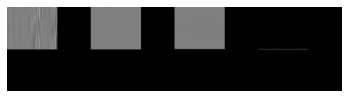

Spatial domain: X - Y - PREDICT


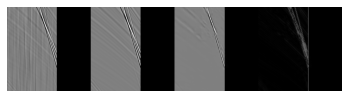

Spatial domain: X - Y - PREDICT


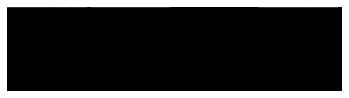

Spatial domain: X - Y - PREDICT


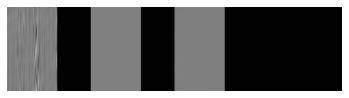

Spatial domain: X - Y - PREDICT


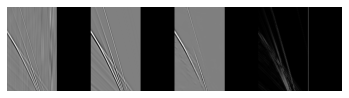

Spatial domain: X - Y - PREDICT


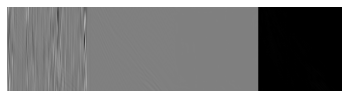

Spatial domain: X - Y - PREDICT


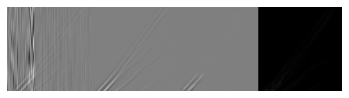

Spatial domain: X - Y - PREDICT


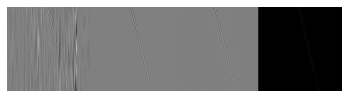

Spatial domain: X - Y - PREDICT


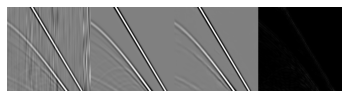

Spatial domain: X - Y - PREDICT


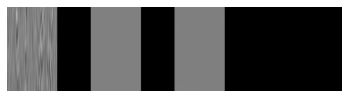

Spatial domain: X - Y - PREDICT


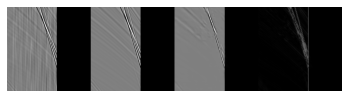

Spatial domain: X - Y - PREDICT


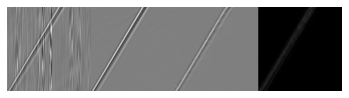

Spatial domain: X - Y - PREDICT


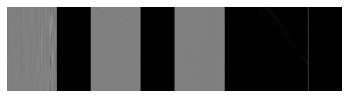

Spatial domain: X - Y - PREDICT


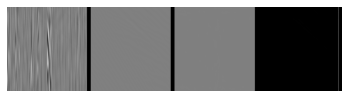

Spatial domain: X - Y - PREDICT


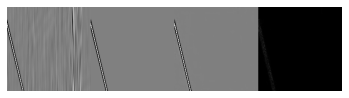

Spatial domain: X - Y - PREDICT


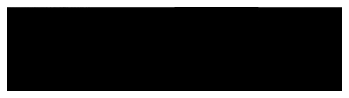

Spatial domain: X - Y - PREDICT


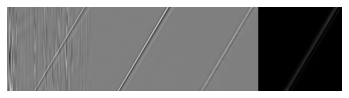

Spatial domain: X - Y - PREDICT


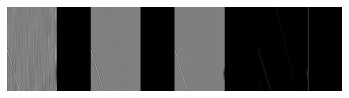

Spatial domain: X - Y - PREDICT


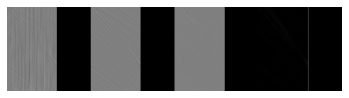

Spatial domain: X - Y - PREDICT


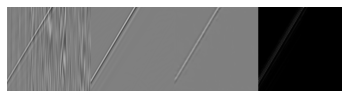

Spatial domain: X - Y - PREDICT


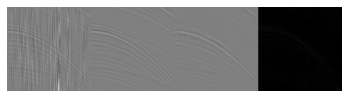

Spatial domain: X - Y - PREDICT


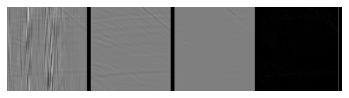

Spatial domain: X - Y - PREDICT


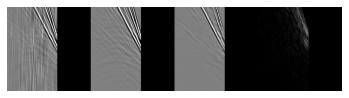

Spatial domain: X - Y - PREDICT


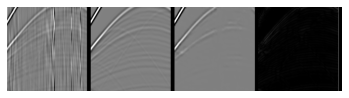

Spatial domain: X - Y - PREDICT


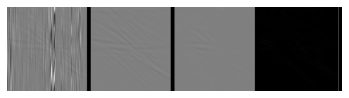

Spatial domain: X - Y - PREDICT


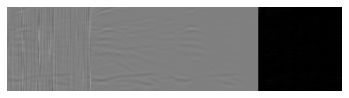

Spatial domain: X - Y - PREDICT


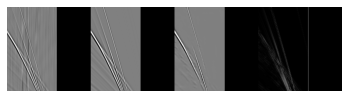

Spatial domain: X - Y - PREDICT


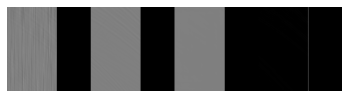

Spatial domain: X - Y - PREDICT


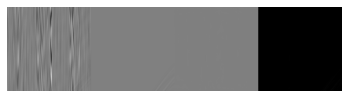

Spatial domain: X - Y - PREDICT


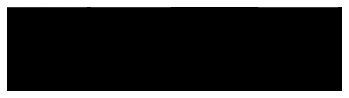

Spatial domain: X - Y - PREDICT


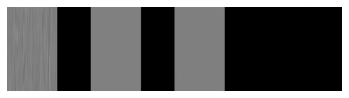

Spatial domain: X - Y - PREDICT


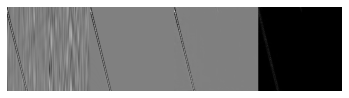

Spatial domain: X - Y - PREDICT


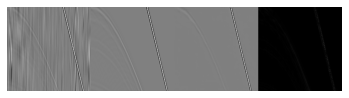

Spatial domain: X - Y - PREDICT


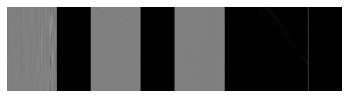

Spatial domain: X - Y - PREDICT


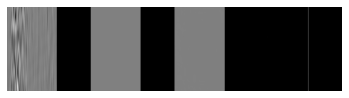

Spatial domain: X - Y - PREDICT


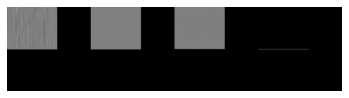

Spatial domain: X - Y - PREDICT


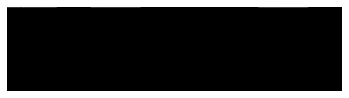

Spatial domain: X - Y - PREDICT


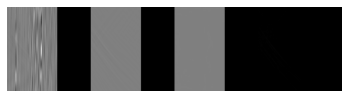

Spatial domain: X - Y - PREDICT


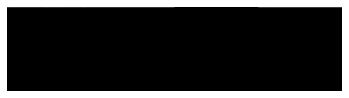

Spatial domain: X - Y - PREDICT


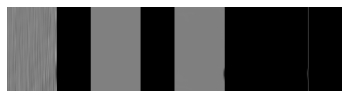

Spatial domain: X - Y - PREDICT


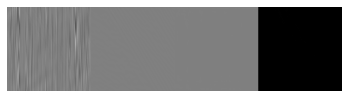

Spatial domain: X - Y - PREDICT


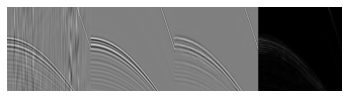

Spatial domain: X - Y - PREDICT


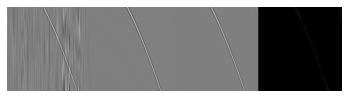

Spatial domain: X - Y - PREDICT


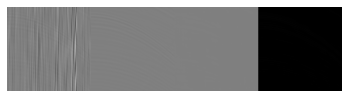

Spatial domain: X - Y - PREDICT


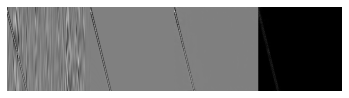

Spatial domain: X - Y - PREDICT


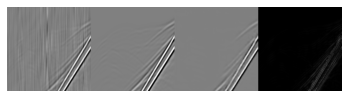

Spatial domain: X - Y - PREDICT


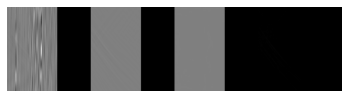

Spatial domain: X - Y - PREDICT


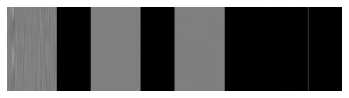

Spatial domain: X - Y - PREDICT


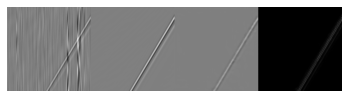

Spatial domain: X - Y - PREDICT


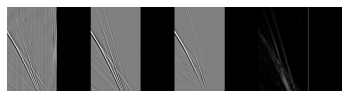

Spatial domain: X - Y - PREDICT


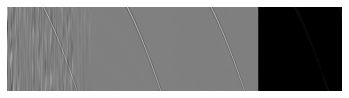

Spatial domain: X - Y - PREDICT


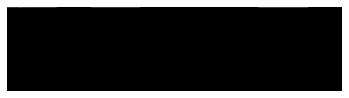

Spatial domain: X - Y - PREDICT


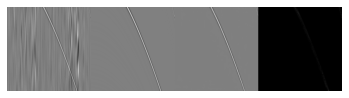

Spatial domain: X - Y - PREDICT


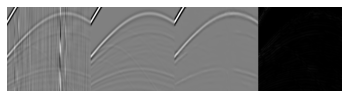

Spatial domain: X - Y - PREDICT


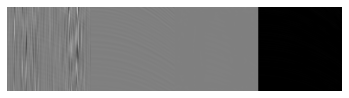

Spatial domain: X - Y - PREDICT


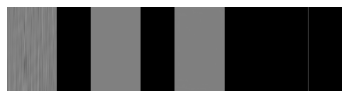

Spatial domain: X - Y - PREDICT


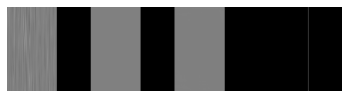

Spatial domain: X - Y - PREDICT


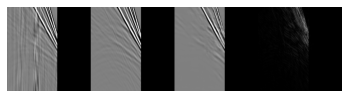

Spatial domain: X - Y - PREDICT


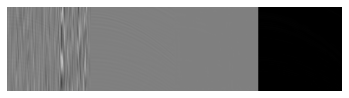

Spatial domain: X - Y - PREDICT


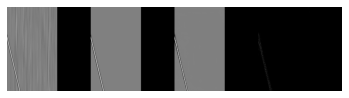

Spatial domain: X - Y - PREDICT


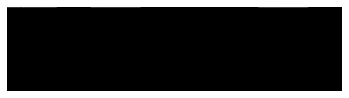

Spatial domain: X - Y - PREDICT


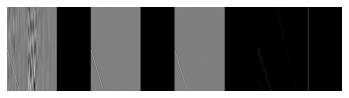

Spatial domain: X - Y - PREDICT


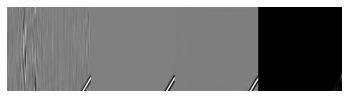

Spatial domain: X - Y - PREDICT


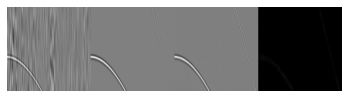

Spatial domain: X - Y - PREDICT


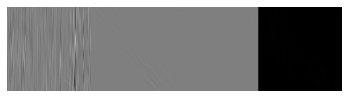

Spatial domain: X - Y - PREDICT


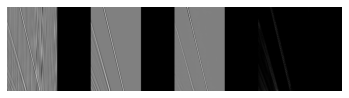

Spatial domain: X - Y - PREDICT


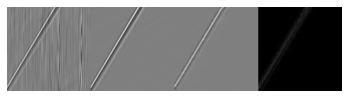

Spatial domain: X - Y - PREDICT


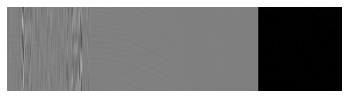

Spatial domain: X - Y - PREDICT


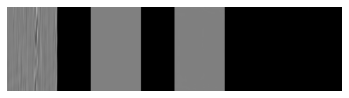

Spatial domain: X - Y - PREDICT


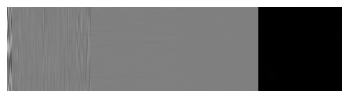

Spatial domain: X - Y - PREDICT


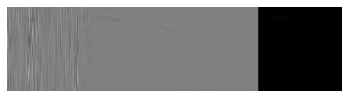

Spatial domain: X - Y - PREDICT


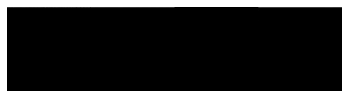

Spatial domain: X - Y - PREDICT


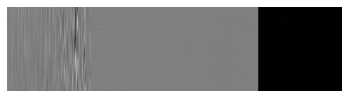

Spatial domain: X - Y - PREDICT


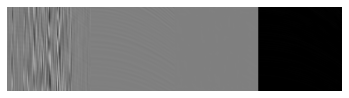

Spatial domain: X - Y - PREDICT


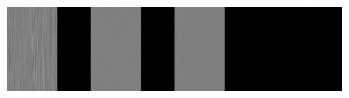

Spatial domain: X - Y - PREDICT


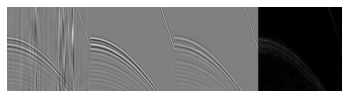

Spatial domain: X - Y - PREDICT


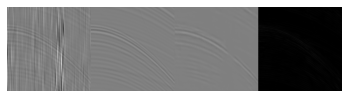

Spatial domain: X - Y - PREDICT


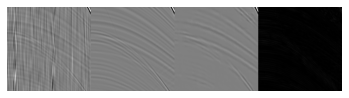

Spatial domain: X - Y - PREDICT


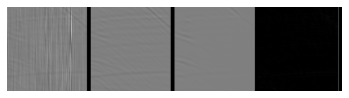

Spatial domain: X - Y - PREDICT


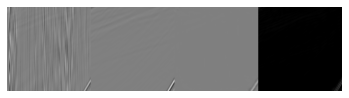

Spatial domain: X - Y - PREDICT


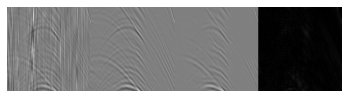

Spatial domain: X - Y - PREDICT


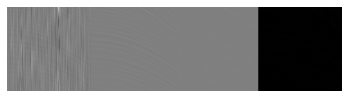

Spatial domain: X - Y - PREDICT


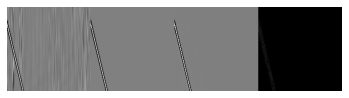

Spatial domain: X - Y - PREDICT


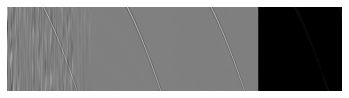

Spatial domain: X - Y - PREDICT


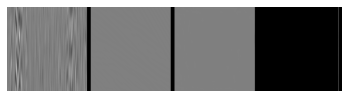

Spatial domain: X - Y - PREDICT


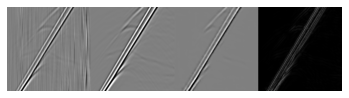

Spatial domain: X - Y - PREDICT


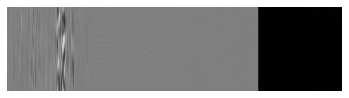

Spatial domain: X - Y - PREDICT


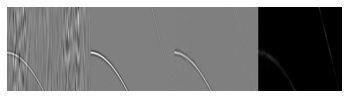

Spatial domain: X - Y - PREDICT


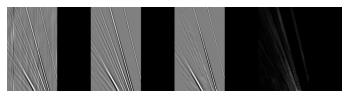

Spatial domain: X - Y - PREDICT


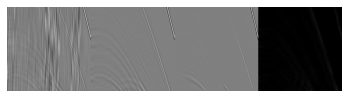

Spatial domain: X - Y - PREDICT


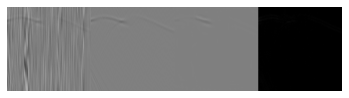

Spatial domain: X - Y - PREDICT


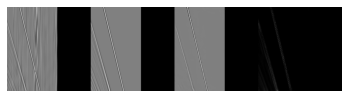

Spatial domain: X - Y - PREDICT


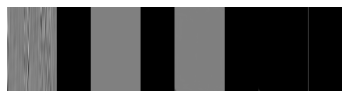

Spatial domain: X - Y - PREDICT


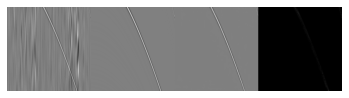

Spatial domain: X - Y - PREDICT


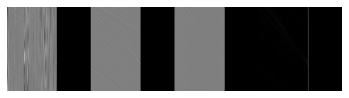

Spatial domain: X - Y - PREDICT


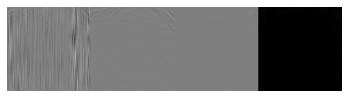

Spatial domain: X - Y - PREDICT


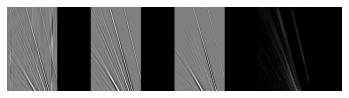

Spatial domain: X - Y - PREDICT


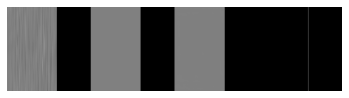

Spatial domain: X - Y - PREDICT


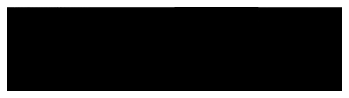

Spatial domain: X - Y - PREDICT


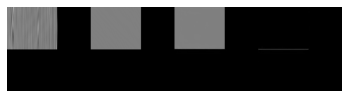

Spatial domain: X - Y - PREDICT


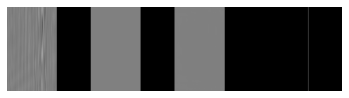

Spatial domain: X - Y - PREDICT


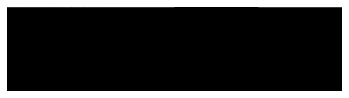

Spatial domain: X - Y - PREDICT


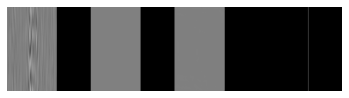

Spatial domain: X - Y - PREDICT


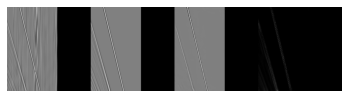

Spatial domain: X - Y - PREDICT


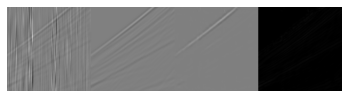

Spatial domain: X - Y - PREDICT


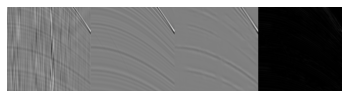

Spatial domain: X - Y - PREDICT


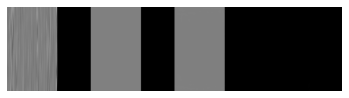

Spatial domain: X - Y - PREDICT


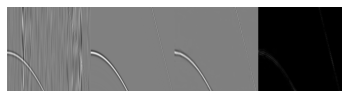

Spatial domain: X - Y - PREDICT


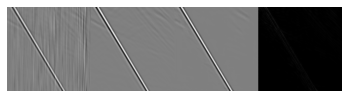

Spatial domain: X - Y - PREDICT


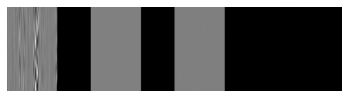

Spatial domain: X - Y - PREDICT


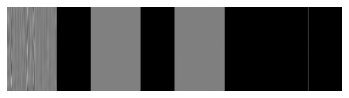

Spatial domain: X - Y - PREDICT


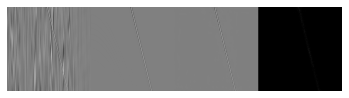

Spatial domain: X - Y - PREDICT


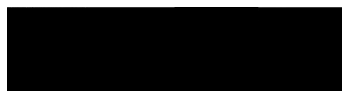

Spatial domain: X - Y - PREDICT


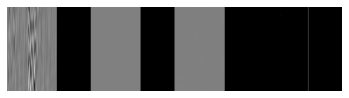

Spatial domain: X - Y - PREDICT


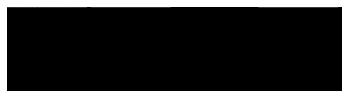

Spatial domain: X - Y - PREDICT


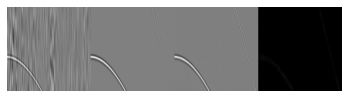

Spatial domain: X - Y - PREDICT


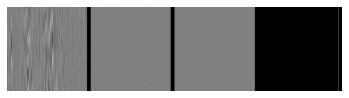

Spatial domain: X - Y - PREDICT


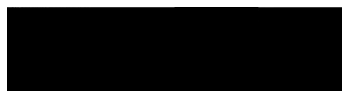

Spatial domain: X - Y - PREDICT


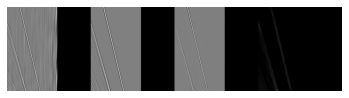

Spatial domain: X - Y - PREDICT


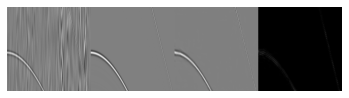

Spatial domain: X - Y - PREDICT


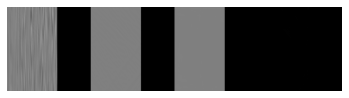

Spatial domain: X - Y - PREDICT


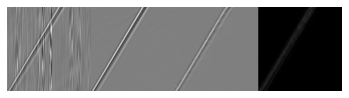

Spatial domain: X - Y - PREDICT


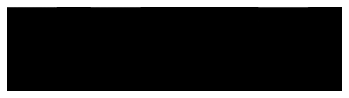

Spatial domain: X - Y - PREDICT


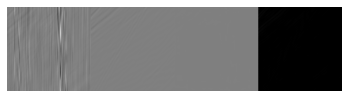

Spatial domain: X - Y - PREDICT


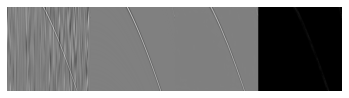

Spatial domain: X - Y - PREDICT


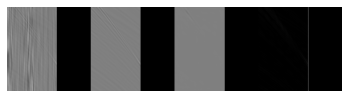

Spatial domain: X - Y - PREDICT


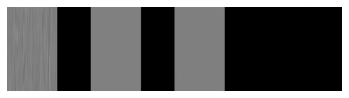

Spatial domain: X - Y - PREDICT


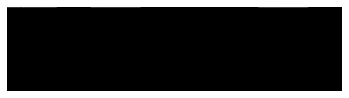

Spatial domain: X - Y - PREDICT


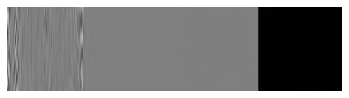

Spatial domain: X - Y - PREDICT


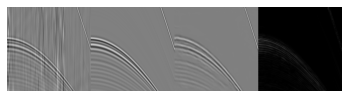

Spatial domain: X - Y - PREDICT


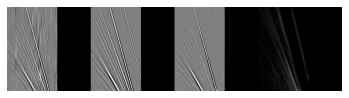

Spatial domain: X - Y - PREDICT


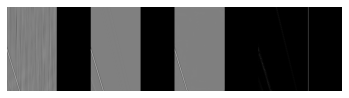

Spatial domain: X - Y - PREDICT


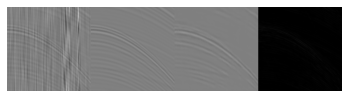

Spatial domain: X - Y - PREDICT


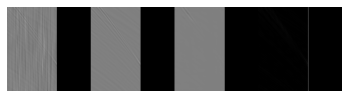

Spatial domain: X - Y - PREDICT


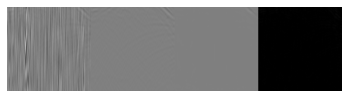

Spatial domain: X - Y - PREDICT


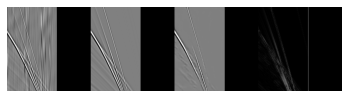

Spatial domain: X - Y - PREDICT


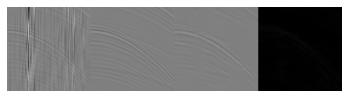

Spatial domain: X - Y - PREDICT


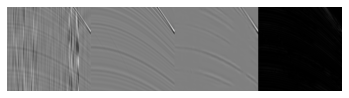

Spatial domain: X - Y - PREDICT


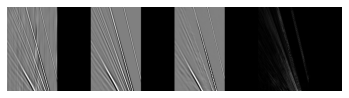

Spatial domain: X - Y - PREDICT


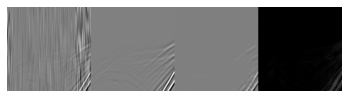

Spatial domain: X - Y - PREDICT


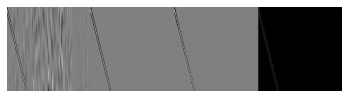

Spatial domain: X - Y - PREDICT


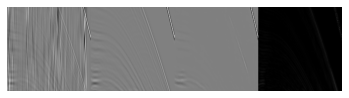

Spatial domain: X - Y - PREDICT


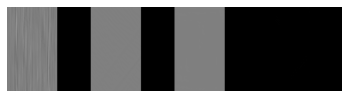

Spatial domain: X - Y - PREDICT


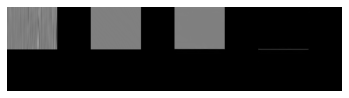

Spatial domain: X - Y - PREDICT


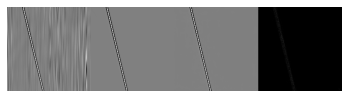

Spatial domain: X - Y - PREDICT


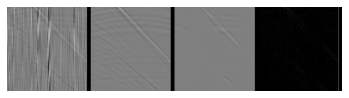

Spatial domain: X - Y - PREDICT


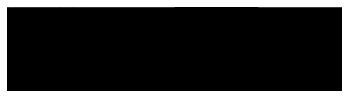

Spatial domain: X - Y - PREDICT


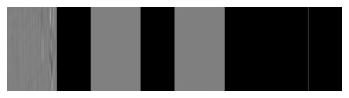

Spatial domain: X - Y - PREDICT


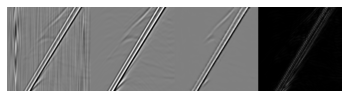

Spatial domain: X - Y - PREDICT


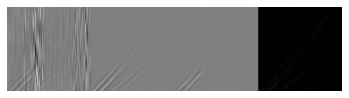

Spatial domain: X - Y - PREDICT


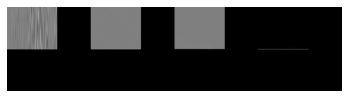

Spatial domain: X - Y - PREDICT


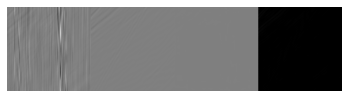

Spatial domain: X - Y - PREDICT


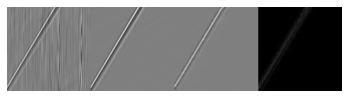

Spatial domain: X - Y - PREDICT


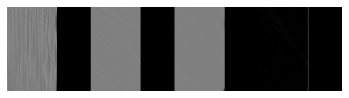

Spatial domain: X - Y - PREDICT


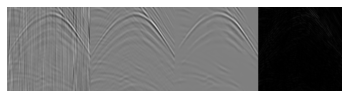

Spatial domain: X - Y - PREDICT


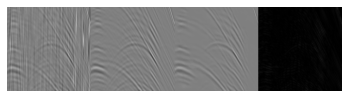

Spatial domain: X - Y - PREDICT


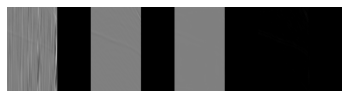

Spatial domain: X - Y - PREDICT


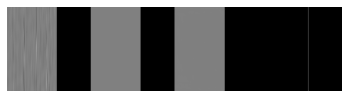

Spatial domain: X - Y - PREDICT


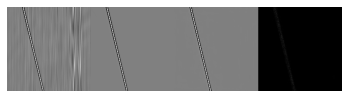

Spatial domain: X - Y - PREDICT


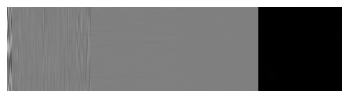

Spatial domain: X - Y - PREDICT


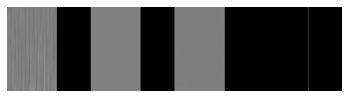

Spatial domain: X - Y - PREDICT


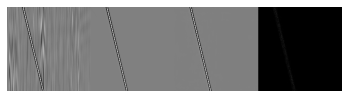

Spatial domain: X - Y - PREDICT


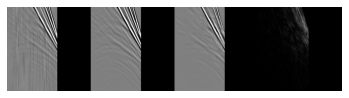

Spatial domain: X - Y - PREDICT


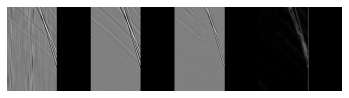

Spatial domain: X - Y - PREDICT


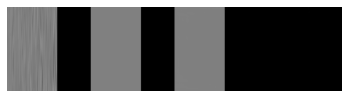

Spatial domain: X - Y - PREDICT


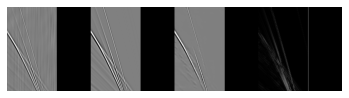

Spatial domain: X - Y - PREDICT


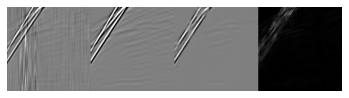

Spatial domain: X - Y - PREDICT


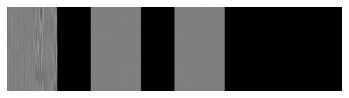

Spatial domain: X - Y - PREDICT


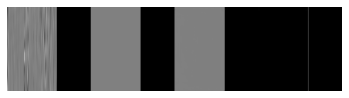

Spatial domain: X - Y - PREDICT


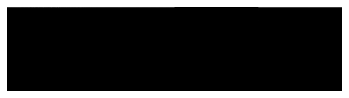

Spatial domain: X - Y - PREDICT


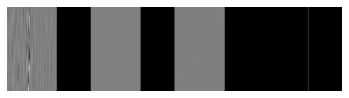

Spatial domain: X - Y - PREDICT


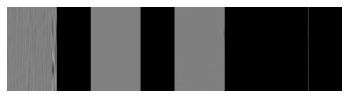

Spatial domain: X - Y - PREDICT


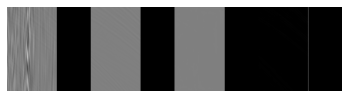

Spatial domain: X - Y - PREDICT


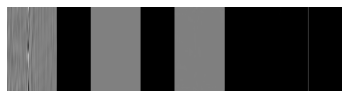

Spatial domain: X - Y - PREDICT


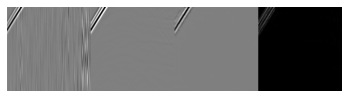

Spatial domain: X - Y - PREDICT


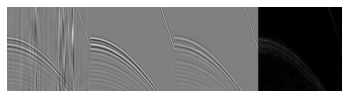

Spatial domain: X - Y - PREDICT


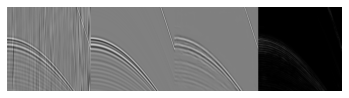

Spatial domain: X - Y - PREDICT


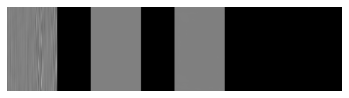

Spatial domain: X - Y - PREDICT


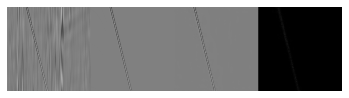

Spatial domain: X - Y - PREDICT


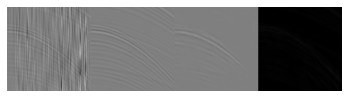

Spatial domain: X - Y - PREDICT


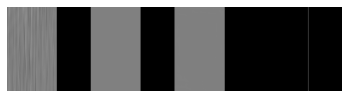

Spatial domain: X - Y - PREDICT


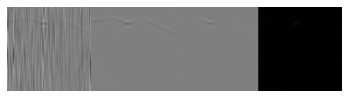

Spatial domain: X - Y - PREDICT


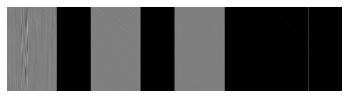

Spatial domain: X - Y - PREDICT


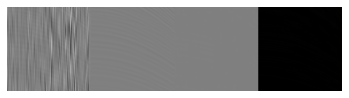

Spatial domain: X - Y - PREDICT


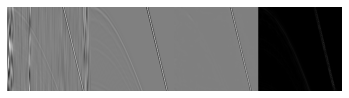

Spatial domain: X - Y - PREDICT


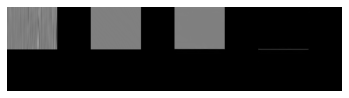

Spatial domain: X - Y - PREDICT


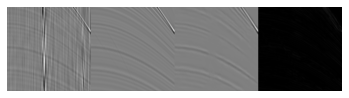

Spatial domain: X - Y - PREDICT


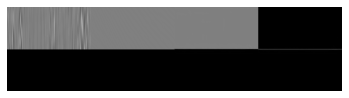

Spatial domain: X - Y - PREDICT


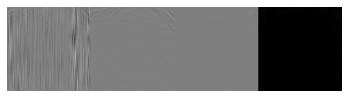

Spatial domain: X - Y - PREDICT


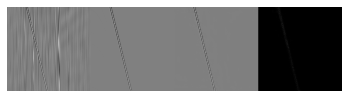

Spatial domain: X - Y - PREDICT


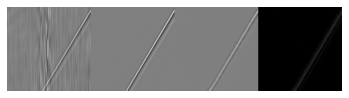

Spatial domain: X - Y - PREDICT


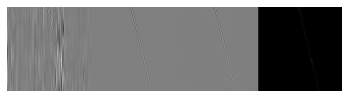

Spatial domain: X - Y - PREDICT


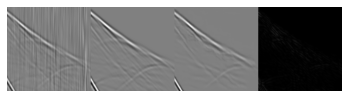

Spatial domain: X - Y - PREDICT


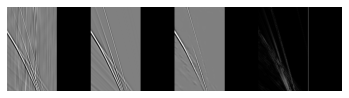

Spatial domain: X - Y - PREDICT


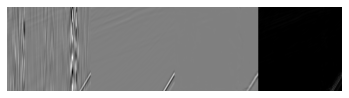

Spatial domain: X - Y - PREDICT


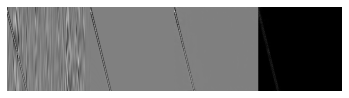

Spatial domain: X - Y - PREDICT


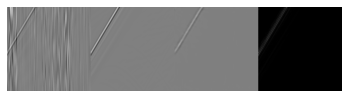

Spatial domain: X - Y - PREDICT


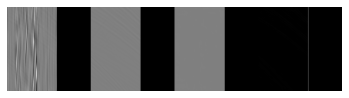

Spatial domain: X - Y - PREDICT


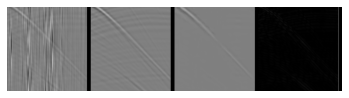

Spatial domain: X - Y - PREDICT


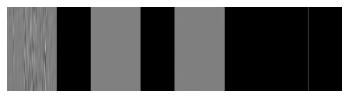

Spatial domain: X - Y - PREDICT


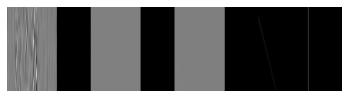

Spatial domain: X - Y - PREDICT


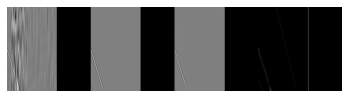

Spatial domain: X - Y - PREDICT


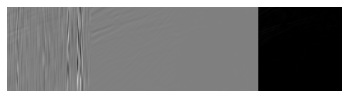

Spatial domain: X - Y - PREDICT


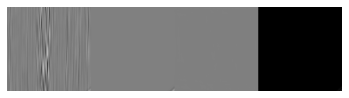

Spatial domain: X - Y - PREDICT


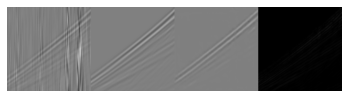

Spatial domain: X - Y - PREDICT


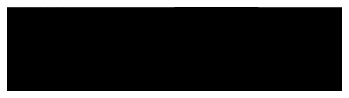

Spatial domain: X - Y - PREDICT


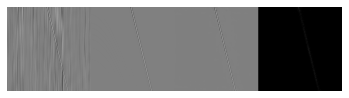

Spatial domain: X - Y - PREDICT


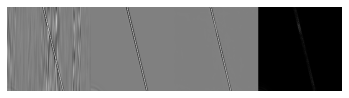

Spatial domain: X - Y - PREDICT


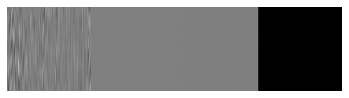

Spatial domain: X - Y - PREDICT


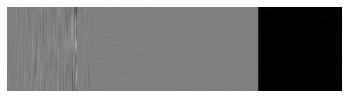

Spatial domain: X - Y - PREDICT


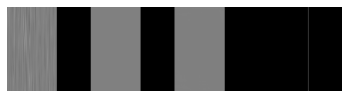

Spatial domain: X - Y - PREDICT


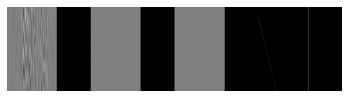

Spatial domain: X - Y - PREDICT


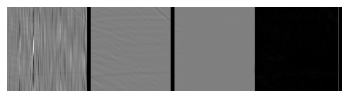

Spatial domain: X - Y - PREDICT


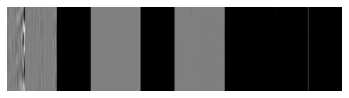

Spatial domain: X - Y - PREDICT


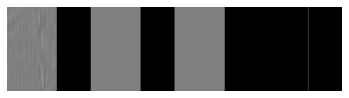

Spatial domain: X - Y - PREDICT


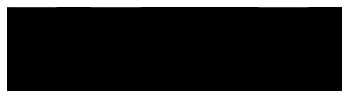

Spatial domain: X - Y - PREDICT


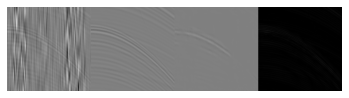

Spatial domain: X - Y - PREDICT


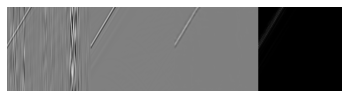

Spatial domain: X - Y - PREDICT


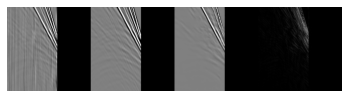

Spatial domain: X - Y - PREDICT


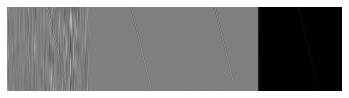

Spatial domain: X - Y - PREDICT


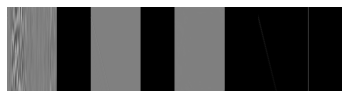

Spatial domain: X - Y - PREDICT


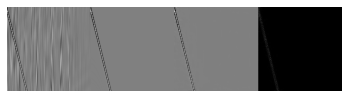

Spatial domain: X - Y - PREDICT


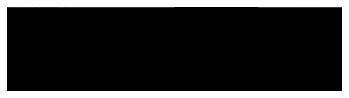

Spatial domain: X - Y - PREDICT


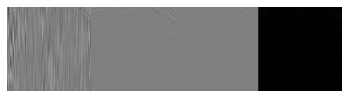

Spatial domain: X - Y - PREDICT


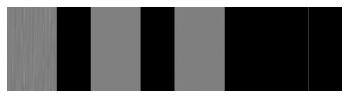

Spatial domain: X - Y - PREDICT


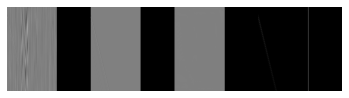

Spatial domain: X - Y - PREDICT


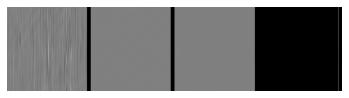

Spatial domain: X - Y - PREDICT


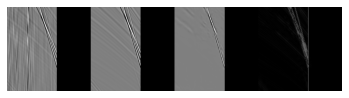

Spatial domain: X - Y - PREDICT


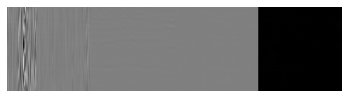

Spatial domain: X - Y - PREDICT


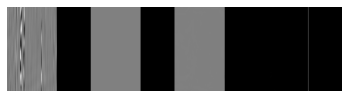

Spatial domain: X - Y - PREDICT


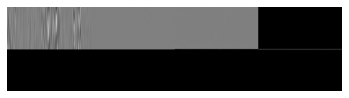

Spatial domain: X - Y - PREDICT


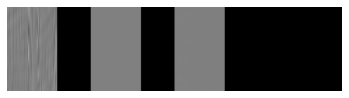

Spatial domain: X - Y - PREDICT


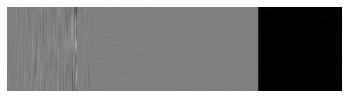

Spatial domain: X - Y - PREDICT


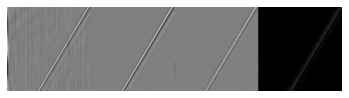

Spatial domain: X - Y - PREDICT


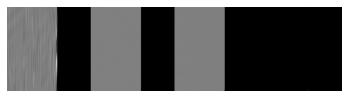

Spatial domain: X - Y - PREDICT


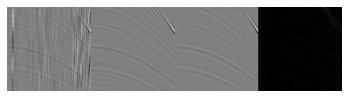

Spatial domain: X - Y - PREDICT


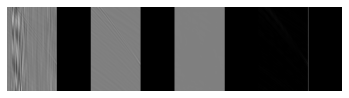

Spatial domain: X - Y - PREDICT


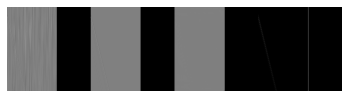

Spatial domain: X - Y - PREDICT


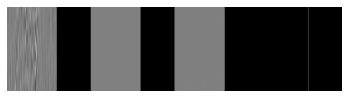

Spatial domain: X - Y - PREDICT


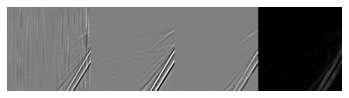

Spatial domain: X - Y - PREDICT


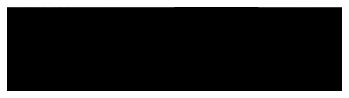

Spatial domain: X - Y - PREDICT


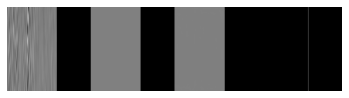

Spatial domain: X - Y - PREDICT


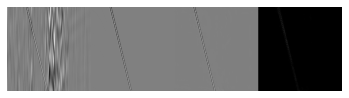

Spatial domain: X - Y - PREDICT


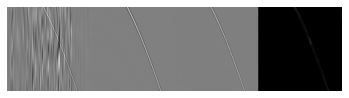

Spatial domain: X - Y - PREDICT


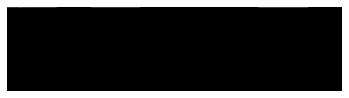

Spatial domain: X - Y - PREDICT


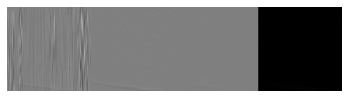

Spatial domain: X - Y - PREDICT


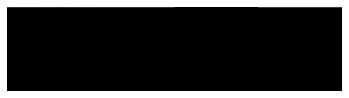

Spatial domain: X - Y - PREDICT


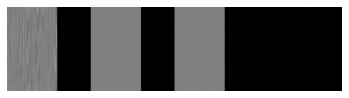

Spatial domain: X - Y - PREDICT


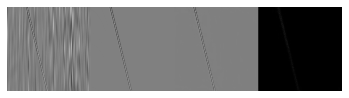

Spatial domain: X - Y - PREDICT


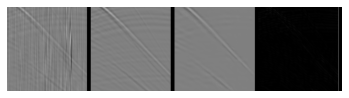

Spatial domain: X - Y - PREDICT


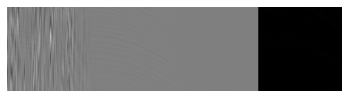

Spatial domain: X - Y - PREDICT


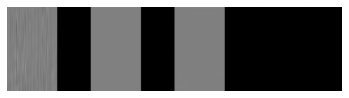

Spatial domain: X - Y - PREDICT


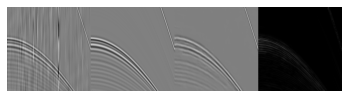

Spatial domain: X - Y - PREDICT


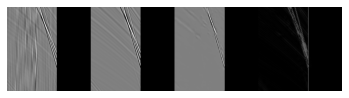

Spatial domain: X - Y - PREDICT


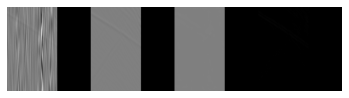

Spatial domain: X - Y - PREDICT


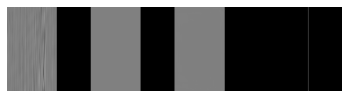

Spatial domain: X - Y - PREDICT


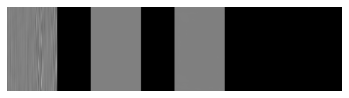

Spatial domain: X - Y - PREDICT


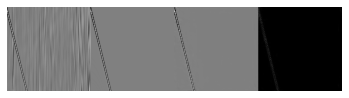

Spatial domain: X - Y - PREDICT


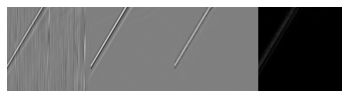

Spatial domain: X - Y - PREDICT


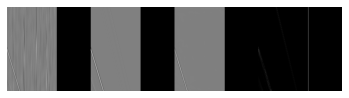

Spatial domain: X - Y - PREDICT


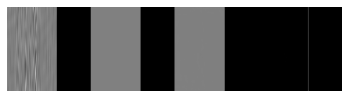

Spatial domain: X - Y - PREDICT


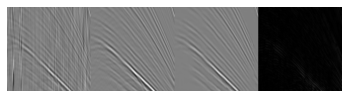

Spatial domain: X - Y - PREDICT


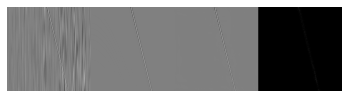

Spatial domain: X - Y - PREDICT


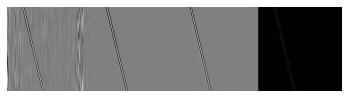

Spatial domain: X - Y - PREDICT


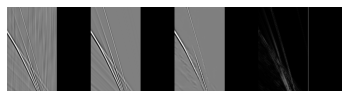

Spatial domain: X - Y - PREDICT


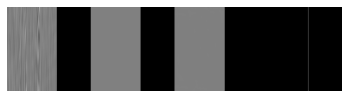

Spatial domain: X - Y - PREDICT


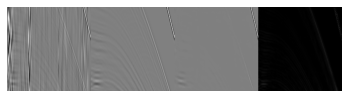

Spatial domain: X - Y - PREDICT


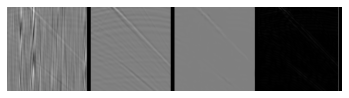

Spatial domain: X - Y - PREDICT


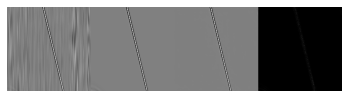

Spatial domain: X - Y - PREDICT


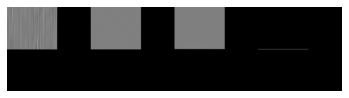

Spatial domain: X - Y - PREDICT


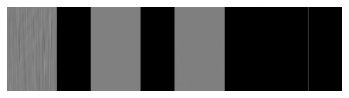

Spatial domain: X - Y - PREDICT


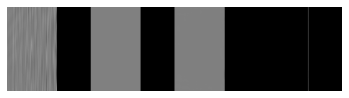

Spatial domain: X - Y - PREDICT


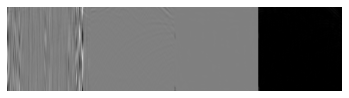

Spatial domain: X - Y - PREDICT


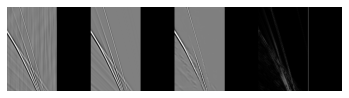

Spatial domain: X - Y - PREDICT


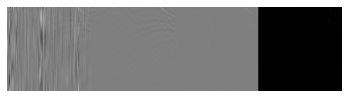

Spatial domain: X - Y - PREDICT


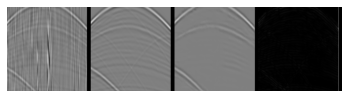

Spatial domain: X - Y - PREDICT


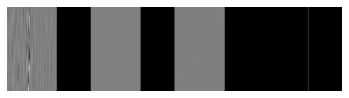

Spatial domain: X - Y - PREDICT


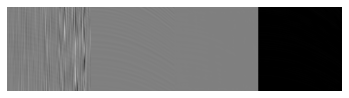

Spatial domain: X - Y - PREDICT


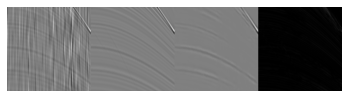

Spatial domain: X - Y - PREDICT


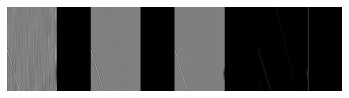

Spatial domain: X - Y - PREDICT


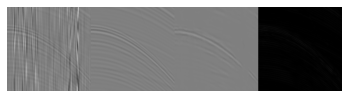

Spatial domain: X - Y - PREDICT


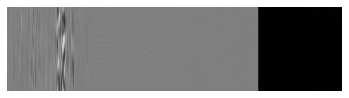

Spatial domain: X - Y - PREDICT


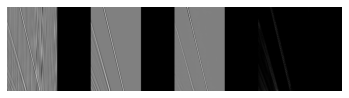

Spatial domain: X - Y - PREDICT


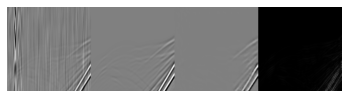

Spatial domain: X - Y - PREDICT


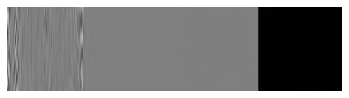

Spatial domain: X - Y - PREDICT


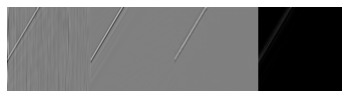

Spatial domain: X - Y - PREDICT


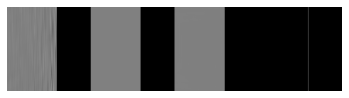

Spatial domain: X - Y - PREDICT


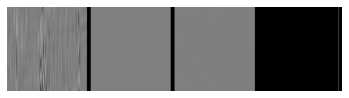

Spatial domain: X - Y - PREDICT


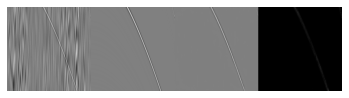

Spatial domain: X - Y - PREDICT


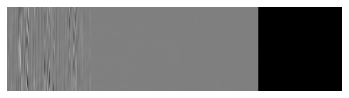

Spatial domain: X - Y - PREDICT


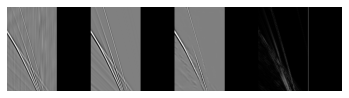

Spatial domain: X - Y - PREDICT


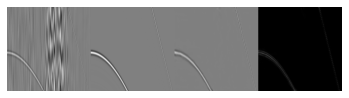

Spatial domain: X - Y - PREDICT


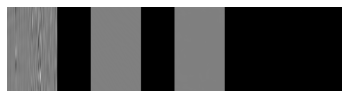

Spatial domain: X - Y - PREDICT


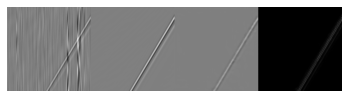

Spatial domain: X - Y - PREDICT


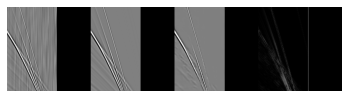

Spatial domain: X - Y - PREDICT


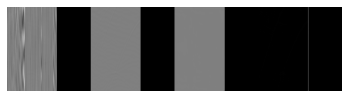

Spatial domain: X - Y - PREDICT


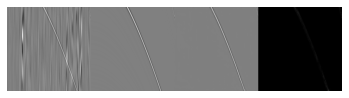

Spatial domain: X - Y - PREDICT


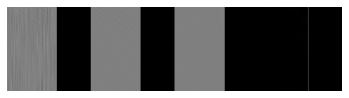

Spatial domain: X - Y - PREDICT


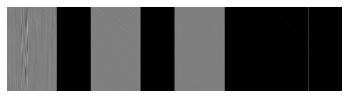

Spatial domain: X - Y - PREDICT


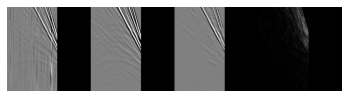

Spatial domain: X - Y - PREDICT


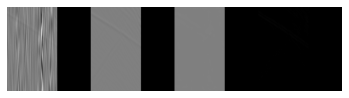

Spatial domain: X - Y - PREDICT


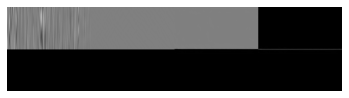

Spatial domain: X - Y - PREDICT


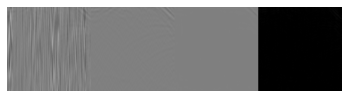

Spatial domain: X - Y - PREDICT


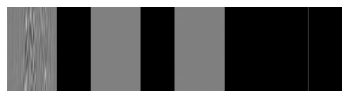

Spatial domain: X - Y - PREDICT


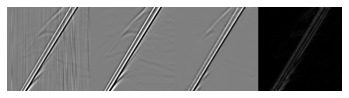

Spatial domain: X - Y - PREDICT


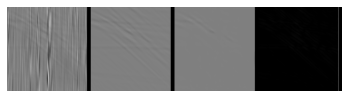

Spatial domain: X - Y - PREDICT


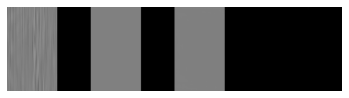

Spatial domain: X - Y - PREDICT


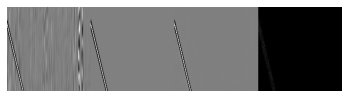

Spatial domain: X - Y - PREDICT


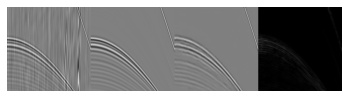

Spatial domain: X - Y - PREDICT


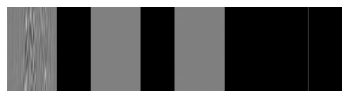

Spatial domain: X - Y - PREDICT


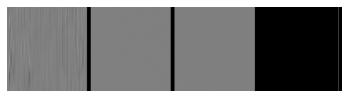

Spatial domain: X - Y - PREDICT


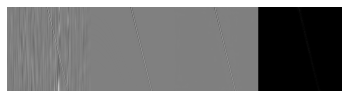

Spatial domain: X - Y - PREDICT


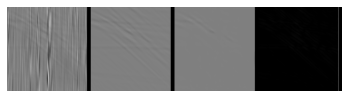

Spatial domain: X - Y - PREDICT


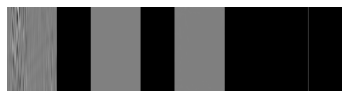

Spatial domain: X - Y - PREDICT


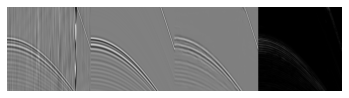

Spatial domain: X - Y - PREDICT


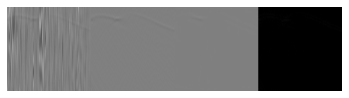

Spatial domain: X - Y - PREDICT


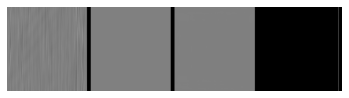

Spatial domain: X - Y - PREDICT


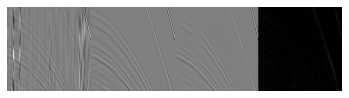

Spatial domain: X - Y - PREDICT


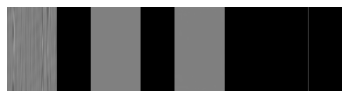

Spatial domain: X - Y - PREDICT


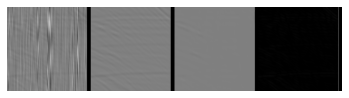

Spatial domain: X - Y - PREDICT


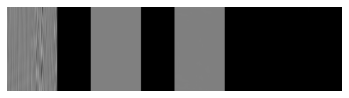

Spatial domain: X - Y - PREDICT


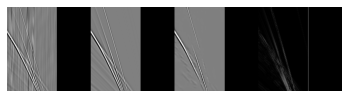

Spatial domain: X - Y - PREDICT


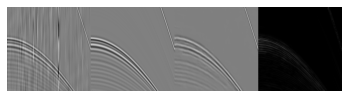

Spatial domain: X - Y - PREDICT


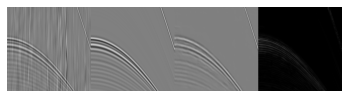

Spatial domain: X - Y - PREDICT


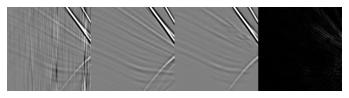

Spatial domain: X - Y - PREDICT


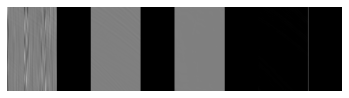

Spatial domain: X - Y - PREDICT


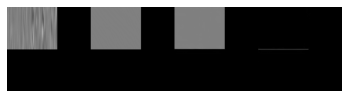

Spatial domain: X - Y - PREDICT


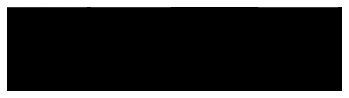

Spatial domain: X - Y - PREDICT


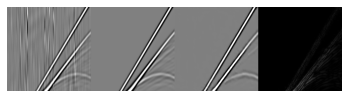

Spatial domain: X - Y - PREDICT


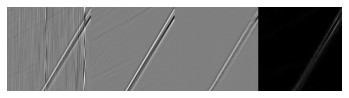

Spatial domain: X - Y - PREDICT


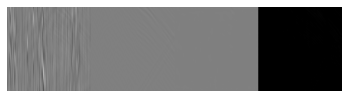

Spatial domain: X - Y - PREDICT


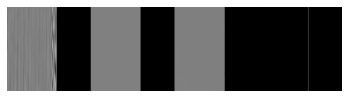

Spatial domain: X - Y - PREDICT


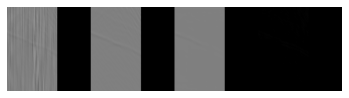

Spatial domain: X - Y - PREDICT


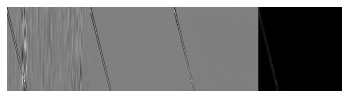

Spatial domain: X - Y - PREDICT


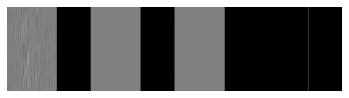

Spatial domain: X - Y - PREDICT


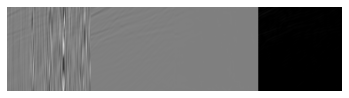

Spatial domain: X - Y - PREDICT


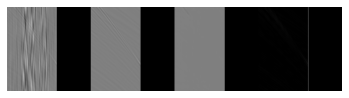

Spatial domain: X - Y - PREDICT


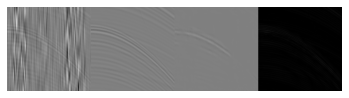

Spatial domain: X - Y - PREDICT


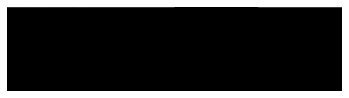

Spatial domain: X - Y - PREDICT


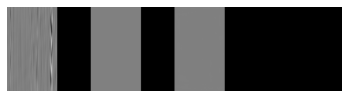

Spatial domain: X - Y - PREDICT


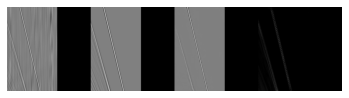

Spatial domain: X - Y - PREDICT


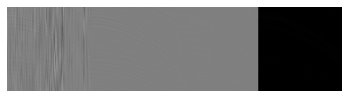

Spatial domain: X - Y - PREDICT


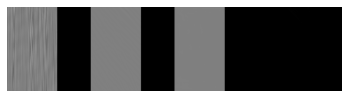

Spatial domain: X - Y - PREDICT


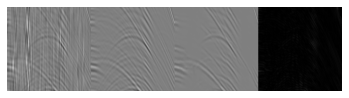

Spatial domain: X - Y - PREDICT


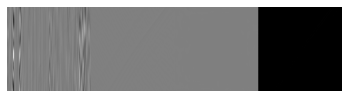

Spatial domain: X - Y - PREDICT


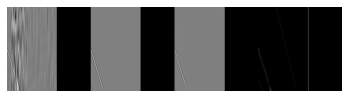

Spatial domain: X - Y - PREDICT


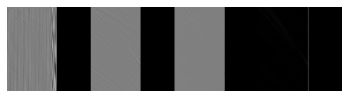

Spatial domain: X - Y - PREDICT


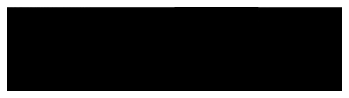

Spatial domain: X - Y - PREDICT


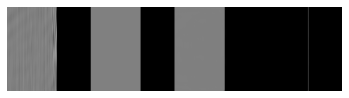

Spatial domain: X - Y - PREDICT


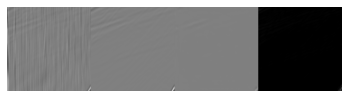

Spatial domain: X - Y - PREDICT


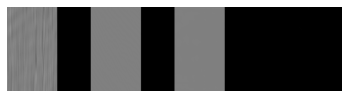

Spatial domain: X - Y - PREDICT


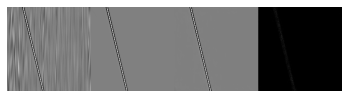

Spatial domain: X - Y - PREDICT


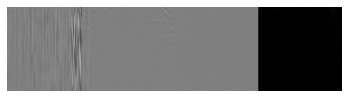

Spatial domain: X - Y - PREDICT


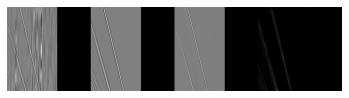

Spatial domain: X - Y - PREDICT


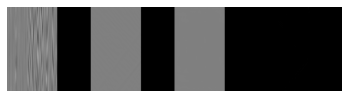

Spatial domain: X - Y - PREDICT


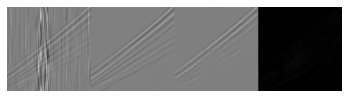

Spatial domain: X - Y - PREDICT


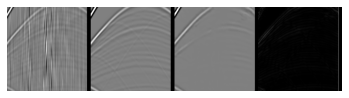

Spatial domain: X - Y - PREDICT


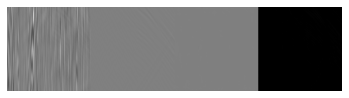

Spatial domain: X - Y - PREDICT


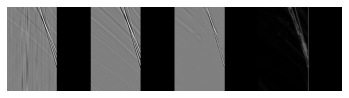

Spatial domain: X - Y - PREDICT


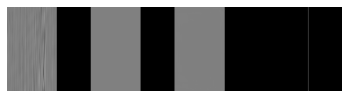

Spatial domain: X - Y - PREDICT


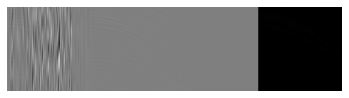

Spatial domain: X - Y - PREDICT


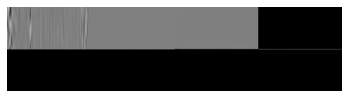

Spatial domain: X - Y - PREDICT


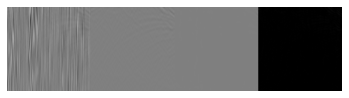

Spatial domain: X - Y - PREDICT


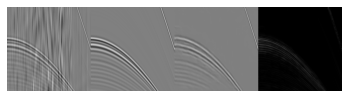

Spatial domain: X - Y - PREDICT


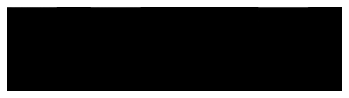

Spatial domain: X - Y - PREDICT


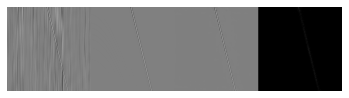

Spatial domain: X - Y - PREDICT


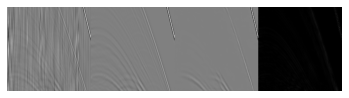

Spatial domain: X - Y - PREDICT


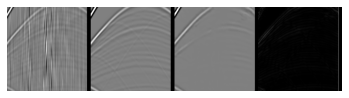

Spatial domain: X - Y - PREDICT


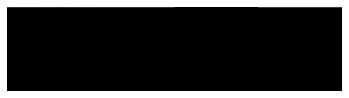

Spatial domain: X - Y - PREDICT


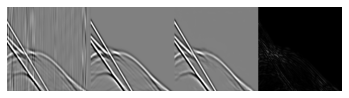

Spatial domain: X - Y - PREDICT


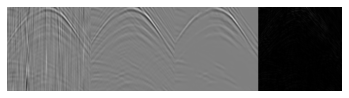

Spatial domain: X - Y - PREDICT


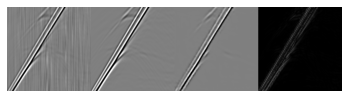

Spatial domain: X - Y - PREDICT


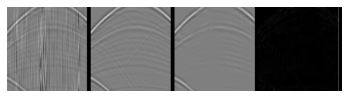

Spatial domain: X - Y - PREDICT


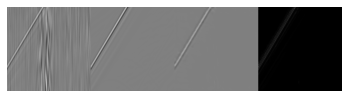

Spatial domain: X - Y - PREDICT


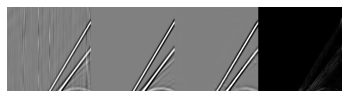

Spatial domain: X - Y - PREDICT


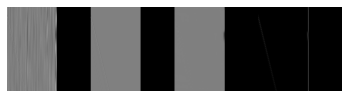

Spatial domain: X - Y - PREDICT


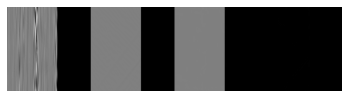

Spatial domain: X - Y - PREDICT


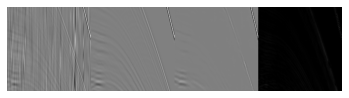

Spatial domain: X - Y - PREDICT


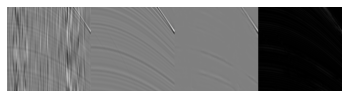

Spatial domain: X - Y - PREDICT


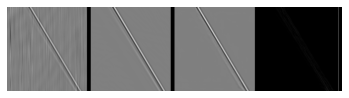

Spatial domain: X - Y - PREDICT


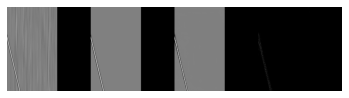

Spatial domain: X - Y - PREDICT


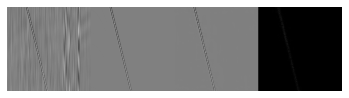

Spatial domain: X - Y - PREDICT


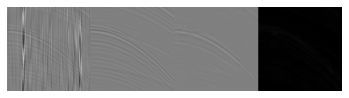

Spatial domain: X - Y - PREDICT


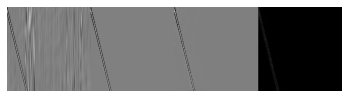

Spatial domain: X - Y - PREDICT


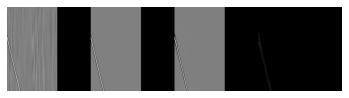

Spatial domain: X - Y - PREDICT


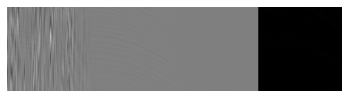

Spatial domain: X - Y - PREDICT


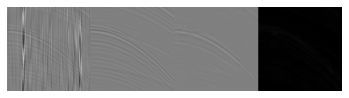

Spatial domain: X - Y - PREDICT


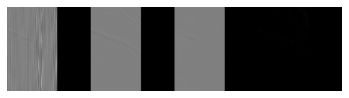

Spatial domain: X - Y - PREDICT


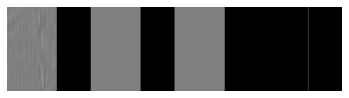

Spatial domain: X - Y - PREDICT


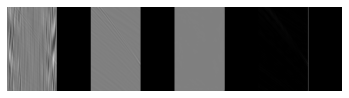

Spatial domain: X - Y - PREDICT


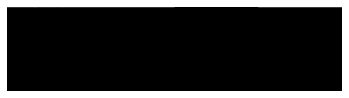

Spatial domain: X - Y - PREDICT


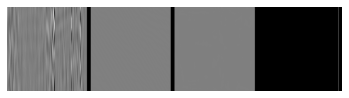

Spatial domain: X - Y - PREDICT


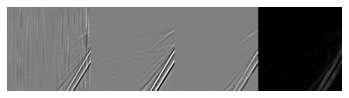

Spatial domain: X - Y - PREDICT


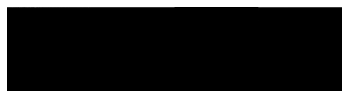

Spatial domain: X - Y - PREDICT


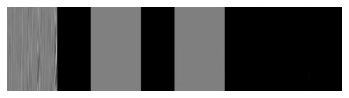

Spatial domain: X - Y - PREDICT


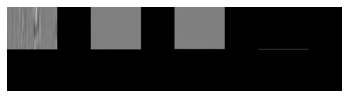

Spatial domain: X - Y - PREDICT


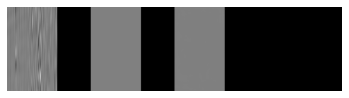

Spatial domain: X - Y - PREDICT


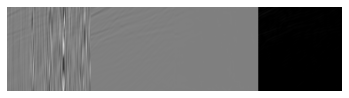

Spatial domain: X - Y - PREDICT


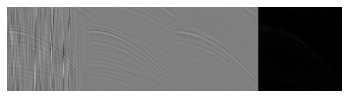

Spatial domain: X - Y - PREDICT


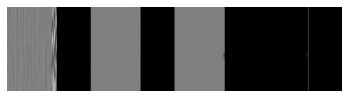

Spatial domain: X - Y - PREDICT


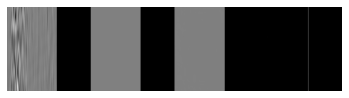

Spatial domain: X - Y - PREDICT


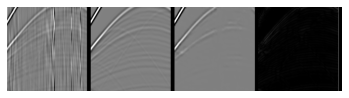

Spatial domain: X - Y - PREDICT


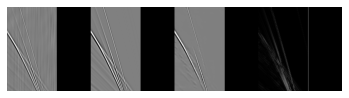

Spatial domain: X - Y - PREDICT


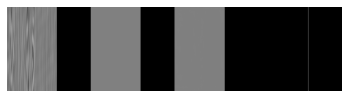

Spatial domain: X - Y - PREDICT


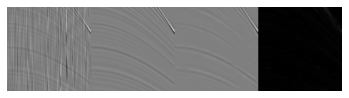

Spatial domain: X - Y - PREDICT


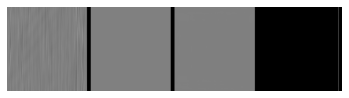

Spatial domain: X - Y - PREDICT


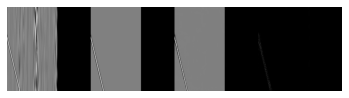

Spatial domain: X - Y - PREDICT


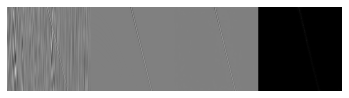

Spatial domain: X - Y - PREDICT


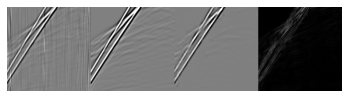

Spatial domain: X - Y - PREDICT


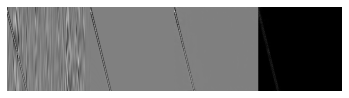

Spatial domain: X - Y - PREDICT


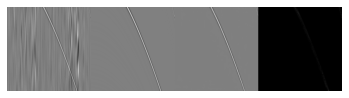

Spatial domain: X - Y - PREDICT


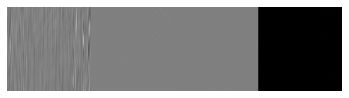

Spatial domain: X - Y - PREDICT


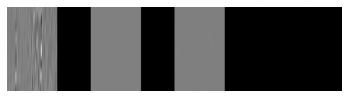

Spatial domain: X - Y - PREDICT


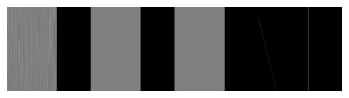

Spatial domain: X - Y - PREDICT


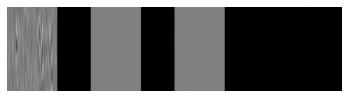

Spatial domain: X - Y - PREDICT


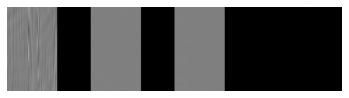

Spatial domain: X - Y - PREDICT


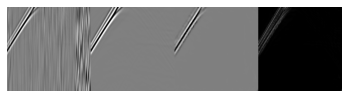

Spatial domain: X - Y - PREDICT


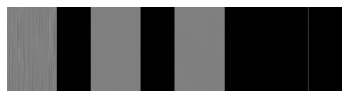

Spatial domain: X - Y - PREDICT


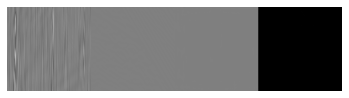

Spatial domain: X - Y - PREDICT


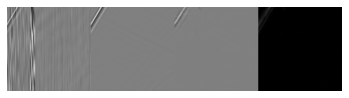

Spatial domain: X - Y - PREDICT


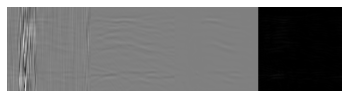

Spatial domain: X - Y - PREDICT


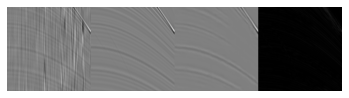

Spatial domain: X - Y - PREDICT


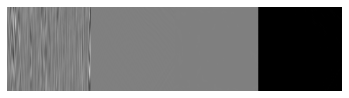

Spatial domain: X - Y - PREDICT


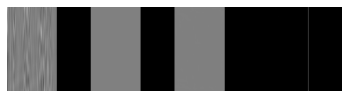

Spatial domain: X - Y - PREDICT


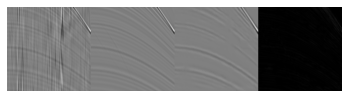

Spatial domain: X - Y - PREDICT


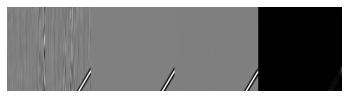

Spatial domain: X - Y - PREDICT


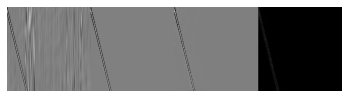

Spatial domain: X - Y - PREDICT


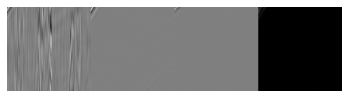

Spatial domain: X - Y - PREDICT


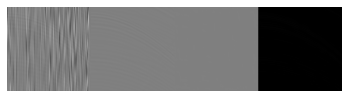

Spatial domain: X - Y - PREDICT


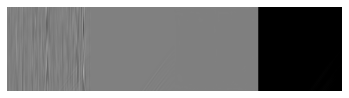

Spatial domain: X - Y - PREDICT


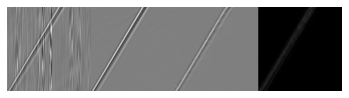

Spatial domain: X - Y - PREDICT


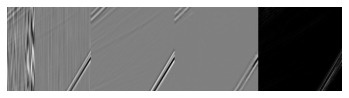

Spatial domain: X - Y - PREDICT


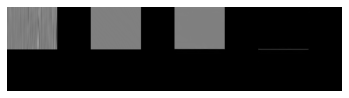

Spatial domain: X - Y - PREDICT


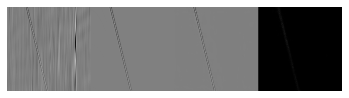

Spatial domain: X - Y - PREDICT


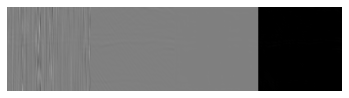

Spatial domain: X - Y - PREDICT


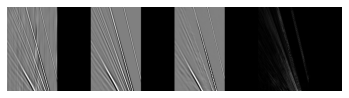

Spatial domain: X - Y - PREDICT


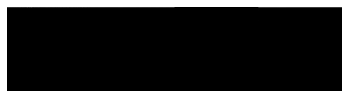

Spatial domain: X - Y - PREDICT


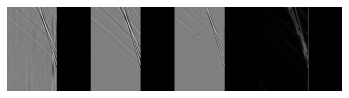

Spatial domain: X - Y - PREDICT


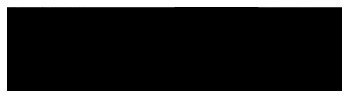

Spatial domain: X - Y - PREDICT


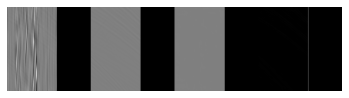

Spatial domain: X - Y - PREDICT


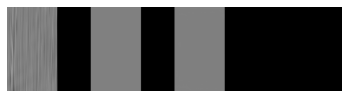

Spatial domain: X - Y - PREDICT


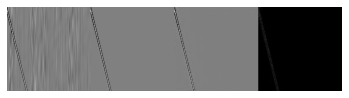

Spatial domain: X - Y - PREDICT


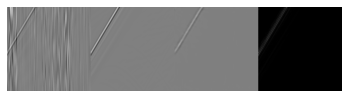

Spatial domain: X - Y - PREDICT


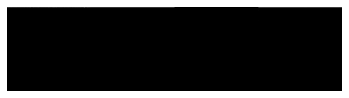

Spatial domain: X - Y - PREDICT


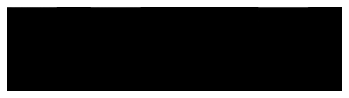

Spatial domain: X - Y - PREDICT


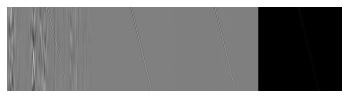

Spatial domain: X - Y - PREDICT


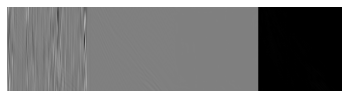

Spatial domain: X - Y - PREDICT


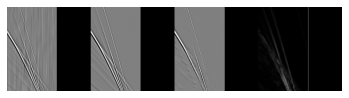

Spatial domain: X - Y - PREDICT


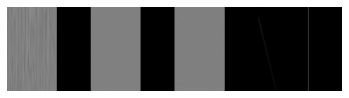

Spatial domain: X - Y - PREDICT


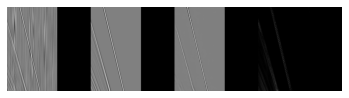

Spatial domain: X - Y - PREDICT


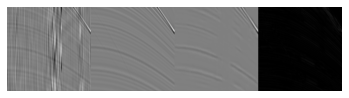

Spatial domain: X - Y - PREDICT


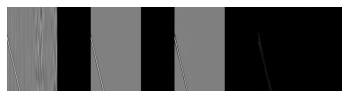

Spatial domain: X - Y - PREDICT


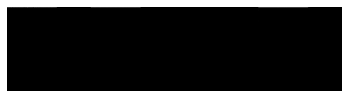

Spatial domain: X - Y - PREDICT


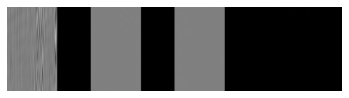

Spatial domain: X - Y - PREDICT


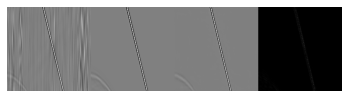

Spatial domain: X - Y - PREDICT


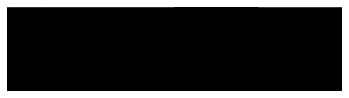

Spatial domain: X - Y - PREDICT


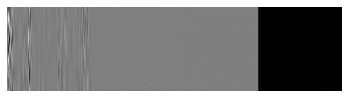

Spatial domain: X - Y - PREDICT


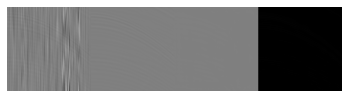

Spatial domain: X - Y - PREDICT


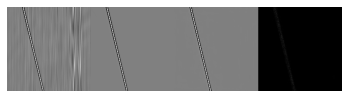

Spatial domain: X - Y - PREDICT


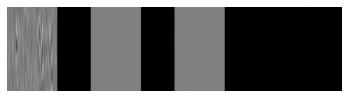

Spatial domain: X - Y - PREDICT


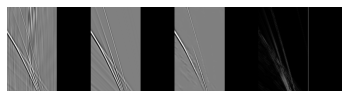

Spatial domain: X - Y - PREDICT


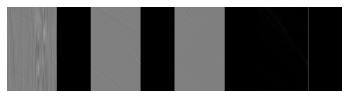

Spatial domain: X - Y - PREDICT


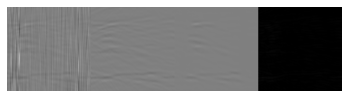

Spatial domain: X - Y - PREDICT


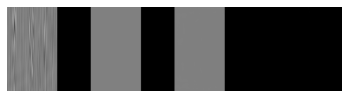

Spatial domain: X - Y - PREDICT


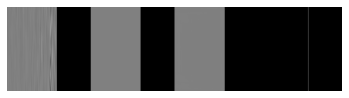

Spatial domain: X - Y - PREDICT


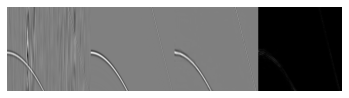

Spatial domain: X - Y - PREDICT


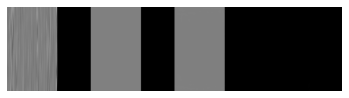

Spatial domain: X - Y - PREDICT


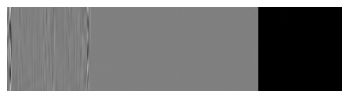

Spatial domain: X - Y - PREDICT


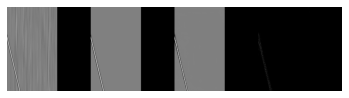

Spatial domain: X - Y - PREDICT


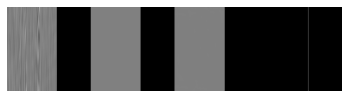

Spatial domain: X - Y - PREDICT


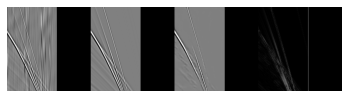

Spatial domain: X - Y - PREDICT


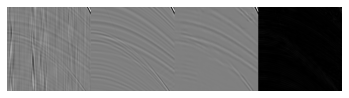

Spatial domain: X - Y - PREDICT


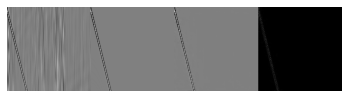

Spatial domain: X - Y - PREDICT


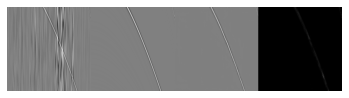

Spatial domain: X - Y - PREDICT


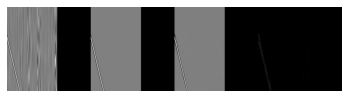

Spatial domain: X - Y - PREDICT


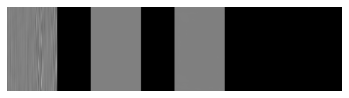

Spatial domain: X - Y - PREDICT


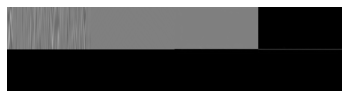

Spatial domain: X - Y - PREDICT


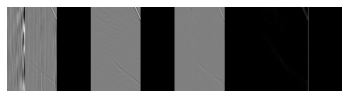

Spatial domain: X - Y - PREDICT


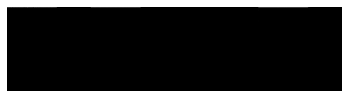

Spatial domain: X - Y - PREDICT


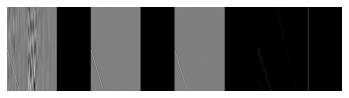

Spatial domain: X - Y - PREDICT


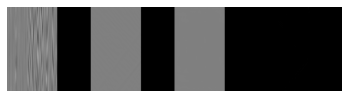

Spatial domain: X - Y - PREDICT


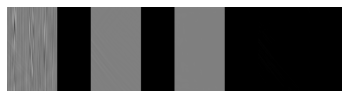

Spatial domain: X - Y - PREDICT


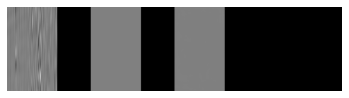

Spatial domain: X - Y - PREDICT


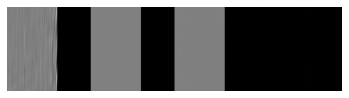

Spatial domain: X - Y - PREDICT


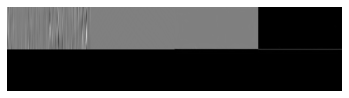

Spatial domain: X - Y - PREDICT


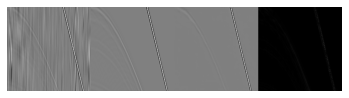

Spatial domain: X - Y - PREDICT


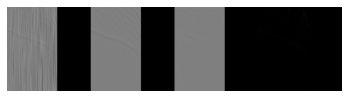

Spatial domain: X - Y - PREDICT


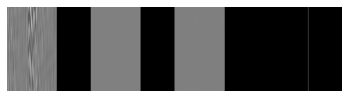

Spatial domain: X - Y - PREDICT


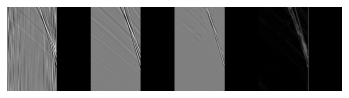

Spatial domain: X - Y - PREDICT


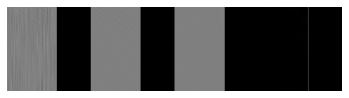

Spatial domain: X - Y - PREDICT


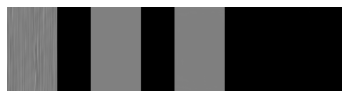

Spatial domain: X - Y - PREDICT


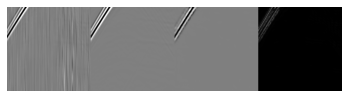

Spatial domain: X - Y - PREDICT


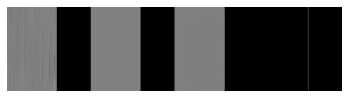

Spatial domain: X - Y - PREDICT


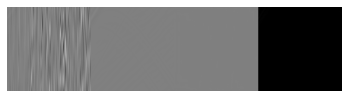

Spatial domain: X - Y - PREDICT


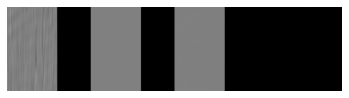

Spatial domain: X - Y - PREDICT


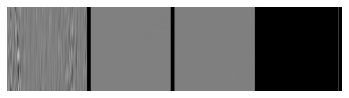

Spatial domain: X - Y - PREDICT


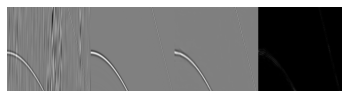

Spatial domain: X - Y - PREDICT


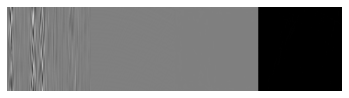

Spatial domain: X - Y - PREDICT


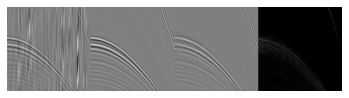

Spatial domain: X - Y - PREDICT


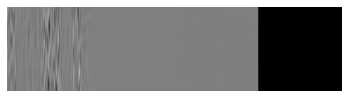

Spatial domain: X - Y - PREDICT


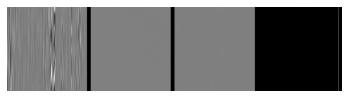

Spatial domain: X - Y - PREDICT


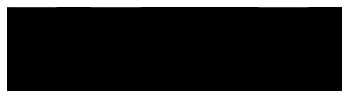

Spatial domain: X - Y - PREDICT


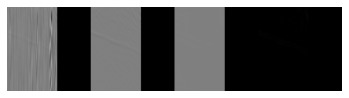

Spatial domain: X - Y - PREDICT


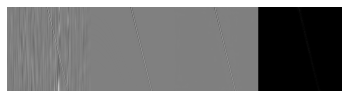

Spatial domain: X - Y - PREDICT


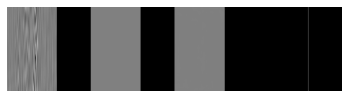

Spatial domain: X - Y - PREDICT


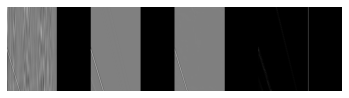

Spatial domain: X - Y - PREDICT


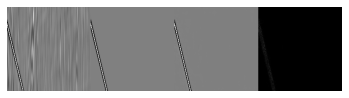

Spatial domain: X - Y - PREDICT


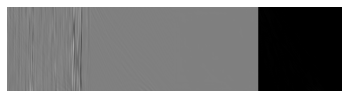

Spatial domain: X - Y - PREDICT


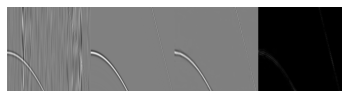

Spatial domain: X - Y - PREDICT


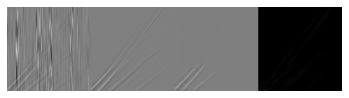

Spatial domain: X - Y - PREDICT


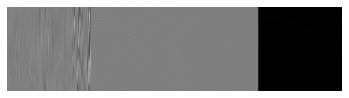

Spatial domain: X - Y - PREDICT


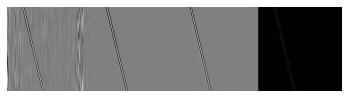

Spatial domain: X - Y - PREDICT


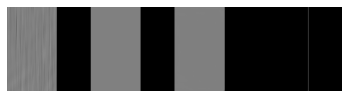

Spatial domain: X - Y - PREDICT


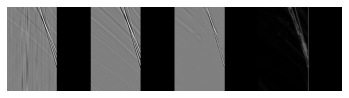

Spatial domain: X - Y - PREDICT


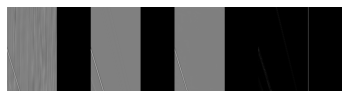

Spatial domain: X - Y - PREDICT


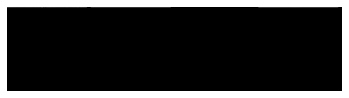

Spatial domain: X - Y - PREDICT


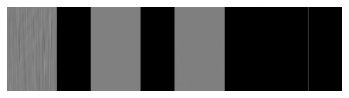

Spatial domain: X - Y - PREDICT


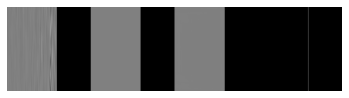

Spatial domain: X - Y - PREDICT


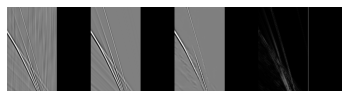

Spatial domain: X - Y - PREDICT


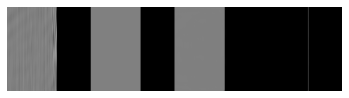

Spatial domain: X - Y - PREDICT


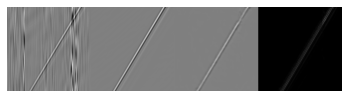

Spatial domain: X - Y - PREDICT


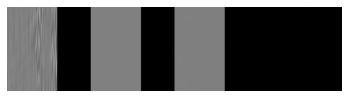

Spatial domain: X - Y - PREDICT


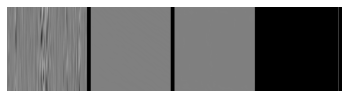

Spatial domain: X - Y - PREDICT


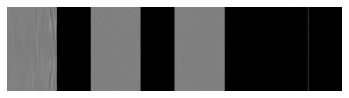

Spatial domain: X - Y - PREDICT


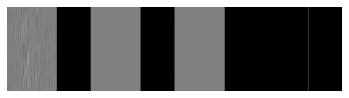

Spatial domain: X - Y - PREDICT


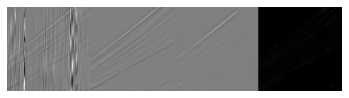

Spatial domain: X - Y - PREDICT


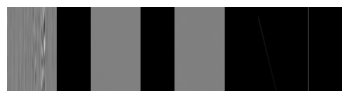

Spatial domain: X - Y - PREDICT


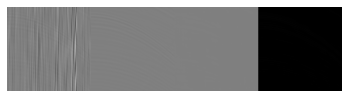

Spatial domain: X - Y - PREDICT


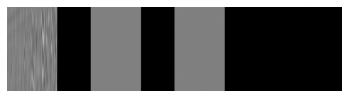

Spatial domain: X - Y - PREDICT


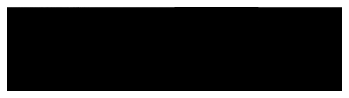

Spatial domain: X - Y - PREDICT


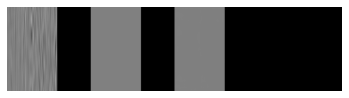

Spatial domain: X - Y - PREDICT


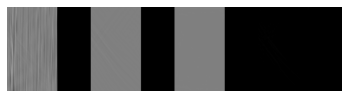

Spatial domain: X - Y - PREDICT


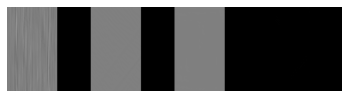

Spatial domain: X - Y - PREDICT


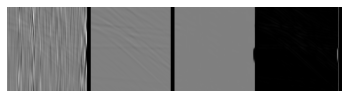

Spatial domain: X - Y - PREDICT


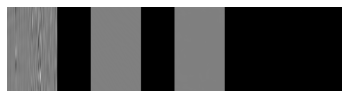

Spatial domain: X - Y - PREDICT


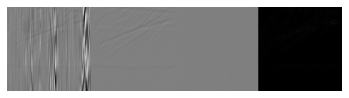

Spatial domain: X - Y - PREDICT


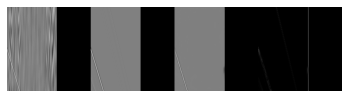

Spatial domain: X - Y - PREDICT


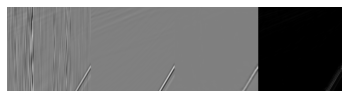

Spatial domain: X - Y - PREDICT


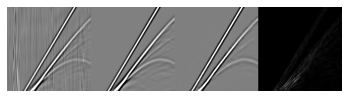

Spatial domain: X - Y - PREDICT


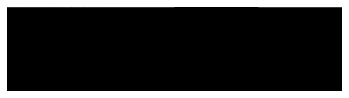

Spatial domain: X - Y - PREDICT


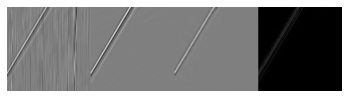

Spatial domain: X - Y - PREDICT


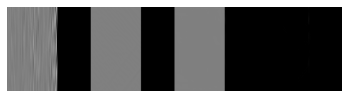

Spatial domain: X - Y - PREDICT


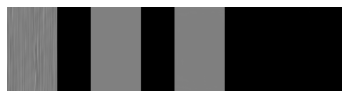

Spatial domain: X - Y - PREDICT


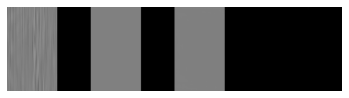

Spatial domain: X - Y - PREDICT


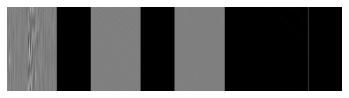

Spatial domain: X - Y - PREDICT


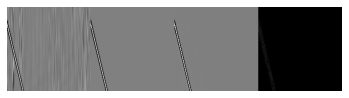

Spatial domain: X - Y - PREDICT


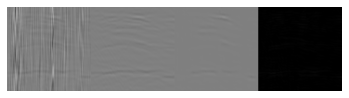

Spatial domain: X - Y - PREDICT


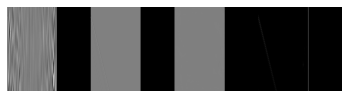

Spatial domain: X - Y - PREDICT


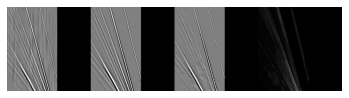

Spatial domain: X - Y - PREDICT


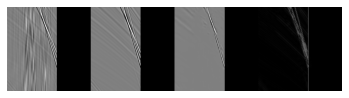

Spatial domain: X - Y - PREDICT


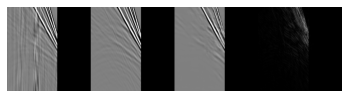

Spatial domain: X - Y - PREDICT


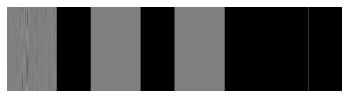

Spatial domain: X - Y - PREDICT


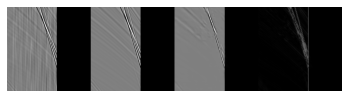

Spatial domain: X - Y - PREDICT


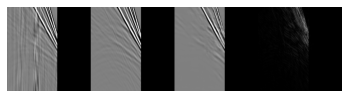

Spatial domain: X - Y - PREDICT


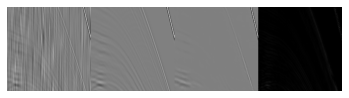

Spatial domain: X - Y - PREDICT


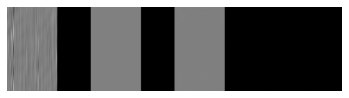

Spatial domain: X - Y - PREDICT


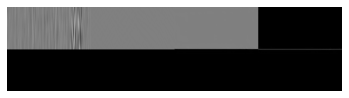

Spatial domain: X - Y - PREDICT


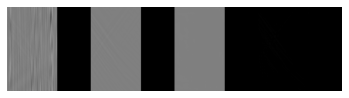

Spatial domain: X - Y - PREDICT


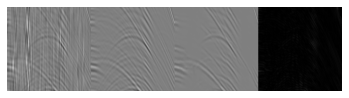

Spatial domain: X - Y - PREDICT


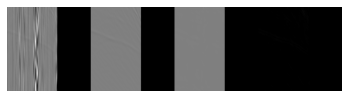

Spatial domain: X - Y - PREDICT


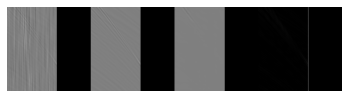

Spatial domain: X - Y - PREDICT


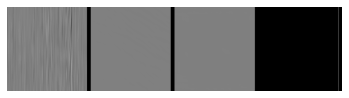

Spatial domain: X - Y - PREDICT


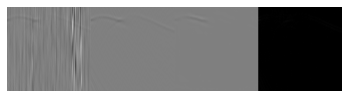

Spatial domain: X - Y - PREDICT


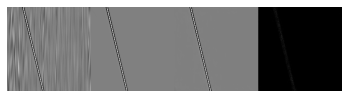

Spatial domain: X - Y - PREDICT


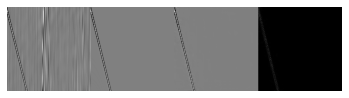

Spatial domain: X - Y - PREDICT


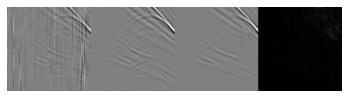

Spatial domain: X - Y - PREDICT


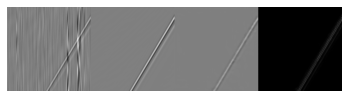

Spatial domain: X - Y - PREDICT


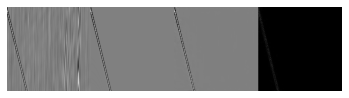

Spatial domain: X - Y - PREDICT


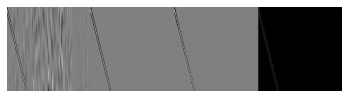

Spatial domain: X - Y - PREDICT


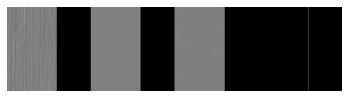

Spatial domain: X - Y - PREDICT


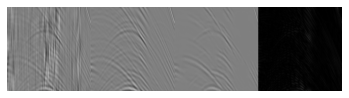

Spatial domain: X - Y - PREDICT


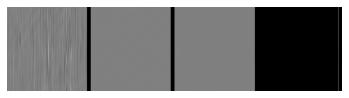

Spatial domain: X - Y - PREDICT


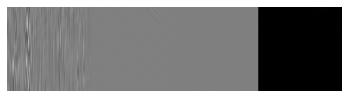

Spatial domain: X - Y - PREDICT


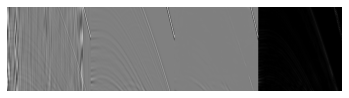

Spatial domain: X - Y - PREDICT


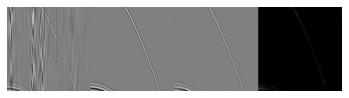

Spatial domain: X - Y - PREDICT


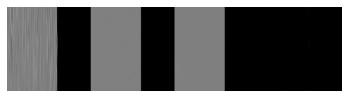

Spatial domain: X - Y - PREDICT


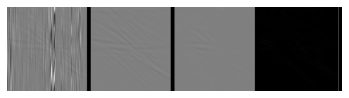

Spatial domain: X - Y - PREDICT


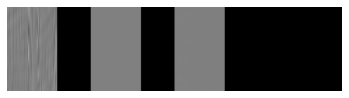

Spatial domain: X - Y - PREDICT


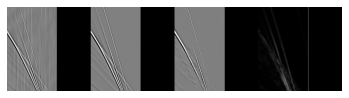

Spatial domain: X - Y - PREDICT


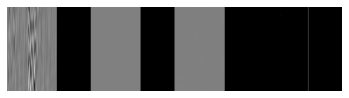

Spatial domain: X - Y - PREDICT


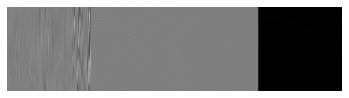

Spatial domain: X - Y - PREDICT


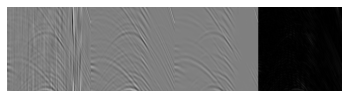

Spatial domain: X - Y - PREDICT


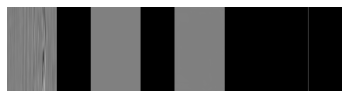

Spatial domain: X - Y - PREDICT


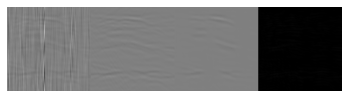

Spatial domain: X - Y - PREDICT


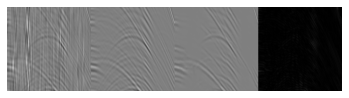

Spatial domain: X - Y - PREDICT


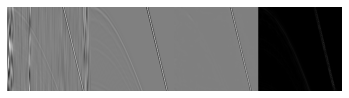

Spatial domain: X - Y - PREDICT


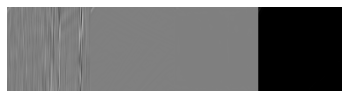

Spatial domain: X - Y - PREDICT


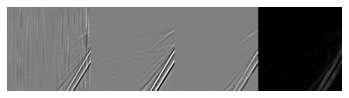

Spatial domain: X - Y - PREDICT


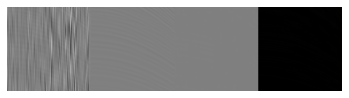

Spatial domain: X - Y - PREDICT


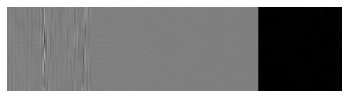

Spatial domain: X - Y - PREDICT


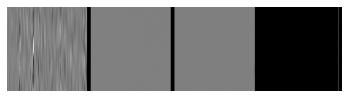

Spatial domain: X - Y - PREDICT


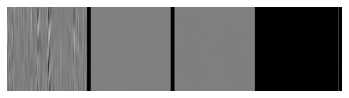

PSNR: 36.89919773304766 
NRMSE 0.13551042819114212


In [12]:
test_x_seismic, test_y_seismic,  = utils.load_dataset_from_file("../extra/test.txt")

#add border with size 24. 200x200 -> 224x224
test_x_seismic = utils.add_margin_zeros(test_x_seismic, size=24)
test_y_seismic = utils.add_margin_zeros(test_y_seismic, size=24)

test_batches = utils.random_mini_batches(test_x_seismic, test_y_seismic, None, None, 8, seed=0)

test_mse = tf.keras.metrics.MeanSquaredError(name='train_mse')
test_custom_metrics = utils.CustomMetric()
for index, batch in enumerate(test_batches):
    (seismic_x, seismic_y, _, _) = batch
    predictions = model(seismic_x)
    test_mse(seismic_y, predictions)

    predictions_seismic = predictions.numpy()

    seismic_x = utils.remove_margin_zeros(seismic_x.copy(), size=24)
    seismic_y = utils.remove_margin_zeros(seismic_y.copy(), size=24)
    predictions_seismic = utils.remove_margin_zeros(predictions_seismic, size=24)

    #feed the metric evaluator
    test_custom_metrics.feed(seismic_y, predictions_seismic)

    #just show the first example of each batch until 5    
    print("Spatial domain: X - Y - PREDICT")
    plt.imshow(np.hstack((seismic_x[0,:,:,0], seismic_y[0,:,:,0], predictions_seismic[0,:,:,0], np.abs(predictions_seismic[0,:,:,0]-seismic_y[0,:,:,0]))) , cmap="gray", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    
#get metric results
psnr, nrmse = test_custom_metrics.result()
test_mse_result = test_mse.result().numpy()
test_custom_metrics.reset_states()
test_mse.reset_states()
    
print("PSNR:", psnr,"\nNRMSE", nrmse)
    
    


### Usage

In [4]:
def draw_trace(seismogram_x, seismogram_y, seismogram_p, seismogram_d, trace_index, max_time=-1):

    if trace_index < 0 or trace_index > seismogram_x.shape[0]:
        return None
    
    array_x  = seismogram_x[:max_time,trace_index]
    array_y  = seismogram_y[:max_time,trace_index]
    array_p  = seismogram_p[:max_time,trace_index]
    array_d  = seismogram_d[:max_time,trace_index]

    t = np.arange(array_x.shape[0])

    fig = plt.figure()
    fig.patch.set_facecolor('white')
    fig.set_size_inches(18.5, 10.5, forward=True)
    
    ax0 = fig.add_subplot(411)
    ax0.plot(t, array_x, label='Input')
    #ax0.set_xlabel("time")
    ax0.legend()
    
    ax1 = fig.add_subplot(412)
    ax1.plot(t, array_p, label='Predict')
    #ax1.set_xlabel("time")
    ax1.legend()
    
    ax2 = fig.add_subplot(413)
    ax2.plot(t, array_y, label='Reference')
    #ax2.set_xlabel("time")
    ax2.legend()
    
    ax2 = fig.add_subplot(414)
    ax2.plot(t, array_d, label='Difference')
    ax2.set_xlabel("time")
    ax2.set_ylim([0,1])
    ax2.legend()

Spatial domain: X - Y - PREDICT - DIFERENCE


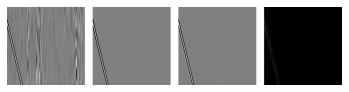

Spatial domain: X - Y - PREDICT - DIFERENCE


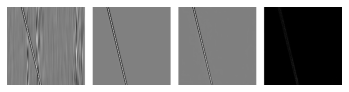

Spatial domain: X - Y - PREDICT - DIFERENCE


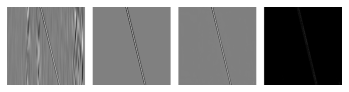

Spatial domain: X - Y - PREDICT - DIFERENCE


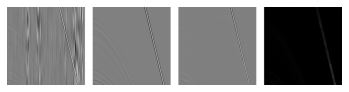

Spatial domain: X - Y - PREDICT - DIFERENCE


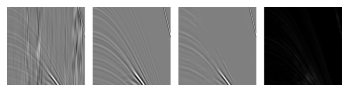

Spatial domain: X - Y - PREDICT - DIFERENCE


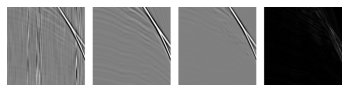

Spatial domain: X - Y - PREDICT - DIFERENCE


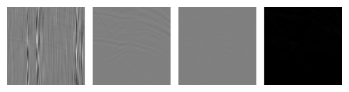

Spatial domain: X - Y - PREDICT - DIFERENCE


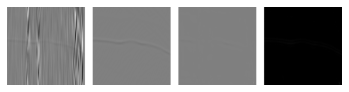

Spatial domain: X - Y - PREDICT - DIFERENCE


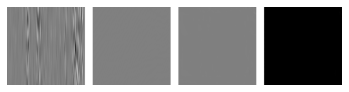

Spatial domain: X - Y - PREDICT - DIFERENCE


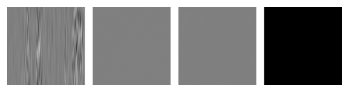

Spatial domain: X - Y - PREDICT - DIFERENCE


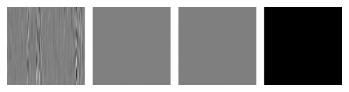

Spatial domain: X - Y - PREDICT - DIFERENCE


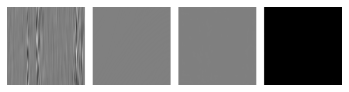

Spatial domain: X - Y - PREDICT - DIFERENCE


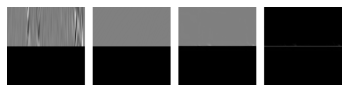

Spatial domain: X - Y - PREDICT - DIFERENCE


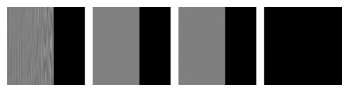

Spatial domain: X - Y - PREDICT - DIFERENCE


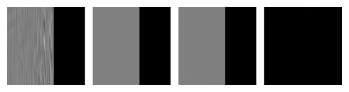

Spatial domain: X - Y - PREDICT - DIFERENCE


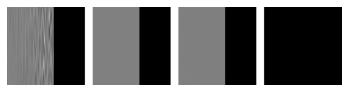

Spatial domain: X - Y - PREDICT - DIFERENCE


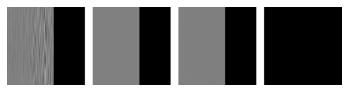

Spatial domain: X - Y - PREDICT - DIFERENCE


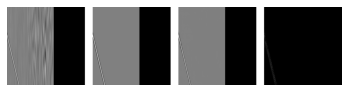

Spatial domain: X - Y - PREDICT - DIFERENCE


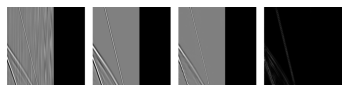

Spatial domain: X - Y - PREDICT - DIFERENCE


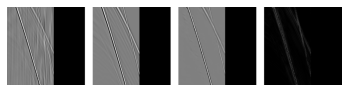

Spatial domain: X - Y - PREDICT - DIFERENCE


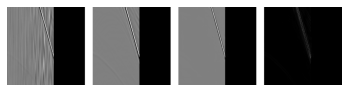

Spatial domain: X - Y - PREDICT - DIFERENCE


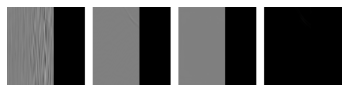

Spatial domain: X - Y - PREDICT - DIFERENCE


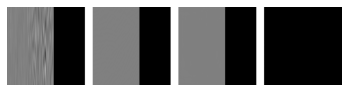

Spatial domain: X - Y - PREDICT - DIFERENCE


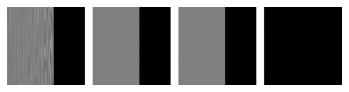

Spatial domain: X - Y - PREDICT - DIFERENCE


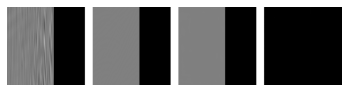

Spatial domain: X - Y - PREDICT - DIFERENCE


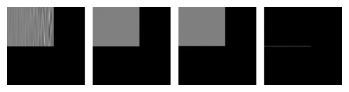

0.658105032351159 0.0


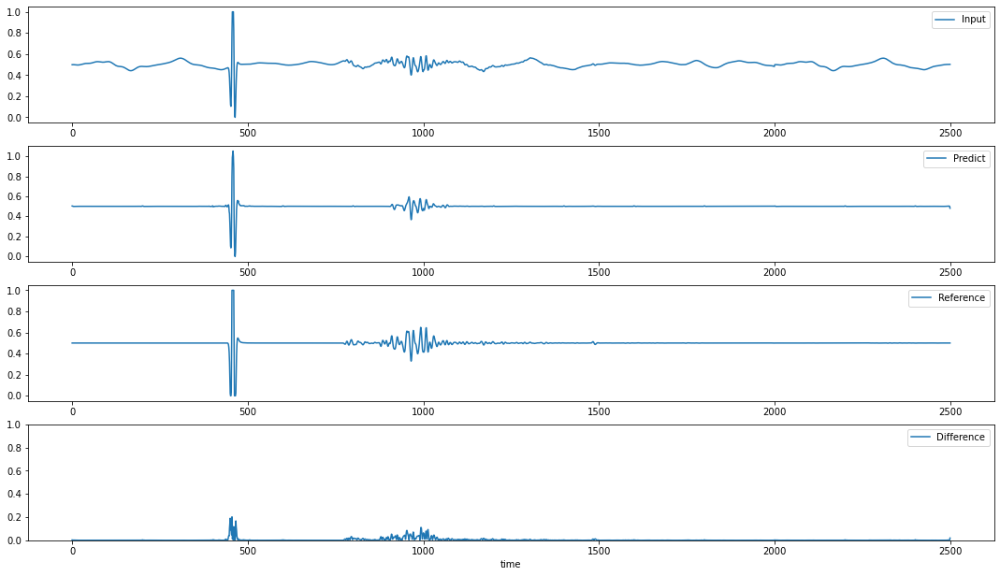

In [16]:
model.load_weights(utils.get_exp_folder_best_valid()+"_set3")

data_seismic_x, data_seismic_y = utils.load_single_seismogram(noisy_path='../../dataset/croped/test/Dataset_Sintetico_03_noisy_A1/428/',
                                 replace_str=['/Dataset_Sintetico_03_noisy_A1/','/Dataset_Sintetico_03/'])

data_seismic_x = utils.add_margin_zeros(data_seismic_x, size=24)
data_seismic_y = utils.add_margin_zeros(data_seismic_y, size=24)


disp_bor = np.ones((200, 20))
    
for i in range(0, data_seismic_x.shape[0]):
    
    seismic_x = data_seismic_x[i:(i+1)]
    seismic_y = data_seismic_y[i:(i+1)]
    
    predictions = model(seismic_x)
    predictions_seismic = predictions.numpy()

    seismic_x = utils.remove_margin_zeros(seismic_x.copy(), size=24)
    seismic_y = utils.remove_margin_zeros(seismic_y.copy(), size=24)
    predictions_seismic = utils.remove_margin_zeros(predictions_seismic, size=24)
    #predictions_seismic = np.clip(predictions_seismic, 0, 1)   1.2401404 -0.25521553
    
    difference = np.abs(predictions_seismic-seismic_y)
    
    utils.compose_final_image("seismic_x", seismic_x[0,:,:,0], 12, i, data_seismic_x.shape[0])
    utils.compose_final_image("seismic_y", seismic_y[0,:,:,0], 12, i, data_seismic_x.shape[0])
    utils.compose_final_image("prediction", predictions_seismic[0,:,:,0], 12, i, data_seismic_x.shape[0])
    utils.compose_final_image("difference", difference[0,:,:,0], 12, i, data_seismic_x.shape[0])
  
    #just show the first example of each batch until 5    
    print("Spatial domain: X - Y - PREDICT - DIFERENCE")
    plt.imshow(np.hstack((seismic_x[0,:,:,0], disp_bor, seismic_y[0,:,:,0], disp_bor, predictions_seismic[0,:,:,0], disp_bor, difference[0,:,:,0] )) , cmap="gray", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    

seismogram_x = utils.export_image_data("seismic_x")
img_x = Image.fromarray(seismogram_x)
img_x.save("output/seismic_x_3.tiff")

seismogram_y = utils.export_image_data("seismic_y")
img_y = Image.fromarray(seismogram_y)
img_y.save("output/seismic_y_3.tiff")

seismogram_p = utils.export_image_data("prediction")
pred = Image.fromarray(seismogram_p)
pred.save("output/prediction_3.tiff")

dif_image = utils.export_image_data("difference")
print(np.amax(dif_image), np.amin(dif_image))
dif_image[0,0] = 1
diff = Image.fromarray(dif_image)
diff.save("output/difference_3.tiff")  


draw_trace(seismogram_x, seismogram_y, seismogram_p, dif_image, 100, max_time=2500)


Spatial domain: X - Y - PREDICT - DIFERENCE


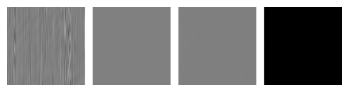

Spatial domain: X - Y - PREDICT - DIFERENCE


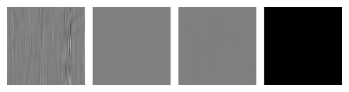

Spatial domain: X - Y - PREDICT - DIFERENCE


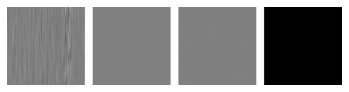

Spatial domain: X - Y - PREDICT - DIFERENCE


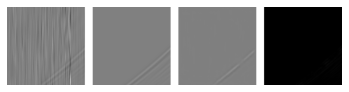

Spatial domain: X - Y - PREDICT - DIFERENCE


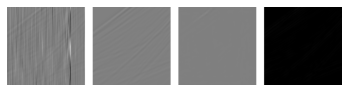

Spatial domain: X - Y - PREDICT - DIFERENCE


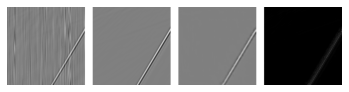

Spatial domain: X - Y - PREDICT - DIFERENCE


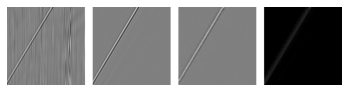

Spatial domain: X - Y - PREDICT - DIFERENCE


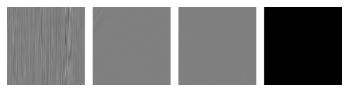

Spatial domain: X - Y - PREDICT - DIFERENCE


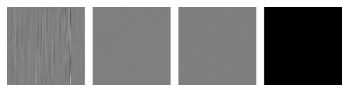

Spatial domain: X - Y - PREDICT - DIFERENCE


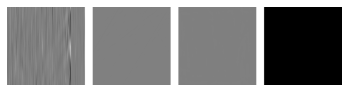

Spatial domain: X - Y - PREDICT - DIFERENCE


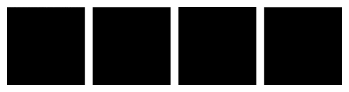

Spatial domain: X - Y - PREDICT - DIFERENCE


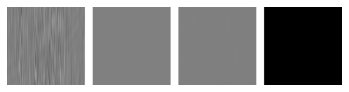

Spatial domain: X - Y - PREDICT - DIFERENCE


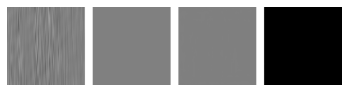

Spatial domain: X - Y - PREDICT - DIFERENCE


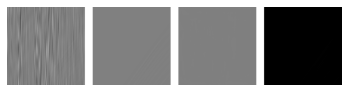

Spatial domain: X - Y - PREDICT - DIFERENCE


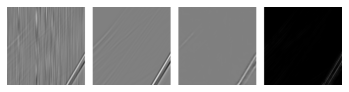

Spatial domain: X - Y - PREDICT - DIFERENCE


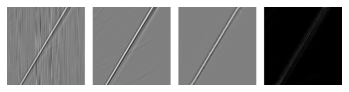

Spatial domain: X - Y - PREDICT - DIFERENCE


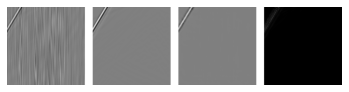

Spatial domain: X - Y - PREDICT - DIFERENCE


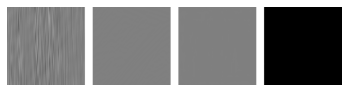

Spatial domain: X - Y - PREDICT - DIFERENCE


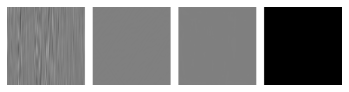

Spatial domain: X - Y - PREDICT - DIFERENCE


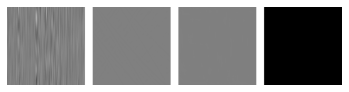

Spatial domain: X - Y - PREDICT - DIFERENCE


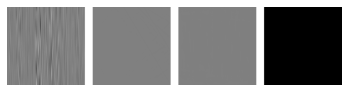

Spatial domain: X - Y - PREDICT - DIFERENCE


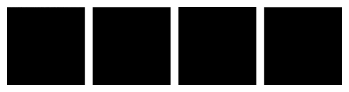

Spatial domain: X - Y - PREDICT - DIFERENCE


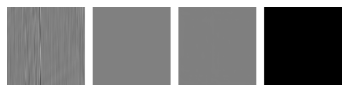

Spatial domain: X - Y - PREDICT - DIFERENCE


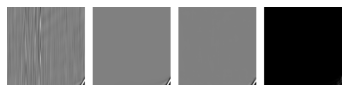

Spatial domain: X - Y - PREDICT - DIFERENCE


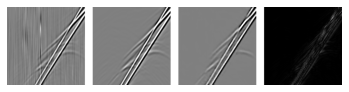

Spatial domain: X - Y - PREDICT - DIFERENCE


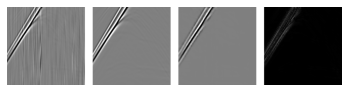

Spatial domain: X - Y - PREDICT - DIFERENCE


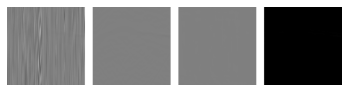

Spatial domain: X - Y - PREDICT - DIFERENCE


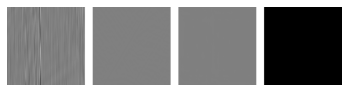

Spatial domain: X - Y - PREDICT - DIFERENCE


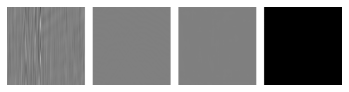

Spatial domain: X - Y - PREDICT - DIFERENCE


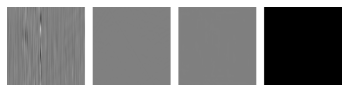

Spatial domain: X - Y - PREDICT - DIFERENCE


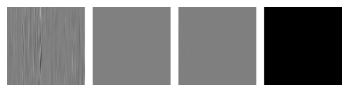

Spatial domain: X - Y - PREDICT - DIFERENCE


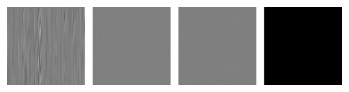

Spatial domain: X - Y - PREDICT - DIFERENCE


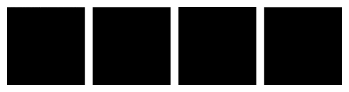

Spatial domain: X - Y - PREDICT - DIFERENCE


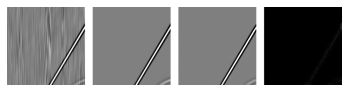

Spatial domain: X - Y - PREDICT - DIFERENCE


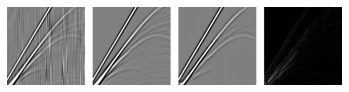

Spatial domain: X - Y - PREDICT - DIFERENCE


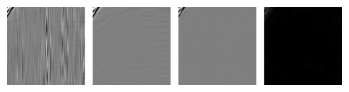

Spatial domain: X - Y - PREDICT - DIFERENCE


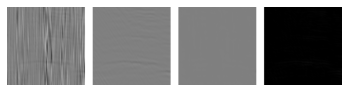

Spatial domain: X - Y - PREDICT - DIFERENCE


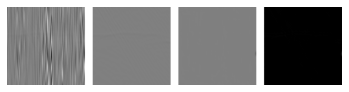

Spatial domain: X - Y - PREDICT - DIFERENCE


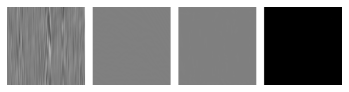

Spatial domain: X - Y - PREDICT - DIFERENCE


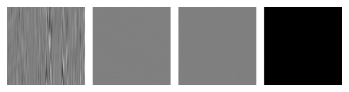

Spatial domain: X - Y - PREDICT - DIFERENCE


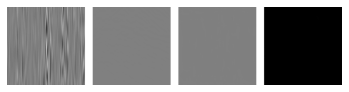

Spatial domain: X - Y - PREDICT - DIFERENCE


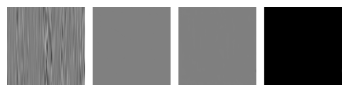

Spatial domain: X - Y - PREDICT - DIFERENCE


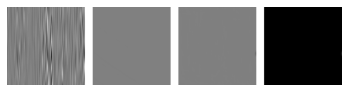

Spatial domain: X - Y - PREDICT - DIFERENCE


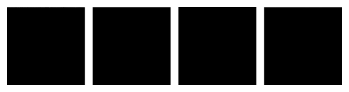

Spatial domain: X - Y - PREDICT - DIFERENCE


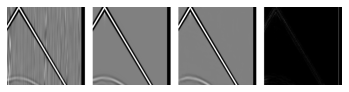

Spatial domain: X - Y - PREDICT - DIFERENCE


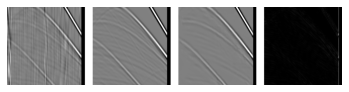

Spatial domain: X - Y - PREDICT - DIFERENCE


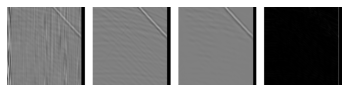

Spatial domain: X - Y - PREDICT - DIFERENCE


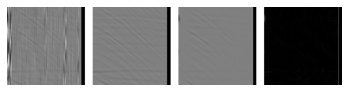

Spatial domain: X - Y - PREDICT - DIFERENCE


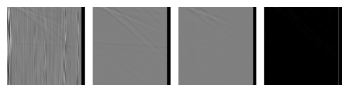

Spatial domain: X - Y - PREDICT - DIFERENCE


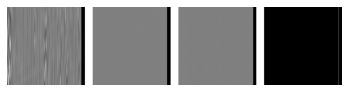

Spatial domain: X - Y - PREDICT - DIFERENCE


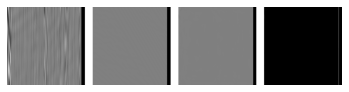

Spatial domain: X - Y - PREDICT - DIFERENCE


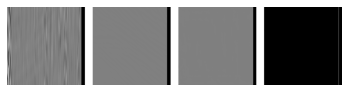

Spatial domain: X - Y - PREDICT - DIFERENCE


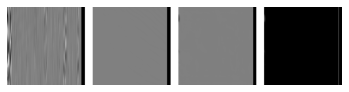

Spatial domain: X - Y - PREDICT - DIFERENCE


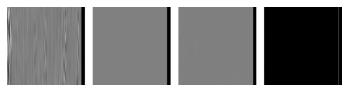

Spatial domain: X - Y - PREDICT - DIFERENCE


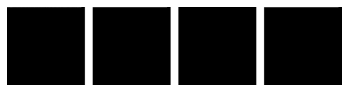

0.8756680488586426 0.0


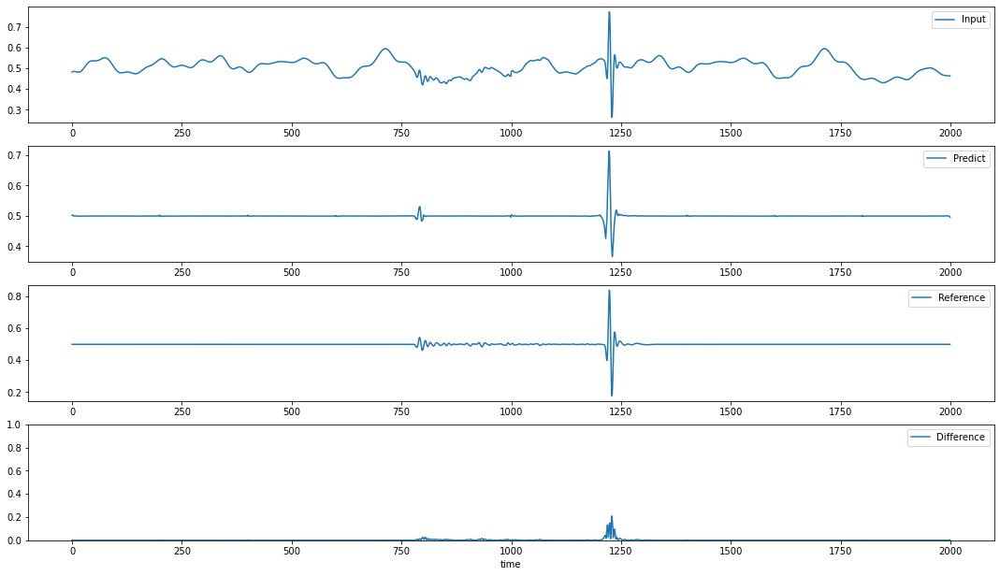

In [17]:
model.load_weights(utils.get_exp_folder_best_valid()+"_set2")

data_seismic_x, data_seismic_y = utils.load_single_seismogram(noisy_path='../../dataset/croped/test/Dataset_Sintetico_02_noisy_A1/78/',
                                 replace_str=['/Dataset_Sintetico_02_noisy_A1/','/Dataset_Sintetico_02/'])

data_seismic_x = utils.add_margin_zeros(data_seismic_x, size=24)
data_seismic_y = utils.add_margin_zeros(data_seismic_y, size=24)


disp_bor = np.ones((200, 20))
    
for i in range(0, data_seismic_x.shape[0]):
    
    seismic_x = data_seismic_x[i:(i+1)]
    seismic_y = data_seismic_y[i:(i+1)]
    
    predictions = model(seismic_x)
    predictions_seismic = predictions.numpy()

    seismic_x = utils.remove_margin_zeros(seismic_x.copy(), size=24)
    seismic_y = utils.remove_margin_zeros(seismic_y.copy(), size=24)
    predictions_seismic = utils.remove_margin_zeros(predictions_seismic, size=24)
    #predictions_seismic = np.clip(predictions_seismic, 0, 1)   1.2401404 -0.25521553
    
    difference = np.abs(predictions_seismic-seismic_y)
    
    utils.compose_final_image("seismic_x", seismic_x[0,:,:,0], 10, i, data_seismic_x.shape[0])
    utils.compose_final_image("seismic_y", seismic_y[0,:,:,0], 10, i, data_seismic_x.shape[0])
    utils.compose_final_image("prediction", predictions_seismic[0,:,:,0], 10, i, data_seismic_x.shape[0])
    utils.compose_final_image("difference", difference[0,:,:,0], 10, i, data_seismic_x.shape[0])
  
    #just show the first example of each batch until 5    
    print("Spatial domain: X - Y - PREDICT - DIFERENCE")
    plt.imshow(np.hstack((seismic_x[0,:,:,0], disp_bor, seismic_y[0,:,:,0], disp_bor, predictions_seismic[0,:,:,0], disp_bor, difference[0,:,:,0] )) , cmap="gray", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    

seismogram_x = utils.export_image_data("seismic_x")
img_x = Image.fromarray(seismogram_x)
img_x.save("output/seismic_x_2.tiff")

seismogram_y = utils.export_image_data("seismic_y")
img_y = Image.fromarray(seismogram_y)
img_y.save("output/seismic_y_2.tiff")

seismogram_p = utils.export_image_data("prediction")
pred = Image.fromarray(seismogram_p)
pred.save("output/prediction_2.tiff")

dif_image = utils.export_image_data("difference")
print(np.amax(dif_image), np.amin(dif_image))
dif_image[0,0] = 1
diff = Image.fromarray(dif_image)
diff.save("output/difference_2.tiff")  


draw_trace(seismogram_x, seismogram_y, seismogram_p, dif_image, 100, max_time=2000)


Spatial domain: X - Y - PREDICT - DIFERENCE


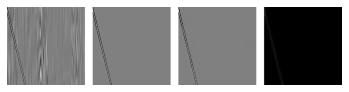

Spatial domain: X - Y - PREDICT - DIFERENCE


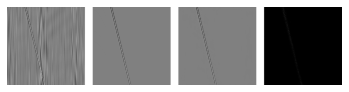

Spatial domain: X - Y - PREDICT - DIFERENCE


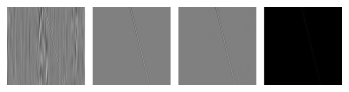

Spatial domain: X - Y - PREDICT - DIFERENCE


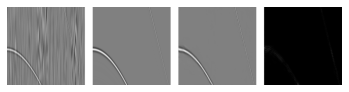

Spatial domain: X - Y - PREDICT - DIFERENCE


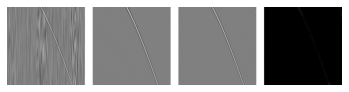

Spatial domain: X - Y - PREDICT - DIFERENCE


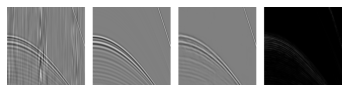

Spatial domain: X - Y - PREDICT - DIFERENCE


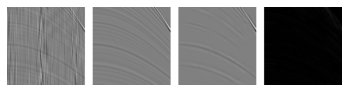

Spatial domain: X - Y - PREDICT - DIFERENCE


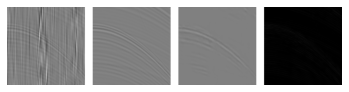

Spatial domain: X - Y - PREDICT - DIFERENCE


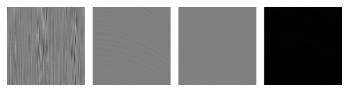

Spatial domain: X - Y - PREDICT - DIFERENCE


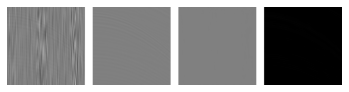

Spatial domain: X - Y - PREDICT - DIFERENCE


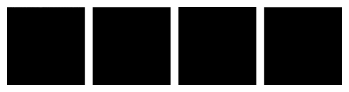

Spatial domain: X - Y - PREDICT - DIFERENCE


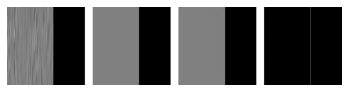

Spatial domain: X - Y - PREDICT - DIFERENCE


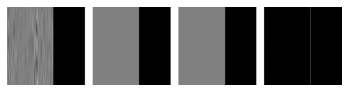

Spatial domain: X - Y - PREDICT - DIFERENCE


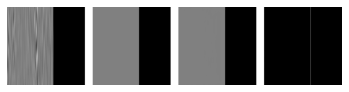

Spatial domain: X - Y - PREDICT - DIFERENCE


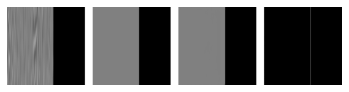

Spatial domain: X - Y - PREDICT - DIFERENCE


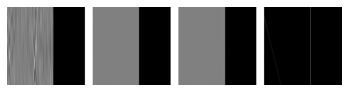

Spatial domain: X - Y - PREDICT - DIFERENCE


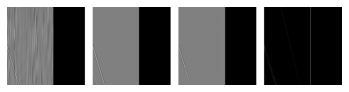

Spatial domain: X - Y - PREDICT - DIFERENCE


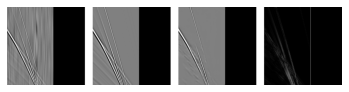

Spatial domain: X - Y - PREDICT - DIFERENCE


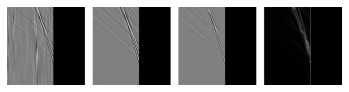

Spatial domain: X - Y - PREDICT - DIFERENCE


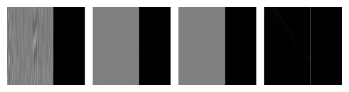

Spatial domain: X - Y - PREDICT - DIFERENCE


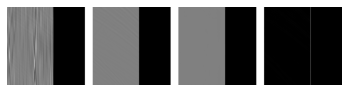

Spatial domain: X - Y - PREDICT - DIFERENCE


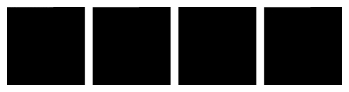

0.7382614612579346 0.0


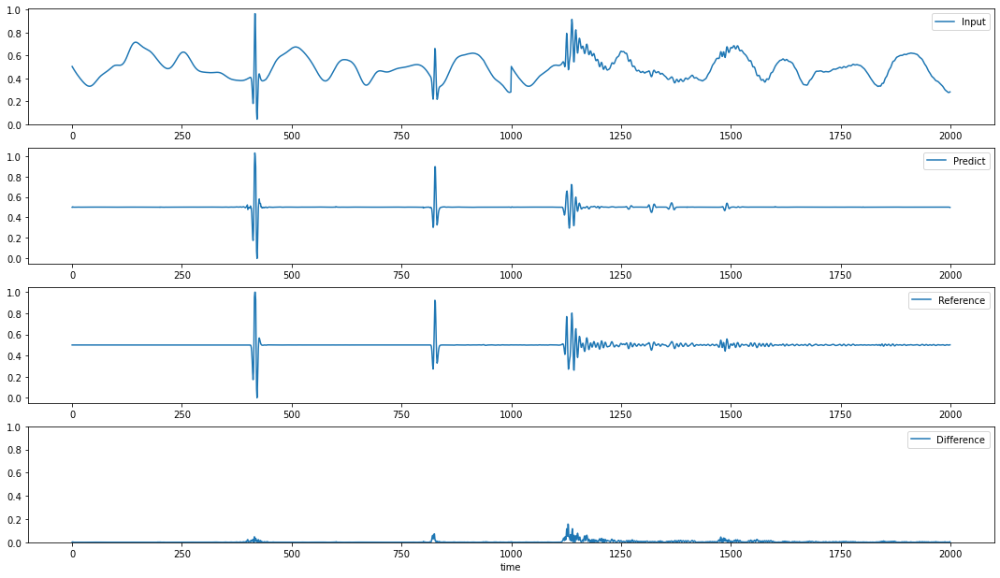

In [18]:
model.load_weights(utils.get_exp_folder_best_valid()+"_set1")

data_seismic_x, data_seismic_y = utils.load_single_seismogram(noisy_path='../../dataset/croped/test/Dataset_Sintetico_05_noisy_A1/596/',
                                 replace_str=['/Dataset_Sintetico_05_noisy_A1/','/Dataset_Sintetico_05/'])

data_seismic_x = utils.add_margin_zeros(data_seismic_x, size=24)
data_seismic_y = utils.add_margin_zeros(data_seismic_y, size=24)


disp_bor = np.ones((200, 20))
    
for i in range(0, data_seismic_x.shape[0]):
    
    seismic_x = data_seismic_x[i:(i+1)]
    seismic_y = data_seismic_y[i:(i+1)]
    
    predictions = model(seismic_x)
    predictions_seismic = predictions.numpy()

    seismic_x = utils.remove_margin_zeros(seismic_x.copy(), size=24)
    seismic_y = utils.remove_margin_zeros(seismic_y.copy(), size=24)
    predictions_seismic = utils.remove_margin_zeros(predictions_seismic, size=24)
    #predictions_seismic = np.clip(predictions_seismic, 0, 1)   1.2401404 -0.25521553
    
    difference = np.abs(predictions_seismic-seismic_y)
    
    utils.compose_final_image("seismic_x", seismic_x[0,:,:,0], 10, i, data_seismic_x.shape[0])
    utils.compose_final_image("seismic_y", seismic_y[0,:,:,0], 10, i, data_seismic_x.shape[0])
    utils.compose_final_image("prediction", predictions_seismic[0,:,:,0], 10, i, data_seismic_x.shape[0])
    utils.compose_final_image("difference", difference[0,:,:,0], 10, i, data_seismic_x.shape[0])
  
    #just show the first example of each batch until 5    
    print("Spatial domain: X - Y - PREDICT - DIFERENCE")
    plt.imshow(np.hstack((seismic_x[0,:,:,0], disp_bor, seismic_y[0,:,:,0], disp_bor, predictions_seismic[0,:,:,0], disp_bor, difference[0,:,:,0] )) , cmap="gray", vmin=0, vmax=1)
    plt.axis('off')
    plt.pause(0.1)
    
seismogram_x = utils.export_image_data("seismic_x")
img_x = Image.fromarray(seismogram_x)
img_x.save("output/seismic_x_1.tiff")

seismogram_y = utils.export_image_data("seismic_y")
img_y = Image.fromarray(seismogram_y)
img_y.save("output/seismic_y_1.tiff")

seismogram_p = utils.export_image_data("prediction")
pred = Image.fromarray(seismogram_p)
pred.save("output/prediction_1.tiff")

dif_image = utils.export_image_data("difference")
print(np.amax(dif_image), np.amin(dif_image))
dif_image[0,0] = 1
diff = Image.fromarray(dif_image)
diff.save("output/difference_1.tiff") 


draw_trace(seismogram_x, seismogram_y, seismogram_p, dif_image, 100, max_time=2000)

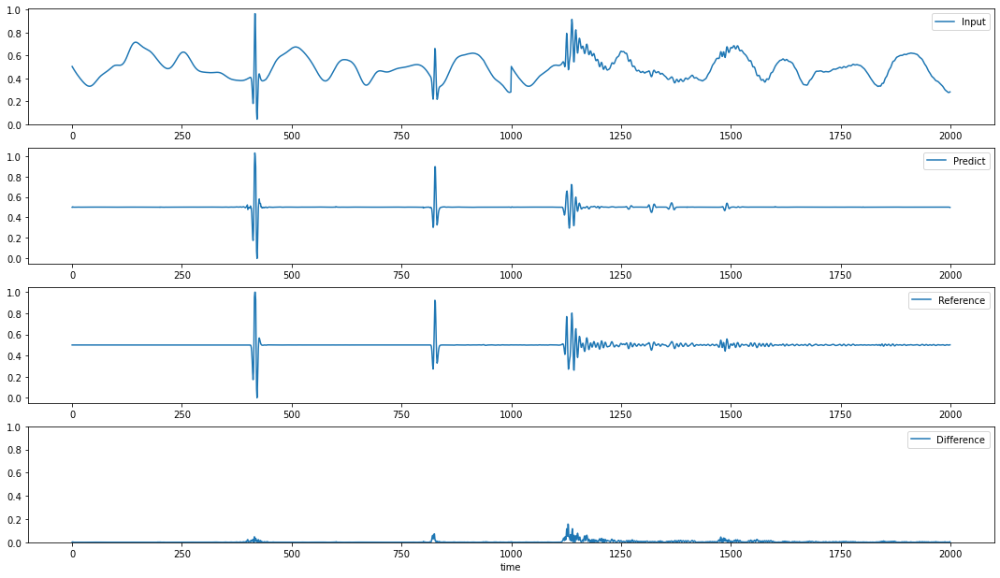